In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from skimage.io import imread
import tensorflow as tf
import matplotlib.pyplot as plt
import time
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import FrEIA.framework as Ff
import FrEIA.modules as Fm
import torchvision
from torchsummary import summary
%matplotlib inline

In [2]:
class Net(nn.Module):

    def __init__(self):
        super(Net, self).__init__()
        # 1 input image channel, 3 output channels, 2x2 square convolution
        # kernel
        self.conv1 = nn.Conv2d(1, 3, 2)
        self.conv2 = nn.Conv2d(3, 2, 2)
        # an affine operation: y = Wx + b
        self.fc1 = nn.Linear(2 * 48 * 48, 120)  # 48*48 from image dimension 
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 1)

    def forward(self, x):
        # Max pooling over a (2, 2) window
        x = F.max_pool2d(F.relu(self.conv1(x)), (2, 2))
        # If the size is a square, you can specify with a single number
        x = F.max_pool2d(F.relu(self.conv2(x)), 2)
        x = torch.flatten(x, 1) # flatten all dimensions except the batch dimension
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x


net = Net()
print(net)
summary(net)

Net(
  (conv1): Conv2d(1, 3, kernel_size=(2, 2), stride=(1, 1))
  (conv2): Conv2d(3, 2, kernel_size=(2, 2), stride=(1, 1))
  (fc1): Linear(in_features=4608, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=1, bias=True)
)
Layer (type:depth-idx)                   Param #
├─Conv2d: 1-1                            15
├─Conv2d: 1-2                            26
├─Linear: 1-3                            553,080
├─Linear: 1-4                            10,164
├─Linear: 1-5                            85
Total params: 563,370
Trainable params: 563,370
Non-trainable params: 0


Layer (type:depth-idx)                   Param #
├─Conv2d: 1-1                            15
├─Conv2d: 1-2                            26
├─Linear: 1-3                            553,080
├─Linear: 1-4                            10,164
├─Linear: 1-5                            85
Total params: 563,370
Trainable params: 563,370
Non-trainable params: 0

In [3]:
param_train = pd.read_table("C:\\Users\\hahoa\\Downloads\\VSL\\ParameterValuesTrain - Copy.txt", header=None).iloc[:, :3].copy()
# param_test = pd.read_table("C:\\Users\\hahoa\\Downloads\\VSL\\ParameterValuesTest - Copy.txt", header=None).iloc[:, :3].copy()

In [4]:
train_polx = pd.read_table("C:\\Users\\hahoa\\Downloads\\VSL\\SimulatedImagesTrainPolX - Copy.txt", header=None)

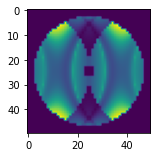

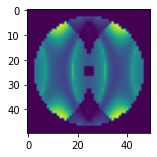

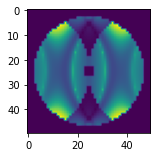

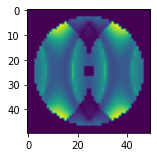

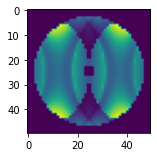

...

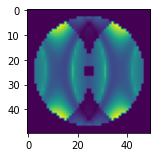

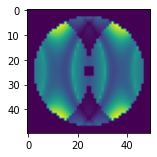

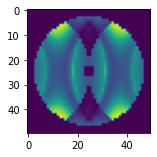

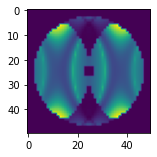

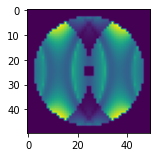

In [5]:
train_imgx = []
for i in range(len(train_polx)):
    plt.figure(figsize=(5,5))
    plt.subplot(221)
    img = np.array(train_polx.iloc[i, :]).reshape((50, 50)).astype('float32')
    plt.imshow(img) #, cmap='gray')
    train_imgx.append(img)
    plt.show()
# train_polx

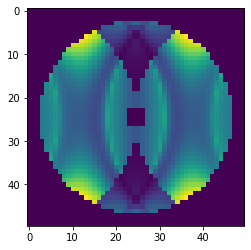

In [6]:
plt.imshow(train_imgx[0])

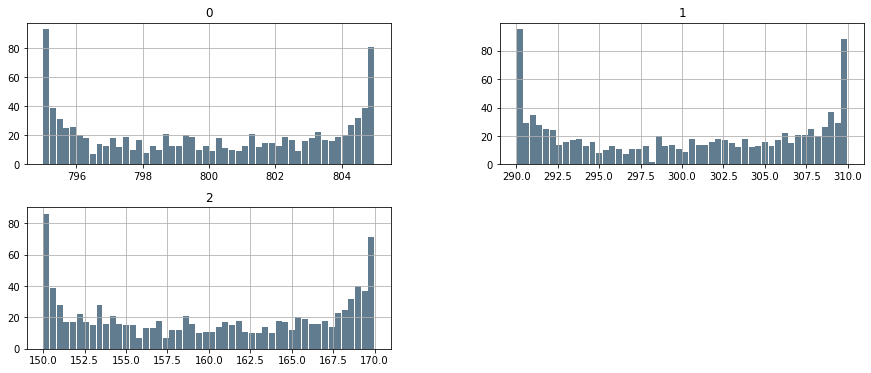

In [7]:
plt.rcParams["figure.figsize"] = (15,6)
param_train.hist(grid=True, bins=50, rwidth=0.9, color='#607c8e')
plt.show()

In [8]:
test_split = 200
batch_size = 1
train_loader = torch.utils.data.DataLoader(
    torch.utils.data.TensorDataset(torch.tensor(np.array(train_imgx[test_split:]), dtype=torch.float), 
                                   torch.tensor(param_train[0][test_split:].to_numpy(), dtype=torch.float)),
    batch_size=batch_size, shuffle=True, drop_last=True)
test_loader = torch.utils.data.DataLoader(
    torch.utils.data.TensorDataset(torch.tensor(np.array(train_imgx[:test_split]), dtype=torch.float), 
                                   torch.tensor(param_train[0][:test_split].to_numpy(), dtype=torch.float)),
    batch_size=batch_size, shuffle=True, drop_last=True)
train_loader, test_loader

(<torch.utils.data.dataloader.DataLoader at 0x26543cd6c10>,
 <torch.utils.data.dataloader.DataLoader at 0x26543cd6be0>)

In [9]:
out = [x for x in train_loader][2][0]
out = torch.nn.Conv2d(in_channels=1, out_channels=3, kernel_size=(3, 3), padding=1)(out)
out = torch.nn.ReLU()(out)
out = torch.nn.MaxPool2d((2, 2))(out)
out = torch.nn.Conv2d(in_channels=3, out_channels=1, kernel_size=(3, 3), padding=1)(out)
out = torch.nn.ReLU()(out)
out = torch.nn.MaxPool2d((2, 2))(out)
out = torch.nn.Flatten()(out)
out = torch.nn.Linear(144, 1)(out)
out

tensor([[0.0367]], grad_fn=<AddmmBackward0>)

In [10]:
[x for x in train_loader][0]

[tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          ...,
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.]]]),
 tensor([803.5633])]

In [11]:
class CNN(torch.nn.Module):
    def __init__(self):
        super().__init__()
        self.main = torch.nn.Sequential(
            torch.nn.Conv2d(in_channels=1, out_channels=3, kernel_size=(3, 3), padding=1),
            torch.nn.ReLU(),
            torch.nn.MaxPool2d((2, 2)),
            torch.nn.Conv2d(in_channels=3, out_channels=2, kernel_size=(3, 3), padding=1),
            torch.nn.ReLU(),
            torch.nn.MaxPool2d((2, 2)),
            torch.nn.Flatten(),
            torch.nn.Linear(144, 1)
        )

    def forward(self, x):
        out = self.main(x)
        return out

In [12]:
sz = 2500
cnn = CNN()
opt = optim.SGD(cnn.parameters(), lr=0.01)
loss_func = F.cross_entropy
epochs = 50
# batch_size = 100

In [13]:
res = []
for i in range(epochs):
    for x, y in train_loader:
        pred = cnn(x)
        criterion = nn.MSELoss()
        loss = criterion(pred, y)
        print(loss)
        loss.backward()
        opt.step() # Updating weights.
        opt.zero_grad()
        res.append(pred)

C:\Users\hahoa\anaconda3\lib\site-packages\torch\nn\modules\loss.py:536: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


tensor(647863.3750, grad_fn=<MseLossBackward0>)
tensor(611770.8125, grad_fn=<MseLossBackward0>)
tensor(582629.8750, grad_fn=<MseLossBackward0>)
tensor(574279.5000, grad_fn=<MseLossBackward0>)
tensor(551744.5000, grad_fn=<MseLossBackward0>)
tensor(517188.6875, grad_fn=<MseLossBackward0>)
tensor(497778.1250, grad_fn=<MseLossBackward0>)
tensor(487701.3125, grad_fn=<MseLossBackward0>)
tensor(458167.2812, grad_fn=<MseLossBackward0>)
tensor(448519.1250, grad_fn=<MseLossBackward0>)
tensor(432448.9688, grad_fn=<MseLossBackward0>)
tensor(404906.9688, grad_fn=<MseLossBackward0>)
tensor(395774.1562, grad_fn=<MseLossBackward0>)
tensor(375628.3438, grad_fn=<MseLossBackward0>)
tensor(357670.2812, grad_fn=<MseLossBackward0>)
tensor(346137.8750, grad_fn=<MseLossBackward0>)
tensor(332962.8750, grad_fn=<MseLossBackward0>)
tensor(327307.1250, grad_fn=<MseLossBackward0>)
tensor(306635.4688, grad_fn=<MseLossBackward0>)
tensor(302357.1562, grad_fn=<MseLossBackward0>)
tensor(287960.8750, grad_fn=<MseLossBack

tensor(573.9189, grad_fn=<MseLossBackward0>)
tensor(693.4819, grad_fn=<MseLossBackward0>)
tensor(287.8204, grad_fn=<MseLossBackward0>)
tensor(263.6877, grad_fn=<MseLossBackward0>)
tensor(567.7010, grad_fn=<MseLossBackward0>)
tensor(457.7286, grad_fn=<MseLossBackward0>)
tensor(569.8903, grad_fn=<MseLossBackward0>)
tensor(581.3650, grad_fn=<MseLossBackward0>)
tensor(204.9036, grad_fn=<MseLossBackward0>)
tensor(233.1176, grad_fn=<MseLossBackward0>)
tensor(387.9462, grad_fn=<MseLossBackward0>)
tensor(479.2716, grad_fn=<MseLossBackward0>)
tensor(282.9127, grad_fn=<MseLossBackward0>)
tensor(360.5270, grad_fn=<MseLossBackward0>)
tensor(253.3701, grad_fn=<MseLossBackward0>)
tensor(372.0208, grad_fn=<MseLossBackward0>)
tensor(285.8997, grad_fn=<MseLossBackward0>)
tensor(196.1829, grad_fn=<MseLossBackward0>)
tensor(370.8210, grad_fn=<MseLossBackward0>)
tensor(317.2895, grad_fn=<MseLossBackward0>)
tensor(365.9478, grad_fn=<MseLossBackward0>)
tensor(229.0223, grad_fn=<MseLossBackward0>)
tensor(271

tensor(28.2713, grad_fn=<MseLossBackward0>)
tensor(24.2074, grad_fn=<MseLossBackward0>)
tensor(25.0342, grad_fn=<MseLossBackward0>)
tensor(21.1126, grad_fn=<MseLossBackward0>)
tensor(21.2368, grad_fn=<MseLossBackward0>)
tensor(11.6850, grad_fn=<MseLossBackward0>)
tensor(18.2122, grad_fn=<MseLossBackward0>)
tensor(8.7700, grad_fn=<MseLossBackward0>)
tensor(0.0329, grad_fn=<MseLossBackward0>)
tensor(25.0623, grad_fn=<MseLossBackward0>)
tensor(22.8271, grad_fn=<MseLossBackward0>)
tensor(18.3736, grad_fn=<MseLossBackward0>)
tensor(0.5421, grad_fn=<MseLossBackward0>)
tensor(8.0090, grad_fn=<MseLossBackward0>)
tensor(0.0144, grad_fn=<MseLossBackward0>)
tensor(11.6863, grad_fn=<MseLossBackward0>)
tensor(16.1052, grad_fn=<MseLossBackward0>)
tensor(20.5688, grad_fn=<MseLossBackward0>)
tensor(23.9708, grad_fn=<MseLossBackward0>)
tensor(0.0360, grad_fn=<MseLossBackward0>)
tensor(18.7047, grad_fn=<MseLossBackward0>)
tensor(3.7166, grad_fn=<MseLossBackward0>)
tensor(2.7515, grad_fn=<MseLossBackward

tensor(25.2809, grad_fn=<MseLossBackward0>)
tensor(3.4951, grad_fn=<MseLossBackward0>)
tensor(13.2795, grad_fn=<MseLossBackward0>)
tensor(16.2643, grad_fn=<MseLossBackward0>)
tensor(25.9370, grad_fn=<MseLossBackward0>)
tensor(4.5933, grad_fn=<MseLossBackward0>)
tensor(10.8428, grad_fn=<MseLossBackward0>)
tensor(5.6633, grad_fn=<MseLossBackward0>)
tensor(20.4118, grad_fn=<MseLossBackward0>)
tensor(5.8749, grad_fn=<MseLossBackward0>)
tensor(8.5252, grad_fn=<MseLossBackward0>)
tensor(5.4409, grad_fn=<MseLossBackward0>)
tensor(28.1611, grad_fn=<MseLossBackward0>)
tensor(22.9790, grad_fn=<MseLossBackward0>)
tensor(15.5053, grad_fn=<MseLossBackward0>)
tensor(8.5909, grad_fn=<MseLossBackward0>)
tensor(27.8233, grad_fn=<MseLossBackward0>)
tensor(21.5320, grad_fn=<MseLossBackward0>)
tensor(21.7711, grad_fn=<MseLossBackward0>)
tensor(8.3720, grad_fn=<MseLossBackward0>)
tensor(15.9644, grad_fn=<MseLossBackward0>)
tensor(18.2346, grad_fn=<MseLossBackward0>)
tensor(1.1456, grad_fn=<MseLossBackward0

tensor(22.4936, grad_fn=<MseLossBackward0>)
tensor(7.0443, grad_fn=<MseLossBackward0>)
tensor(21.4160, grad_fn=<MseLossBackward0>)
tensor(21.3573, grad_fn=<MseLossBackward0>)
tensor(11.1884, grad_fn=<MseLossBackward0>)
tensor(7.9115, grad_fn=<MseLossBackward0>)
tensor(1.9932, grad_fn=<MseLossBackward0>)
tensor(24.5976, grad_fn=<MseLossBackward0>)
tensor(21.2064, grad_fn=<MseLossBackward0>)
tensor(26.2294, grad_fn=<MseLossBackward0>)
tensor(23.7948, grad_fn=<MseLossBackward0>)
tensor(20.0167, grad_fn=<MseLossBackward0>)
tensor(18.6962, grad_fn=<MseLossBackward0>)
tensor(24.8227, grad_fn=<MseLossBackward0>)
tensor(4.9690, grad_fn=<MseLossBackward0>)
tensor(24.1570, grad_fn=<MseLossBackward0>)
tensor(5.3029, grad_fn=<MseLossBackward0>)
tensor(18.2310, grad_fn=<MseLossBackward0>)
tensor(16.0538, grad_fn=<MseLossBackward0>)
tensor(1.5767, grad_fn=<MseLossBackward0>)
tensor(21.5445, grad_fn=<MseLossBackward0>)
tensor(21.5020, grad_fn=<MseLossBackward0>)
tensor(6.7098, grad_fn=<MseLossBackwar

tensor(5.2063, grad_fn=<MseLossBackward0>)
tensor(25.4088, grad_fn=<MseLossBackward0>)
tensor(21.7802, grad_fn=<MseLossBackward0>)
tensor(15.1674, grad_fn=<MseLossBackward0>)
tensor(18.7496, grad_fn=<MseLossBackward0>)
tensor(1.2014, grad_fn=<MseLossBackward0>)
tensor(0.7914, grad_fn=<MseLossBackward0>)
tensor(5.8513, grad_fn=<MseLossBackward0>)
tensor(20.5190, grad_fn=<MseLossBackward0>)
tensor(7.4548, grad_fn=<MseLossBackward0>)
tensor(17.3232, grad_fn=<MseLossBackward0>)
tensor(22.8639, grad_fn=<MseLossBackward0>)
tensor(13.3963, grad_fn=<MseLossBackward0>)
tensor(3.1490, grad_fn=<MseLossBackward0>)
tensor(23.0457, grad_fn=<MseLossBackward0>)
tensor(20.5765, grad_fn=<MseLossBackward0>)
tensor(3.1412, grad_fn=<MseLossBackward0>)
tensor(8.0000, grad_fn=<MseLossBackward0>)
tensor(0.6117, grad_fn=<MseLossBackward0>)
tensor(26.8595, grad_fn=<MseLossBackward0>)
tensor(25.1277, grad_fn=<MseLossBackward0>)
tensor(24.3934, grad_fn=<MseLossBackward0>)
tensor(23.8007, grad_fn=<MseLossBackward0

tensor(23.5051, grad_fn=<MseLossBackward0>)
tensor(25.8432, grad_fn=<MseLossBackward0>)
tensor(18.0262, grad_fn=<MseLossBackward0>)
tensor(3.6678, grad_fn=<MseLossBackward0>)
tensor(20.2857, grad_fn=<MseLossBackward0>)
tensor(1.7268, grad_fn=<MseLossBackward0>)
tensor(3.9157, grad_fn=<MseLossBackward0>)
tensor(23.6462, grad_fn=<MseLossBackward0>)
tensor(24.4724, grad_fn=<MseLossBackward0>)
tensor(0.8166, grad_fn=<MseLossBackward0>)
tensor(24.1192, grad_fn=<MseLossBackward0>)
tensor(2.2805, grad_fn=<MseLossBackward0>)
tensor(11.1407, grad_fn=<MseLossBackward0>)
tensor(9.2782, grad_fn=<MseLossBackward0>)
tensor(7.6271, grad_fn=<MseLossBackward0>)
tensor(25.0501, grad_fn=<MseLossBackward0>)
tensor(18.9818, grad_fn=<MseLossBackward0>)
tensor(2.9117, grad_fn=<MseLossBackward0>)
tensor(2.3858, grad_fn=<MseLossBackward0>)
tensor(14.5012, grad_fn=<MseLossBackward0>)
tensor(18.4574, grad_fn=<MseLossBackward0>)
tensor(18.3840, grad_fn=<MseLossBackward0>)
tensor(0.8271, grad_fn=<MseLossBackward0>

tensor(4.6660, grad_fn=<MseLossBackward0>)
tensor(19.4834, grad_fn=<MseLossBackward0>)
tensor(24.1078, grad_fn=<MseLossBackward0>)
tensor(5.0499, grad_fn=<MseLossBackward0>)
tensor(0.0739, grad_fn=<MseLossBackward0>)
tensor(21.3365, grad_fn=<MseLossBackward0>)
tensor(13.1260, grad_fn=<MseLossBackward0>)
tensor(26.6890, grad_fn=<MseLossBackward0>)
tensor(24.1258, grad_fn=<MseLossBackward0>)
tensor(7.0365, grad_fn=<MseLossBackward0>)
tensor(22.3542, grad_fn=<MseLossBackward0>)
tensor(1.0138, grad_fn=<MseLossBackward0>)
tensor(0.3456, grad_fn=<MseLossBackward0>)
tensor(18.9690, grad_fn=<MseLossBackward0>)
tensor(8.3946, grad_fn=<MseLossBackward0>)
tensor(27.2226, grad_fn=<MseLossBackward0>)
tensor(0.0158, grad_fn=<MseLossBackward0>)
tensor(24.8245, grad_fn=<MseLossBackward0>)
tensor(23.4217, grad_fn=<MseLossBackward0>)
tensor(12.3536, grad_fn=<MseLossBackward0>)
tensor(11.8294, grad_fn=<MseLossBackward0>)
tensor(14.3579, grad_fn=<MseLossBackward0>)
tensor(12.6692, grad_fn=<MseLossBackward

tensor(9.7435, grad_fn=<MseLossBackward0>)
tensor(4.2849, grad_fn=<MseLossBackward0>)
tensor(0.0602, grad_fn=<MseLossBackward0>)
tensor(2.2172, grad_fn=<MseLossBackward0>)
tensor(12.4009, grad_fn=<MseLossBackward0>)
tensor(0.2302, grad_fn=<MseLossBackward0>)
tensor(16.4286, grad_fn=<MseLossBackward0>)
tensor(17.4540, grad_fn=<MseLossBackward0>)
tensor(23.4111, grad_fn=<MseLossBackward0>)
tensor(16.6869, grad_fn=<MseLossBackward0>)
tensor(3.5793, grad_fn=<MseLossBackward0>)
tensor(11.2052, grad_fn=<MseLossBackward0>)
tensor(1.8933, grad_fn=<MseLossBackward0>)
tensor(12.1477, grad_fn=<MseLossBackward0>)
tensor(9.3378, grad_fn=<MseLossBackward0>)
tensor(17.1529, grad_fn=<MseLossBackward0>)
tensor(0.9588, grad_fn=<MseLossBackward0>)
tensor(1.8864, grad_fn=<MseLossBackward0>)
tensor(24.1936, grad_fn=<MseLossBackward0>)
tensor(0.0239, grad_fn=<MseLossBackward0>)
tensor(1.2367, grad_fn=<MseLossBackward0>)
tensor(25.8519, grad_fn=<MseLossBackward0>)
tensor(18.7522, grad_fn=<MseLossBackward0>)


tensor(12.0538, grad_fn=<MseLossBackward0>)
tensor(16.6291, grad_fn=<MseLossBackward0>)
tensor(0.8173, grad_fn=<MseLossBackward0>)
tensor(11.2461, grad_fn=<MseLossBackward0>)
tensor(21.7894, grad_fn=<MseLossBackward0>)
tensor(12.5548, grad_fn=<MseLossBackward0>)
tensor(1.4190, grad_fn=<MseLossBackward0>)
tensor(12.6341, grad_fn=<MseLossBackward0>)
tensor(2.1804, grad_fn=<MseLossBackward0>)
tensor(18.4181, grad_fn=<MseLossBackward0>)
tensor(14.4204, grad_fn=<MseLossBackward0>)
tensor(9.9769, grad_fn=<MseLossBackward0>)
tensor(17.6657, grad_fn=<MseLossBackward0>)
tensor(6.0361, grad_fn=<MseLossBackward0>)
tensor(1.2284, grad_fn=<MseLossBackward0>)
tensor(0.6545, grad_fn=<MseLossBackward0>)
tensor(16.9829, grad_fn=<MseLossBackward0>)
tensor(5.2557, grad_fn=<MseLossBackward0>)
tensor(0.5780, grad_fn=<MseLossBackward0>)
tensor(17.1508, grad_fn=<MseLossBackward0>)
tensor(20.2538, grad_fn=<MseLossBackward0>)
tensor(8.0477, grad_fn=<MseLossBackward0>)
tensor(11.8752, grad_fn=<MseLossBackward0>

tensor(16.5381, grad_fn=<MseLossBackward0>)
tensor(1.8158, grad_fn=<MseLossBackward0>)
tensor(26.1581, grad_fn=<MseLossBackward0>)
tensor(19.9517, grad_fn=<MseLossBackward0>)
tensor(19.5093, grad_fn=<MseLossBackward0>)
tensor(0.5259, grad_fn=<MseLossBackward0>)
tensor(1.1566, grad_fn=<MseLossBackward0>)
tensor(18.8168, grad_fn=<MseLossBackward0>)
tensor(0.1120, grad_fn=<MseLossBackward0>)
tensor(3.1485, grad_fn=<MseLossBackward0>)
tensor(0.0456, grad_fn=<MseLossBackward0>)
tensor(8.7820, grad_fn=<MseLossBackward0>)
tensor(26.8203, grad_fn=<MseLossBackward0>)
tensor(19.0686, grad_fn=<MseLossBackward0>)
tensor(2.4148, grad_fn=<MseLossBackward0>)
tensor(0.0411, grad_fn=<MseLossBackward0>)
tensor(11.2268, grad_fn=<MseLossBackward0>)
tensor(18.4862, grad_fn=<MseLossBackward0>)
tensor(22.5271, grad_fn=<MseLossBackward0>)
tensor(29.0983, grad_fn=<MseLossBackward0>)
tensor(7.3604, grad_fn=<MseLossBackward0>)
tensor(0.5883, grad_fn=<MseLossBackward0>)
tensor(3.6688, grad_fn=<MseLossBackward0>)


tensor(4.5815, grad_fn=<MseLossBackward0>)
tensor(22.7513, grad_fn=<MseLossBackward0>)
tensor(15.9532, grad_fn=<MseLossBackward0>)
tensor(0.7959, grad_fn=<MseLossBackward0>)
tensor(1.3779, grad_fn=<MseLossBackward0>)
tensor(1.8807, grad_fn=<MseLossBackward0>)
tensor(15.4007, grad_fn=<MseLossBackward0>)
tensor(25.6357, grad_fn=<MseLossBackward0>)
tensor(22.0139, grad_fn=<MseLossBackward0>)
tensor(21.0079, grad_fn=<MseLossBackward0>)
tensor(7.0742, grad_fn=<MseLossBackward0>)
tensor(25.6784, grad_fn=<MseLossBackward0>)
tensor(1.2481, grad_fn=<MseLossBackward0>)
tensor(19.1764, grad_fn=<MseLossBackward0>)
tensor(0.0732, grad_fn=<MseLossBackward0>)
tensor(20.4361, grad_fn=<MseLossBackward0>)
tensor(25.9115, grad_fn=<MseLossBackward0>)
tensor(22.0036, grad_fn=<MseLossBackward0>)
tensor(0.0246, grad_fn=<MseLossBackward0>)
tensor(3.9102, grad_fn=<MseLossBackward0>)
tensor(16.7483, grad_fn=<MseLossBackward0>)
tensor(23.9905, grad_fn=<MseLossBackward0>)
tensor(24.4362, grad_fn=<MseLossBackward0

tensor(7.3773, grad_fn=<MseLossBackward0>)
tensor(0.0386, grad_fn=<MseLossBackward0>)
tensor(17.6165, grad_fn=<MseLossBackward0>)
tensor(19.3833, grad_fn=<MseLossBackward0>)
tensor(0.6556, grad_fn=<MseLossBackward0>)
tensor(15.3519, grad_fn=<MseLossBackward0>)
tensor(3.0497, grad_fn=<MseLossBackward0>)
tensor(0.0003, grad_fn=<MseLossBackward0>)
tensor(14.5105, grad_fn=<MseLossBackward0>)
tensor(17.2978, grad_fn=<MseLossBackward0>)
tensor(27.1456, grad_fn=<MseLossBackward0>)
tensor(0.9418, grad_fn=<MseLossBackward0>)
tensor(2.1954, grad_fn=<MseLossBackward0>)
tensor(20.6086, grad_fn=<MseLossBackward0>)
tensor(8.3497, grad_fn=<MseLossBackward0>)
tensor(19.8423, grad_fn=<MseLossBackward0>)
tensor(1.5246, grad_fn=<MseLossBackward0>)
tensor(0.0024, grad_fn=<MseLossBackward0>)
tensor(24.0941, grad_fn=<MseLossBackward0>)
tensor(1.0893, grad_fn=<MseLossBackward0>)
tensor(25.3227, grad_fn=<MseLossBackward0>)
tensor(21.6080, grad_fn=<MseLossBackward0>)
tensor(18.3537, grad_fn=<MseLossBackward0>)

tensor(9.6212, grad_fn=<MseLossBackward0>)
tensor(4.0144, grad_fn=<MseLossBackward0>)
tensor(5.6094, grad_fn=<MseLossBackward0>)
tensor(5.6418, grad_fn=<MseLossBackward0>)
tensor(27.9432, grad_fn=<MseLossBackward0>)
tensor(1.6131, grad_fn=<MseLossBackward0>)
tensor(19.8271, grad_fn=<MseLossBackward0>)
tensor(19.4150, grad_fn=<MseLossBackward0>)
tensor(14.2140, grad_fn=<MseLossBackward0>)
tensor(16.8554, grad_fn=<MseLossBackward0>)
tensor(18.7485, grad_fn=<MseLossBackward0>)
tensor(0.0198, grad_fn=<MseLossBackward0>)
tensor(7.5042, grad_fn=<MseLossBackward0>)
tensor(16.4791, grad_fn=<MseLossBackward0>)
tensor(19.1962, grad_fn=<MseLossBackward0>)
tensor(18.2477, grad_fn=<MseLossBackward0>)
tensor(2.5371, grad_fn=<MseLossBackward0>)
tensor(33.3150, grad_fn=<MseLossBackward0>)
tensor(32.5375, grad_fn=<MseLossBackward0>)
tensor(2.7288, grad_fn=<MseLossBackward0>)
tensor(6.7478, grad_fn=<MseLossBackward0>)
tensor(5.0392, grad_fn=<MseLossBackward0>)
tensor(15.5930, grad_fn=<MseLossBackward0>)

tensor(26.7344, grad_fn=<MseLossBackward0>)
tensor(7.0472, grad_fn=<MseLossBackward0>)
tensor(21.2373, grad_fn=<MseLossBackward0>)
tensor(20.8576, grad_fn=<MseLossBackward0>)
tensor(19.0537, grad_fn=<MseLossBackward0>)
tensor(0.4990, grad_fn=<MseLossBackward0>)
tensor(7.7119, grad_fn=<MseLossBackward0>)
tensor(25.7006, grad_fn=<MseLossBackward0>)
tensor(24.7170, grad_fn=<MseLossBackward0>)
tensor(25.8556, grad_fn=<MseLossBackward0>)
tensor(18.7702, grad_fn=<MseLossBackward0>)
tensor(19.4866, grad_fn=<MseLossBackward0>)
tensor(5.4458, grad_fn=<MseLossBackward0>)
tensor(13.9050, grad_fn=<MseLossBackward0>)
tensor(15.5997, grad_fn=<MseLossBackward0>)
tensor(22.0890, grad_fn=<MseLossBackward0>)
tensor(23.5140, grad_fn=<MseLossBackward0>)
tensor(6.5405, grad_fn=<MseLossBackward0>)
tensor(15.7016, grad_fn=<MseLossBackward0>)
tensor(8.3257, grad_fn=<MseLossBackward0>)
tensor(8.8178, grad_fn=<MseLossBackward0>)
tensor(1.9681, grad_fn=<MseLossBackward0>)
tensor(11.7963, grad_fn=<MseLossBackward

tensor(29.4908, grad_fn=<MseLossBackward0>)
tensor(27.2315, grad_fn=<MseLossBackward0>)
tensor(2.4353, grad_fn=<MseLossBackward0>)
tensor(27.5862, grad_fn=<MseLossBackward0>)
tensor(6.5168, grad_fn=<MseLossBackward0>)
tensor(9.3520, grad_fn=<MseLossBackward0>)
tensor(23.2272, grad_fn=<MseLossBackward0>)
tensor(26.3000, grad_fn=<MseLossBackward0>)
tensor(1.5243, grad_fn=<MseLossBackward0>)
tensor(21.4811, grad_fn=<MseLossBackward0>)
tensor(1.8634, grad_fn=<MseLossBackward0>)
tensor(27.2940, grad_fn=<MseLossBackward0>)
tensor(0.1729, grad_fn=<MseLossBackward0>)
tensor(23.5104, grad_fn=<MseLossBackward0>)
tensor(16.6047, grad_fn=<MseLossBackward0>)
tensor(14.1652, grad_fn=<MseLossBackward0>)
tensor(15.1659, grad_fn=<MseLossBackward0>)
tensor(1.5642, grad_fn=<MseLossBackward0>)
tensor(4.0903, grad_fn=<MseLossBackward0>)
tensor(16.4940, grad_fn=<MseLossBackward0>)
tensor(0.2205, grad_fn=<MseLossBackward0>)
tensor(1.3311, grad_fn=<MseLossBackward0>)
tensor(22.0173, grad_fn=<MseLossBackward0>

tensor(24.5395, grad_fn=<MseLossBackward0>)
tensor(5.9590, grad_fn=<MseLossBackward0>)
tensor(7.8683, grad_fn=<MseLossBackward0>)
tensor(9.8662, grad_fn=<MseLossBackward0>)
tensor(1.1541, grad_fn=<MseLossBackward0>)
tensor(16.4534, grad_fn=<MseLossBackward0>)
tensor(1.8182, grad_fn=<MseLossBackward0>)
tensor(12.9611, grad_fn=<MseLossBackward0>)
tensor(14.8905, grad_fn=<MseLossBackward0>)
tensor(10.9383, grad_fn=<MseLossBackward0>)
tensor(23.5021, grad_fn=<MseLossBackward0>)
tensor(25.0403, grad_fn=<MseLossBackward0>)
tensor(19.3554, grad_fn=<MseLossBackward0>)
tensor(22.4264, grad_fn=<MseLossBackward0>)
tensor(6.6707, grad_fn=<MseLossBackward0>)
tensor(2.8481, grad_fn=<MseLossBackward0>)
tensor(16.7558, grad_fn=<MseLossBackward0>)
tensor(3.7527, grad_fn=<MseLossBackward0>)
tensor(0.4183, grad_fn=<MseLossBackward0>)
tensor(1.6030, grad_fn=<MseLossBackward0>)
tensor(11.2608, grad_fn=<MseLossBackward0>)
tensor(17.8845, grad_fn=<MseLossBackward0>)
tensor(4.1822, grad_fn=<MseLossBackward0>)

tensor(8.9733, grad_fn=<MseLossBackward0>)
tensor(24.3072, grad_fn=<MseLossBackward0>)
tensor(3.6263, grad_fn=<MseLossBackward0>)
tensor(22.6844, grad_fn=<MseLossBackward0>)
tensor(9.8658, grad_fn=<MseLossBackward0>)
tensor(17.4045, grad_fn=<MseLossBackward0>)
tensor(7.9153, grad_fn=<MseLossBackward0>)
tensor(23.8580, grad_fn=<MseLossBackward0>)
tensor(13.9424, grad_fn=<MseLossBackward0>)
tensor(0.4616, grad_fn=<MseLossBackward0>)
tensor(1.9135, grad_fn=<MseLossBackward0>)
tensor(23.3727, grad_fn=<MseLossBackward0>)
tensor(20.8922, grad_fn=<MseLossBackward0>)
tensor(7.2161, grad_fn=<MseLossBackward0>)
tensor(19.5255, grad_fn=<MseLossBackward0>)
tensor(17.9118, grad_fn=<MseLossBackward0>)
tensor(0.6456, grad_fn=<MseLossBackward0>)
tensor(19.1909, grad_fn=<MseLossBackward0>)
tensor(3.9111, grad_fn=<MseLossBackward0>)
tensor(16.4113, grad_fn=<MseLossBackward0>)
tensor(17.2942, grad_fn=<MseLossBackward0>)
tensor(2.5346, grad_fn=<MseLossBackward0>)
tensor(0.2384, grad_fn=<MseLossBackward0>)

tensor(8.6332, grad_fn=<MseLossBackward0>)
tensor(16.0063, grad_fn=<MseLossBackward0>)
tensor(1.8057, grad_fn=<MseLossBackward0>)
tensor(16.3283, grad_fn=<MseLossBackward0>)
tensor(16.8910, grad_fn=<MseLossBackward0>)
tensor(1.6265, grad_fn=<MseLossBackward0>)
tensor(22.6734, grad_fn=<MseLossBackward0>)
tensor(22.1734, grad_fn=<MseLossBackward0>)
tensor(4.0093, grad_fn=<MseLossBackward0>)
tensor(22.6920, grad_fn=<MseLossBackward0>)
tensor(13.3111, grad_fn=<MseLossBackward0>)
tensor(27.2354, grad_fn=<MseLossBackward0>)
tensor(1.9987, grad_fn=<MseLossBackward0>)
tensor(0.0164, grad_fn=<MseLossBackward0>)
tensor(0.4647, grad_fn=<MseLossBackward0>)
tensor(0.4732, grad_fn=<MseLossBackward0>)
tensor(16.0264, grad_fn=<MseLossBackward0>)
tensor(25.4500, grad_fn=<MseLossBackward0>)
tensor(16.4113, grad_fn=<MseLossBackward0>)
tensor(15.7060, grad_fn=<MseLossBackward0>)
tensor(0.9801, grad_fn=<MseLossBackward0>)
tensor(1.0637, grad_fn=<MseLossBackward0>)
tensor(22.1027, grad_fn=<MseLossBackward0>

tensor(16.1267, grad_fn=<MseLossBackward0>)
tensor(23.1149, grad_fn=<MseLossBackward0>)
tensor(11.2686, grad_fn=<MseLossBackward0>)
tensor(6.6748, grad_fn=<MseLossBackward0>)
tensor(24.6345, grad_fn=<MseLossBackward0>)
tensor(3.1176, grad_fn=<MseLossBackward0>)
tensor(9.9403, grad_fn=<MseLossBackward0>)
tensor(4.4176, grad_fn=<MseLossBackward0>)
tensor(24.0096, grad_fn=<MseLossBackward0>)
tensor(0.3040, grad_fn=<MseLossBackward0>)
tensor(21.8669, grad_fn=<MseLossBackward0>)
tensor(10.8119, grad_fn=<MseLossBackward0>)
tensor(1.3454, grad_fn=<MseLossBackward0>)
tensor(0.3125, grad_fn=<MseLossBackward0>)
tensor(2.2645, grad_fn=<MseLossBackward0>)
tensor(19.0084, grad_fn=<MseLossBackward0>)
tensor(8.8665, grad_fn=<MseLossBackward0>)
tensor(21.4302, grad_fn=<MseLossBackward0>)
tensor(21.4969, grad_fn=<MseLossBackward0>)
tensor(1.5729, grad_fn=<MseLossBackward0>)
tensor(19.2894, grad_fn=<MseLossBackward0>)
tensor(26.6241, grad_fn=<MseLossBackward0>)
tensor(28.2960, grad_fn=<MseLossBackward0>

tensor(10.1870, grad_fn=<MseLossBackward0>)
tensor(13.0527, grad_fn=<MseLossBackward0>)
tensor(15.6576, grad_fn=<MseLossBackward0>)
tensor(8.0859, grad_fn=<MseLossBackward0>)
tensor(25.3860, grad_fn=<MseLossBackward0>)
tensor(15.6451, grad_fn=<MseLossBackward0>)
tensor(6.4214, grad_fn=<MseLossBackward0>)
tensor(1.0920, grad_fn=<MseLossBackward0>)
tensor(23.5477, grad_fn=<MseLossBackward0>)
tensor(15.1869, grad_fn=<MseLossBackward0>)
tensor(27.0090, grad_fn=<MseLossBackward0>)
tensor(20.4366, grad_fn=<MseLossBackward0>)
tensor(22.3658, grad_fn=<MseLossBackward0>)
tensor(6.2897, grad_fn=<MseLossBackward0>)
tensor(10.2174, grad_fn=<MseLossBackward0>)
tensor(22.4860, grad_fn=<MseLossBackward0>)
tensor(24.0767, grad_fn=<MseLossBackward0>)
tensor(3.4319, grad_fn=<MseLossBackward0>)
tensor(24.5728, grad_fn=<MseLossBackward0>)
tensor(0.6001, grad_fn=<MseLossBackward0>)
tensor(22.0683, grad_fn=<MseLossBackward0>)
tensor(19.0004, grad_fn=<MseLossBackward0>)
tensor(25.0232, grad_fn=<MseLossBackwa

tensor(8.4797, grad_fn=<MseLossBackward0>)
tensor(0.3065, grad_fn=<MseLossBackward0>)
tensor(21.2604, grad_fn=<MseLossBackward0>)
tensor(20.0194, grad_fn=<MseLossBackward0>)
tensor(19.2369, grad_fn=<MseLossBackward0>)
tensor(1.9135, grad_fn=<MseLossBackward0>)
tensor(16.5476, grad_fn=<MseLossBackward0>)
tensor(25.3922, grad_fn=<MseLossBackward0>)
tensor(23.0856, grad_fn=<MseLossBackward0>)
tensor(20.8365, grad_fn=<MseLossBackward0>)
tensor(0.0014, grad_fn=<MseLossBackward0>)
tensor(0.0022, grad_fn=<MseLossBackward0>)
tensor(26.0396, grad_fn=<MseLossBackward0>)
tensor(14.0978, grad_fn=<MseLossBackward0>)
tensor(4.3996, grad_fn=<MseLossBackward0>)
tensor(17.0398, grad_fn=<MseLossBackward0>)
tensor(18.9526, grad_fn=<MseLossBackward0>)
tensor(1.8634, grad_fn=<MseLossBackward0>)
tensor(1.1742, grad_fn=<MseLossBackward0>)
tensor(9.8746, grad_fn=<MseLossBackward0>)
tensor(18.2107, grad_fn=<MseLossBackward0>)
tensor(4.7229, grad_fn=<MseLossBackward0>)
tensor(16.1561, grad_fn=<MseLossBackward0>

tensor(10.8581, grad_fn=<MseLossBackward0>)
tensor(1.9265, grad_fn=<MseLossBackward0>)
tensor(2.3203, grad_fn=<MseLossBackward0>)
tensor(0.0023, grad_fn=<MseLossBackward0>)
tensor(7.8287, grad_fn=<MseLossBackward0>)
tensor(0.2276, grad_fn=<MseLossBackward0>)
tensor(2.4326, grad_fn=<MseLossBackward0>)
tensor(7.6203, grad_fn=<MseLossBackward0>)
tensor(19.7478, grad_fn=<MseLossBackward0>)
tensor(19.5362, grad_fn=<MseLossBackward0>)
tensor(2.1501, grad_fn=<MseLossBackward0>)
tensor(1.0919, grad_fn=<MseLossBackward0>)
tensor(0.1115, grad_fn=<MseLossBackward0>)
tensor(22.9550, grad_fn=<MseLossBackward0>)
tensor(8.6601, grad_fn=<MseLossBackward0>)
tensor(0.9082, grad_fn=<MseLossBackward0>)
tensor(12.1937, grad_fn=<MseLossBackward0>)
tensor(11.5233, grad_fn=<MseLossBackward0>)
tensor(16.5933, grad_fn=<MseLossBackward0>)
tensor(2.2232, grad_fn=<MseLossBackward0>)
tensor(23.3190, grad_fn=<MseLossBackward0>)
tensor(2.2914, grad_fn=<MseLossBackward0>)
tensor(7.7282, grad_fn=<MseLossBackward0>)
ten

tensor(16.0861, grad_fn=<MseLossBackward0>)
tensor(0.0016, grad_fn=<MseLossBackward0>)
tensor(8.7419, grad_fn=<MseLossBackward0>)
tensor(2.8749, grad_fn=<MseLossBackward0>)
tensor(0.9695, grad_fn=<MseLossBackward0>)
tensor(3.4455, grad_fn=<MseLossBackward0>)
tensor(29.3696, grad_fn=<MseLossBackward0>)
tensor(15.0758, grad_fn=<MseLossBackward0>)
tensor(9.5230, grad_fn=<MseLossBackward0>)
tensor(6.6166, grad_fn=<MseLossBackward0>)
tensor(16.3688, grad_fn=<MseLossBackward0>)
tensor(14.4733, grad_fn=<MseLossBackward0>)
tensor(30.1293, grad_fn=<MseLossBackward0>)
tensor(11.7695, grad_fn=<MseLossBackward0>)
tensor(2.1267, grad_fn=<MseLossBackward0>)
tensor(19.9555, grad_fn=<MseLossBackward0>)
tensor(0.4803, grad_fn=<MseLossBackward0>)
tensor(1.5926, grad_fn=<MseLossBackward0>)
tensor(1.6162, grad_fn=<MseLossBackward0>)
tensor(22.7339, grad_fn=<MseLossBackward0>)
tensor(29.9346, grad_fn=<MseLossBackward0>)
tensor(20.8984, grad_fn=<MseLossBackward0>)
tensor(14.6690, grad_fn=<MseLossBackward0>)

tensor(6.6741, grad_fn=<MseLossBackward0>)
tensor(17.4754, grad_fn=<MseLossBackward0>)
tensor(7.7591, grad_fn=<MseLossBackward0>)
tensor(1.0480, grad_fn=<MseLossBackward0>)
tensor(2.6563, grad_fn=<MseLossBackward0>)
tensor(23.6023, grad_fn=<MseLossBackward0>)
tensor(23.0774, grad_fn=<MseLossBackward0>)
tensor(16.0352, grad_fn=<MseLossBackward0>)
tensor(25.1332, grad_fn=<MseLossBackward0>)
tensor(8.7917, grad_fn=<MseLossBackward0>)
tensor(26.0378, grad_fn=<MseLossBackward0>)
tensor(14.2895, grad_fn=<MseLossBackward0>)
tensor(6.7329, grad_fn=<MseLossBackward0>)
tensor(0.1030, grad_fn=<MseLossBackward0>)
tensor(22.2073, grad_fn=<MseLossBackward0>)
tensor(0.3965, grad_fn=<MseLossBackward0>)
tensor(17.6288, grad_fn=<MseLossBackward0>)
tensor(7.1843, grad_fn=<MseLossBackward0>)
tensor(1.2522, grad_fn=<MseLossBackward0>)
tensor(3.3644, grad_fn=<MseLossBackward0>)
tensor(25.2122, grad_fn=<MseLossBackward0>)
tensor(3.3954, grad_fn=<MseLossBackward0>)
tensor(21.5309, grad_fn=<MseLossBackward0>)


tensor(7.9886, grad_fn=<MseLossBackward0>)
tensor(21.6171, grad_fn=<MseLossBackward0>)
tensor(14.3949, grad_fn=<MseLossBackward0>)
tensor(3.2637, grad_fn=<MseLossBackward0>)
tensor(12.2697, grad_fn=<MseLossBackward0>)
tensor(0.8568, grad_fn=<MseLossBackward0>)
tensor(5.8803, grad_fn=<MseLossBackward0>)
tensor(26.1650, grad_fn=<MseLossBackward0>)
tensor(0.2344, grad_fn=<MseLossBackward0>)
tensor(18.4495, grad_fn=<MseLossBackward0>)
tensor(24.5069, grad_fn=<MseLossBackward0>)
tensor(18.4186, grad_fn=<MseLossBackward0>)
tensor(28.3330, grad_fn=<MseLossBackward0>)
tensor(9.7511, grad_fn=<MseLossBackward0>)
tensor(18.4374, grad_fn=<MseLossBackward0>)
tensor(1.4089, grad_fn=<MseLossBackward0>)
tensor(6.4891, grad_fn=<MseLossBackward0>)
tensor(19.2722, grad_fn=<MseLossBackward0>)
tensor(18.9994, grad_fn=<MseLossBackward0>)
tensor(19.8472, grad_fn=<MseLossBackward0>)
tensor(8.2250, grad_fn=<MseLossBackward0>)
tensor(18.3966, grad_fn=<MseLossBackward0>)
tensor(0.0305, grad_fn=<MseLossBackward0>

tensor(18.9122, grad_fn=<MseLossBackward0>)
tensor(4.9685, grad_fn=<MseLossBackward0>)
tensor(18.5514, grad_fn=<MseLossBackward0>)
tensor(0.1857, grad_fn=<MseLossBackward0>)
tensor(8.0734, grad_fn=<MseLossBackward0>)
tensor(6.9471, grad_fn=<MseLossBackward0>)
tensor(5.7892, grad_fn=<MseLossBackward0>)
tensor(0.7569, grad_fn=<MseLossBackward0>)
tensor(23.8293, grad_fn=<MseLossBackward0>)
tensor(23.7174, grad_fn=<MseLossBackward0>)
tensor(1.6433, grad_fn=<MseLossBackward0>)
tensor(11.5664, grad_fn=<MseLossBackward0>)
tensor(14.5379, grad_fn=<MseLossBackward0>)
tensor(14.9070, grad_fn=<MseLossBackward0>)
tensor(12.7903, grad_fn=<MseLossBackward0>)
tensor(24.8665, grad_fn=<MseLossBackward0>)
tensor(1.9930, grad_fn=<MseLossBackward0>)
tensor(8.6673, grad_fn=<MseLossBackward0>)
tensor(2.9825, grad_fn=<MseLossBackward0>)
tensor(0.0267, grad_fn=<MseLossBackward0>)
tensor(21.8915, grad_fn=<MseLossBackward0>)
tensor(0.7447, grad_fn=<MseLossBackward0>)
tensor(10.7350, grad_fn=<MseLossBackward0>)


tensor(22.8347, grad_fn=<MseLossBackward0>)
tensor(0.7055, grad_fn=<MseLossBackward0>)
tensor(22.0706, grad_fn=<MseLossBackward0>)
tensor(2.3335, grad_fn=<MseLossBackward0>)
tensor(0.7264, grad_fn=<MseLossBackward0>)
tensor(11.3503, grad_fn=<MseLossBackward0>)
tensor(8.8262, grad_fn=<MseLossBackward0>)
tensor(0.8633, grad_fn=<MseLossBackward0>)
tensor(1.4475, grad_fn=<MseLossBackward0>)
tensor(1.1890, grad_fn=<MseLossBackward0>)
tensor(14.7308, grad_fn=<MseLossBackward0>)
tensor(26.4593, grad_fn=<MseLossBackward0>)
tensor(0.6236, grad_fn=<MseLossBackward0>)
tensor(14.8242, grad_fn=<MseLossBackward0>)
tensor(18.1477, grad_fn=<MseLossBackward0>)
tensor(13.7064, grad_fn=<MseLossBackward0>)
tensor(0.4022, grad_fn=<MseLossBackward0>)
tensor(16.2835, grad_fn=<MseLossBackward0>)
tensor(19.2551, grad_fn=<MseLossBackward0>)
tensor(1.2784, grad_fn=<MseLossBackward0>)
tensor(6.0995, grad_fn=<MseLossBackward0>)
tensor(15.5458, grad_fn=<MseLossBackward0>)
tensor(7.5377, grad_fn=<MseLossBackward0>)


tensor(26.2112, grad_fn=<MseLossBackward0>)
tensor(14.9825, grad_fn=<MseLossBackward0>)
tensor(5.0620, grad_fn=<MseLossBackward0>)
tensor(31.1713, grad_fn=<MseLossBackward0>)
tensor(30.7428, grad_fn=<MseLossBackward0>)
tensor(12.2470, grad_fn=<MseLossBackward0>)
tensor(9.9712, grad_fn=<MseLossBackward0>)
tensor(13.9688, grad_fn=<MseLossBackward0>)
tensor(7.1145, grad_fn=<MseLossBackward0>)
tensor(8.5021, grad_fn=<MseLossBackward0>)
tensor(0.8083, grad_fn=<MseLossBackward0>)
tensor(0.4012, grad_fn=<MseLossBackward0>)
tensor(25.8817, grad_fn=<MseLossBackward0>)
tensor(13.7534, grad_fn=<MseLossBackward0>)
tensor(17.6006, grad_fn=<MseLossBackward0>)
tensor(3.0678, grad_fn=<MseLossBackward0>)
tensor(16.2215, grad_fn=<MseLossBackward0>)
tensor(2.5816, grad_fn=<MseLossBackward0>)
tensor(19.8254, grad_fn=<MseLossBackward0>)
tensor(16.6510, grad_fn=<MseLossBackward0>)
tensor(17.0928, grad_fn=<MseLossBackward0>)
tensor(4.3158, grad_fn=<MseLossBackward0>)
tensor(27.0350, grad_fn=<MseLossBackward0

tensor(2.1299, grad_fn=<MseLossBackward0>)
tensor(0.0001, grad_fn=<MseLossBackward0>)
tensor(1.5870, grad_fn=<MseLossBackward0>)
tensor(0.0575, grad_fn=<MseLossBackward0>)
tensor(18.2299, grad_fn=<MseLossBackward0>)
tensor(0.4232, grad_fn=<MseLossBackward0>)
tensor(13.6188, grad_fn=<MseLossBackward0>)
tensor(17.2729, grad_fn=<MseLossBackward0>)
tensor(25.4463, grad_fn=<MseLossBackward0>)
tensor(24.9037, grad_fn=<MseLossBackward0>)
tensor(7.0982, grad_fn=<MseLossBackward0>)
tensor(23.9857, grad_fn=<MseLossBackward0>)
tensor(5.4757, grad_fn=<MseLossBackward0>)
tensor(11.1864, grad_fn=<MseLossBackward0>)
tensor(11.8895, grad_fn=<MseLossBackward0>)
tensor(15.9736, grad_fn=<MseLossBackward0>)
tensor(2.9254, grad_fn=<MseLossBackward0>)
tensor(4.3476, grad_fn=<MseLossBackward0>)
tensor(11.8542, grad_fn=<MseLossBackward0>)
tensor(7.8160, grad_fn=<MseLossBackward0>)
tensor(22.1452, grad_fn=<MseLossBackward0>)
tensor(5.6053, grad_fn=<MseLossBackward0>)
tensor(7.2089, grad_fn=<MseLossBackward0>)


tensor(4.6599, grad_fn=<MseLossBackward0>)
tensor(1.0241, grad_fn=<MseLossBackward0>)
tensor(20.9665, grad_fn=<MseLossBackward0>)
tensor(9.3468, grad_fn=<MseLossBackward0>)
tensor(28.3304, grad_fn=<MseLossBackward0>)
tensor(4.1200, grad_fn=<MseLossBackward0>)
tensor(19.2128, grad_fn=<MseLossBackward0>)
tensor(13.7797, grad_fn=<MseLossBackward0>)
tensor(0.2753, grad_fn=<MseLossBackward0>)
tensor(8.2632, grad_fn=<MseLossBackward0>)
tensor(16.7673, grad_fn=<MseLossBackward0>)
tensor(15.0497, grad_fn=<MseLossBackward0>)
tensor(20.0363, grad_fn=<MseLossBackward0>)
tensor(0.6791, grad_fn=<MseLossBackward0>)
tensor(27.0528, grad_fn=<MseLossBackward0>)
tensor(8.0017, grad_fn=<MseLossBackward0>)
tensor(7.8054, grad_fn=<MseLossBackward0>)
tensor(13.7769, grad_fn=<MseLossBackward0>)
tensor(4.3557, grad_fn=<MseLossBackward0>)
tensor(26.1431, grad_fn=<MseLossBackward0>)
tensor(20.1113, grad_fn=<MseLossBackward0>)
tensor(20.9514, grad_fn=<MseLossBackward0>)
tensor(1.2590, grad_fn=<MseLossBackward0>)

tensor(0.6901, grad_fn=<MseLossBackward0>)
tensor(22.3964, grad_fn=<MseLossBackward0>)
tensor(0.2552, grad_fn=<MseLossBackward0>)
tensor(24.9768, grad_fn=<MseLossBackward0>)
tensor(21.4313, grad_fn=<MseLossBackward0>)
tensor(4.0701, grad_fn=<MseLossBackward0>)
tensor(0.0110, grad_fn=<MseLossBackward0>)
tensor(5.8021, grad_fn=<MseLossBackward0>)
tensor(3.5282, grad_fn=<MseLossBackward0>)
tensor(6.5349, grad_fn=<MseLossBackward0>)
tensor(21.8829, grad_fn=<MseLossBackward0>)
tensor(12.0941, grad_fn=<MseLossBackward0>)
tensor(9.6807, grad_fn=<MseLossBackward0>)
tensor(24.5328, grad_fn=<MseLossBackward0>)
tensor(3.0689, grad_fn=<MseLossBackward0>)
tensor(18.9064, grad_fn=<MseLossBackward0>)
tensor(24.3518, grad_fn=<MseLossBackward0>)
tensor(16.4256, grad_fn=<MseLossBackward0>)
tensor(1.2768, grad_fn=<MseLossBackward0>)
tensor(14.7051, grad_fn=<MseLossBackward0>)
tensor(24.4875, grad_fn=<MseLossBackward0>)
tensor(23.4324, grad_fn=<MseLossBackward0>)
tensor(6.1882, grad_fn=<MseLossBackward0>)

tensor(7.3479, grad_fn=<MseLossBackward0>)
tensor(8.1161, grad_fn=<MseLossBackward0>)
tensor(0.0748, grad_fn=<MseLossBackward0>)
tensor(0.0771, grad_fn=<MseLossBackward0>)
tensor(22.1538, grad_fn=<MseLossBackward0>)
tensor(1.4784, grad_fn=<MseLossBackward0>)
tensor(2.2361, grad_fn=<MseLossBackward0>)
tensor(20.0107, grad_fn=<MseLossBackward0>)
tensor(13.7661, grad_fn=<MseLossBackward0>)
tensor(13.0730, grad_fn=<MseLossBackward0>)
tensor(22.5706, grad_fn=<MseLossBackward0>)
tensor(5.6941, grad_fn=<MseLossBackward0>)
tensor(2.4248, grad_fn=<MseLossBackward0>)
tensor(7.4795, grad_fn=<MseLossBackward0>)
tensor(6.4617, grad_fn=<MseLossBackward0>)
tensor(12.8686, grad_fn=<MseLossBackward0>)
tensor(0.0003, grad_fn=<MseLossBackward0>)
tensor(0.0123, grad_fn=<MseLossBackward0>)
tensor(14.5775, grad_fn=<MseLossBackward0>)
tensor(25.1485, grad_fn=<MseLossBackward0>)
tensor(1.7794, grad_fn=<MseLossBackward0>)
tensor(4.8901, grad_fn=<MseLossBackward0>)
tensor(8.7177, grad_fn=<MseLossBackward0>)
ten

tensor(19.7304, grad_fn=<MseLossBackward0>)
tensor(2.7746, grad_fn=<MseLossBackward0>)
tensor(21.7427, grad_fn=<MseLossBackward0>)
tensor(3.2397, grad_fn=<MseLossBackward0>)
tensor(24.5498, grad_fn=<MseLossBackward0>)
tensor(20.2401, grad_fn=<MseLossBackward0>)
tensor(17.1230, grad_fn=<MseLossBackward0>)
tensor(6.3946, grad_fn=<MseLossBackward0>)
tensor(22.5932, grad_fn=<MseLossBackward0>)
tensor(16.6979, grad_fn=<MseLossBackward0>)
tensor(0.0250, grad_fn=<MseLossBackward0>)
tensor(21.7820, grad_fn=<MseLossBackward0>)
tensor(4.7622, grad_fn=<MseLossBackward0>)
tensor(10.5558, grad_fn=<MseLossBackward0>)
tensor(18.3134, grad_fn=<MseLossBackward0>)
tensor(20.8242, grad_fn=<MseLossBackward0>)
tensor(20.2758, grad_fn=<MseLossBackward0>)
tensor(7.1445, grad_fn=<MseLossBackward0>)
tensor(25.4574, grad_fn=<MseLossBackward0>)
tensor(0.9149, grad_fn=<MseLossBackward0>)
tensor(3.9678, grad_fn=<MseLossBackward0>)
tensor(1.7867, grad_fn=<MseLossBackward0>)
tensor(22.8633, grad_fn=<MseLossBackward0

tensor(19.0404, grad_fn=<MseLossBackward0>)
tensor(0.7273, grad_fn=<MseLossBackward0>)
tensor(1.3596, grad_fn=<MseLossBackward0>)
tensor(0.0016, grad_fn=<MseLossBackward0>)
tensor(28.8854, grad_fn=<MseLossBackward0>)
tensor(4.4353, grad_fn=<MseLossBackward0>)
tensor(7.2440, grad_fn=<MseLossBackward0>)
tensor(25.8339, grad_fn=<MseLossBackward0>)
tensor(0.1640, grad_fn=<MseLossBackward0>)
tensor(10.7754, grad_fn=<MseLossBackward0>)
tensor(12.0581, grad_fn=<MseLossBackward0>)
tensor(0.8000, grad_fn=<MseLossBackward0>)
tensor(14.2084, grad_fn=<MseLossBackward0>)
tensor(12.5146, grad_fn=<MseLossBackward0>)
tensor(31.6887, grad_fn=<MseLossBackward0>)
tensor(8.0093, grad_fn=<MseLossBackward0>)
tensor(9.4343, grad_fn=<MseLossBackward0>)
tensor(28.7229, grad_fn=<MseLossBackward0>)
tensor(0.0421, grad_fn=<MseLossBackward0>)
tensor(8.2453, grad_fn=<MseLossBackward0>)
tensor(13.3557, grad_fn=<MseLossBackward0>)
tensor(8.9196, grad_fn=<MseLossBackward0>)
tensor(14.0707, grad_fn=<MseLossBackward0>)


tensor(5.0258, grad_fn=<MseLossBackward0>)
tensor(0.4476, grad_fn=<MseLossBackward0>)
tensor(25.9034, grad_fn=<MseLossBackward0>)
tensor(14.7008, grad_fn=<MseLossBackward0>)
tensor(22.7898, grad_fn=<MseLossBackward0>)
tensor(5.8242, grad_fn=<MseLossBackward0>)
tensor(15.7500, grad_fn=<MseLossBackward0>)
tensor(21.7603, grad_fn=<MseLossBackward0>)
tensor(24.0761, grad_fn=<MseLossBackward0>)
tensor(26.6310, grad_fn=<MseLossBackward0>)
tensor(24.2038, grad_fn=<MseLossBackward0>)
tensor(21.6613, grad_fn=<MseLossBackward0>)
tensor(7.9990, grad_fn=<MseLossBackward0>)
tensor(23.6889, grad_fn=<MseLossBackward0>)
tensor(1.6822, grad_fn=<MseLossBackward0>)
tensor(5.7446, grad_fn=<MseLossBackward0>)
tensor(0.0697, grad_fn=<MseLossBackward0>)
tensor(9.0697, grad_fn=<MseLossBackward0>)
tensor(0.6207, grad_fn=<MseLossBackward0>)
tensor(19.8281, grad_fn=<MseLossBackward0>)
tensor(0.0062, grad_fn=<MseLossBackward0>)
tensor(1.8799, grad_fn=<MseLossBackward0>)
tensor(5.8980, grad_fn=<MseLossBackward0>)


tensor(9.8348, grad_fn=<MseLossBackward0>)
tensor(3.2413, grad_fn=<MseLossBackward0>)
tensor(19.7624, grad_fn=<MseLossBackward0>)
tensor(13.4128, grad_fn=<MseLossBackward0>)
tensor(27.1908, grad_fn=<MseLossBackward0>)
tensor(21.2401, grad_fn=<MseLossBackward0>)
tensor(17.3237, grad_fn=<MseLossBackward0>)
tensor(6.6480, grad_fn=<MseLossBackward0>)
tensor(25.7731, grad_fn=<MseLossBackward0>)
tensor(3.6688, grad_fn=<MseLossBackward0>)
tensor(0.0004, grad_fn=<MseLossBackward0>)
tensor(23.8872, grad_fn=<MseLossBackward0>)
tensor(24.2573, grad_fn=<MseLossBackward0>)
tensor(20.6968, grad_fn=<MseLossBackward0>)
tensor(22.8528, grad_fn=<MseLossBackward0>)
tensor(23.7056, grad_fn=<MseLossBackward0>)
tensor(9.5294, grad_fn=<MseLossBackward0>)
tensor(4.3925, grad_fn=<MseLossBackward0>)
tensor(1.6182, grad_fn=<MseLossBackward0>)
tensor(24.0090, grad_fn=<MseLossBackward0>)
tensor(6.7142, grad_fn=<MseLossBackward0>)
tensor(25.9749, grad_fn=<MseLossBackward0>)
tensor(16.2175, grad_fn=<MseLossBackward0

tensor(10.0941, grad_fn=<MseLossBackward0>)
tensor(23.0393, grad_fn=<MseLossBackward0>)
tensor(24.7036, grad_fn=<MseLossBackward0>)
tensor(5.7031, grad_fn=<MseLossBackward0>)
tensor(0.3481, grad_fn=<MseLossBackward0>)
tensor(0.0804, grad_fn=<MseLossBackward0>)
tensor(20.1847, grad_fn=<MseLossBackward0>)
tensor(19.2288, grad_fn=<MseLossBackward0>)
tensor(5.4589, grad_fn=<MseLossBackward0>)
tensor(13.9848, grad_fn=<MseLossBackward0>)
tensor(11.7322, grad_fn=<MseLossBackward0>)
tensor(22.1481, grad_fn=<MseLossBackward0>)
tensor(6.7035, grad_fn=<MseLossBackward0>)
tensor(25.7675, grad_fn=<MseLossBackward0>)
tensor(3.9542, grad_fn=<MseLossBackward0>)
tensor(15.4511, grad_fn=<MseLossBackward0>)
tensor(1.4061, grad_fn=<MseLossBackward0>)
tensor(0.3061, grad_fn=<MseLossBackward0>)
tensor(9.2805, grad_fn=<MseLossBackward0>)
tensor(24.5903, grad_fn=<MseLossBackward0>)
tensor(23.2595, grad_fn=<MseLossBackward0>)
tensor(19.3634, grad_fn=<MseLossBackward0>)
tensor(23.6717, grad_fn=<MseLossBackward0

tensor(23.3999, grad_fn=<MseLossBackward0>)
tensor(16.1586, grad_fn=<MseLossBackward0>)
tensor(25.8382, grad_fn=<MseLossBackward0>)
tensor(19.4689, grad_fn=<MseLossBackward0>)
tensor(8.7567, grad_fn=<MseLossBackward0>)
tensor(23.7198, grad_fn=<MseLossBackward0>)
tensor(9.8969, grad_fn=<MseLossBackward0>)
tensor(2.9261, grad_fn=<MseLossBackward0>)
tensor(0.6247, grad_fn=<MseLossBackward0>)
tensor(8.4296, grad_fn=<MseLossBackward0>)
tensor(21.9115, grad_fn=<MseLossBackward0>)
tensor(18.4616, grad_fn=<MseLossBackward0>)
tensor(24.9012, grad_fn=<MseLossBackward0>)
tensor(23.1290, grad_fn=<MseLossBackward0>)
tensor(5.7218, grad_fn=<MseLossBackward0>)
tensor(14.6924, grad_fn=<MseLossBackward0>)
tensor(24.3831, grad_fn=<MseLossBackward0>)
tensor(25.6326, grad_fn=<MseLossBackward0>)
tensor(0.4451, grad_fn=<MseLossBackward0>)
tensor(20.5638, grad_fn=<MseLossBackward0>)
tensor(20.0063, grad_fn=<MseLossBackward0>)
tensor(10.0674, grad_fn=<MseLossBackward0>)
tensor(10.9020, grad_fn=<MseLossBackwar

tensor(10.4636, grad_fn=<MseLossBackward0>)
tensor(0.0146, grad_fn=<MseLossBackward0>)
tensor(14.7205, grad_fn=<MseLossBackward0>)
tensor(10.7318, grad_fn=<MseLossBackward0>)
tensor(8.5656, grad_fn=<MseLossBackward0>)
tensor(23.9099, grad_fn=<MseLossBackward0>)
tensor(1.3055, grad_fn=<MseLossBackward0>)
tensor(6.3468, grad_fn=<MseLossBackward0>)
tensor(26.0415, grad_fn=<MseLossBackward0>)
tensor(1.5371, grad_fn=<MseLossBackward0>)
tensor(22.3473, grad_fn=<MseLossBackward0>)
tensor(1.3136, grad_fn=<MseLossBackward0>)
tensor(17.5812, grad_fn=<MseLossBackward0>)
tensor(24.4302, grad_fn=<MseLossBackward0>)
tensor(20.9626, grad_fn=<MseLossBackward0>)
tensor(8.8610, grad_fn=<MseLossBackward0>)
tensor(25.9438, grad_fn=<MseLossBackward0>)
tensor(22.8353, grad_fn=<MseLossBackward0>)
tensor(5.2451, grad_fn=<MseLossBackward0>)
tensor(16.5555, grad_fn=<MseLossBackward0>)
tensor(13.8246, grad_fn=<MseLossBackward0>)
tensor(23.3527, grad_fn=<MseLossBackward0>)
tensor(22.9006, grad_fn=<MseLossBackward

tensor(26.9456, grad_fn=<MseLossBackward0>)
tensor(11.7063, grad_fn=<MseLossBackward0>)
tensor(10.3839, grad_fn=<MseLossBackward0>)
tensor(18.5745, grad_fn=<MseLossBackward0>)
tensor(20.6591, grad_fn=<MseLossBackward0>)
tensor(5.9087, grad_fn=<MseLossBackward0>)
tensor(20.2346, grad_fn=<MseLossBackward0>)
tensor(0.0206, grad_fn=<MseLossBackward0>)
tensor(0.0546, grad_fn=<MseLossBackward0>)
tensor(11.0143, grad_fn=<MseLossBackward0>)
tensor(8.3391, grad_fn=<MseLossBackward0>)
tensor(3.6662, grad_fn=<MseLossBackward0>)
tensor(25.7130, grad_fn=<MseLossBackward0>)
tensor(23.7966, grad_fn=<MseLossBackward0>)
tensor(1.4280, grad_fn=<MseLossBackward0>)
tensor(23.6616, grad_fn=<MseLossBackward0>)
tensor(4.2200, grad_fn=<MseLossBackward0>)
tensor(25.3688, grad_fn=<MseLossBackward0>)
tensor(8.1492, grad_fn=<MseLossBackward0>)
tensor(19.8216, grad_fn=<MseLossBackward0>)
tensor(2.4445, grad_fn=<MseLossBackward0>)
tensor(7.6396, grad_fn=<MseLossBackward0>)
tensor(5.6679, grad_fn=<MseLossBackward0>)

tensor(0.5514, grad_fn=<MseLossBackward0>)
tensor(3.6571, grad_fn=<MseLossBackward0>)
tensor(18.6509, grad_fn=<MseLossBackward0>)
tensor(13.9574, grad_fn=<MseLossBackward0>)
tensor(17.6858, grad_fn=<MseLossBackward0>)
tensor(23.2908, grad_fn=<MseLossBackward0>)
tensor(4.8516, grad_fn=<MseLossBackward0>)
tensor(6.0709, grad_fn=<MseLossBackward0>)
tensor(14.3718, grad_fn=<MseLossBackward0>)
tensor(18.4149, grad_fn=<MseLossBackward0>)
tensor(22.3387, grad_fn=<MseLossBackward0>)
tensor(22.7141, grad_fn=<MseLossBackward0>)
tensor(21.5898, grad_fn=<MseLossBackward0>)
tensor(23.7728, grad_fn=<MseLossBackward0>)
tensor(13.9096, grad_fn=<MseLossBackward0>)
tensor(2.4441, grad_fn=<MseLossBackward0>)
tensor(0.4161, grad_fn=<MseLossBackward0>)
tensor(21.7233, grad_fn=<MseLossBackward0>)
tensor(0.7531, grad_fn=<MseLossBackward0>)
tensor(20.7585, grad_fn=<MseLossBackward0>)
tensor(24.5764, grad_fn=<MseLossBackward0>)
tensor(1.4549, grad_fn=<MseLossBackward0>)
tensor(7.2122e-06, grad_fn=<MseLossBackw

tensor(22.6658, grad_fn=<MseLossBackward0>)
tensor(2.3162, grad_fn=<MseLossBackward0>)
tensor(4.2459, grad_fn=<MseLossBackward0>)
tensor(5.7484, grad_fn=<MseLossBackward0>)
tensor(17.5142, grad_fn=<MseLossBackward0>)
tensor(21.7000, grad_fn=<MseLossBackward0>)
tensor(22.7345, grad_fn=<MseLossBackward0>)
tensor(19.0340, grad_fn=<MseLossBackward0>)
tensor(0.0002, grad_fn=<MseLossBackward0>)
tensor(24.1960, grad_fn=<MseLossBackward0>)
tensor(1.1530, grad_fn=<MseLossBackward0>)
tensor(19.2867, grad_fn=<MseLossBackward0>)
tensor(18.0905, grad_fn=<MseLossBackward0>)
tensor(0.0091, grad_fn=<MseLossBackward0>)
tensor(4.3349, grad_fn=<MseLossBackward0>)
tensor(2.0200, grad_fn=<MseLossBackward0>)
tensor(14.1129, grad_fn=<MseLossBackward0>)
tensor(20.1102, grad_fn=<MseLossBackward0>)
tensor(23.8389, grad_fn=<MseLossBackward0>)
tensor(5.9685, grad_fn=<MseLossBackward0>)
tensor(14.1335, grad_fn=<MseLossBackward0>)
tensor(10.4375, grad_fn=<MseLossBackward0>)
tensor(25.0788, grad_fn=<MseLossBackward0

tensor(0.4276, grad_fn=<MseLossBackward0>)
tensor(0.4595, grad_fn=<MseLossBackward0>)
tensor(21.7962, grad_fn=<MseLossBackward0>)
tensor(0.7399, grad_fn=<MseLossBackward0>)
tensor(0.3167, grad_fn=<MseLossBackward0>)
tensor(5.4421, grad_fn=<MseLossBackward0>)
tensor(19.0404, grad_fn=<MseLossBackward0>)
tensor(0.0634, grad_fn=<MseLossBackward0>)
tensor(1.6839, grad_fn=<MseLossBackward0>)
tensor(12.5250, grad_fn=<MseLossBackward0>)
tensor(6.0418, grad_fn=<MseLossBackward0>)
tensor(8.1276, grad_fn=<MseLossBackward0>)
tensor(2.7432, grad_fn=<MseLossBackward0>)
tensor(13.6206, grad_fn=<MseLossBackward0>)
tensor(23.2984, grad_fn=<MseLossBackward0>)
tensor(18.1196, grad_fn=<MseLossBackward0>)
tensor(20.0096, grad_fn=<MseLossBackward0>)
tensor(20.5676, grad_fn=<MseLossBackward0>)
tensor(14.4061, grad_fn=<MseLossBackward0>)
tensor(30.1199, grad_fn=<MseLossBackward0>)
tensor(28.0782, grad_fn=<MseLossBackward0>)
tensor(21.8053, grad_fn=<MseLossBackward0>)
tensor(8.0647, grad_fn=<MseLossBackward0>)

tensor(16.7408, grad_fn=<MseLossBackward0>)
tensor(10.1038, grad_fn=<MseLossBackward0>)
tensor(0.0116, grad_fn=<MseLossBackward0>)
tensor(17.6935, grad_fn=<MseLossBackward0>)
tensor(6.8025, grad_fn=<MseLossBackward0>)
tensor(12.6276, grad_fn=<MseLossBackward0>)
tensor(1.4797, grad_fn=<MseLossBackward0>)
tensor(3.2393, grad_fn=<MseLossBackward0>)
tensor(11.9823, grad_fn=<MseLossBackward0>)
tensor(17.0912, grad_fn=<MseLossBackward0>)
tensor(11.5959, grad_fn=<MseLossBackward0>)
tensor(2.0503, grad_fn=<MseLossBackward0>)
tensor(6.0304, grad_fn=<MseLossBackward0>)
tensor(0.5813, grad_fn=<MseLossBackward0>)
tensor(2.8718, grad_fn=<MseLossBackward0>)
tensor(14.4450, grad_fn=<MseLossBackward0>)
tensor(5.9164, grad_fn=<MseLossBackward0>)
tensor(24.2369, grad_fn=<MseLossBackward0>)
tensor(1.3024, grad_fn=<MseLossBackward0>)
tensor(5.8927, grad_fn=<MseLossBackward0>)
tensor(6.2543, grad_fn=<MseLossBackward0>)
tensor(0.0112, grad_fn=<MseLossBackward0>)
tensor(22.2626, grad_fn=<MseLossBackward0>)
t

tensor(22.8137, grad_fn=<MseLossBackward0>)
tensor(27.4415, grad_fn=<MseLossBackward0>)
tensor(21.2396, grad_fn=<MseLossBackward0>)
tensor(14.4873, grad_fn=<MseLossBackward0>)
tensor(6.9507, grad_fn=<MseLossBackward0>)
tensor(6.4125, grad_fn=<MseLossBackward0>)
tensor(4.4660, grad_fn=<MseLossBackward0>)
tensor(0.2987, grad_fn=<MseLossBackward0>)
tensor(24.8805, grad_fn=<MseLossBackward0>)
tensor(10.0441, grad_fn=<MseLossBackward0>)
tensor(19.8940, grad_fn=<MseLossBackward0>)
tensor(10.7202, grad_fn=<MseLossBackward0>)
tensor(6.0328, grad_fn=<MseLossBackward0>)
tensor(27.0706, grad_fn=<MseLossBackward0>)
tensor(4.4698, grad_fn=<MseLossBackward0>)
tensor(18.3401, grad_fn=<MseLossBackward0>)
tensor(12.3528, grad_fn=<MseLossBackward0>)
tensor(23.2949, grad_fn=<MseLossBackward0>)
tensor(5.8103, grad_fn=<MseLossBackward0>)
tensor(20.2549, grad_fn=<MseLossBackward0>)
tensor(25.1730, grad_fn=<MseLossBackward0>)
tensor(22.7135, grad_fn=<MseLossBackward0>)
tensor(15.2550, grad_fn=<MseLossBackwar

tensor(14.4849, grad_fn=<MseLossBackward0>)
tensor(18.5892, grad_fn=<MseLossBackward0>)
tensor(13.8318, grad_fn=<MseLossBackward0>)
tensor(9.8004, grad_fn=<MseLossBackward0>)
tensor(5.7674, grad_fn=<MseLossBackward0>)
tensor(2.0165, grad_fn=<MseLossBackward0>)
tensor(30.6407, grad_fn=<MseLossBackward0>)
tensor(1.4148, grad_fn=<MseLossBackward0>)
tensor(0.0797, grad_fn=<MseLossBackward0>)
tensor(10.4040, grad_fn=<MseLossBackward0>)
tensor(17.8669, grad_fn=<MseLossBackward0>)
tensor(13.0840, grad_fn=<MseLossBackward0>)
tensor(21.1603, grad_fn=<MseLossBackward0>)
tensor(26.1925, grad_fn=<MseLossBackward0>)
tensor(20.0795, grad_fn=<MseLossBackward0>)
tensor(27.1405, grad_fn=<MseLossBackward0>)
tensor(0.0268, grad_fn=<MseLossBackward0>)
tensor(0.9887, grad_fn=<MseLossBackward0>)
tensor(26.1275, grad_fn=<MseLossBackward0>)
tensor(14.9188, grad_fn=<MseLossBackward0>)
tensor(16.2234, grad_fn=<MseLossBackward0>)
tensor(23.3957, grad_fn=<MseLossBackward0>)
tensor(18.3709, grad_fn=<MseLossBackwar

tensor(25.4112, grad_fn=<MseLossBackward0>)
tensor(22.9661, grad_fn=<MseLossBackward0>)
tensor(1.2295, grad_fn=<MseLossBackward0>)
tensor(21.5921, grad_fn=<MseLossBackward0>)
tensor(5.7689, grad_fn=<MseLossBackward0>)
tensor(3.0989, grad_fn=<MseLossBackward0>)
tensor(15.6547, grad_fn=<MseLossBackward0>)
tensor(20.7813, grad_fn=<MseLossBackward0>)
tensor(9.5804, grad_fn=<MseLossBackward0>)
tensor(2.7472, grad_fn=<MseLossBackward0>)
tensor(11.7176, grad_fn=<MseLossBackward0>)
tensor(21.6102, grad_fn=<MseLossBackward0>)
tensor(8.9949, grad_fn=<MseLossBackward0>)
tensor(22.9258, grad_fn=<MseLossBackward0>)
tensor(20.1754, grad_fn=<MseLossBackward0>)
tensor(11.5859, grad_fn=<MseLossBackward0>)
tensor(0.1235, grad_fn=<MseLossBackward0>)
tensor(23.0956, grad_fn=<MseLossBackward0>)
tensor(4.4500, grad_fn=<MseLossBackward0>)
tensor(24.0755, grad_fn=<MseLossBackward0>)
tensor(18.3730, grad_fn=<MseLossBackward0>)
tensor(16.7118, grad_fn=<MseLossBackward0>)
tensor(0.2166, grad_fn=<MseLossBackward0

tensor(16.3431, grad_fn=<MseLossBackward0>)
tensor(16.2721, grad_fn=<MseLossBackward0>)
tensor(22.2090, grad_fn=<MseLossBackward0>)
tensor(0.2084, grad_fn=<MseLossBackward0>)
tensor(21.5445, grad_fn=<MseLossBackward0>)
tensor(1.0836, grad_fn=<MseLossBackward0>)
tensor(20.7535, grad_fn=<MseLossBackward0>)
tensor(13.9351, grad_fn=<MseLossBackward0>)
tensor(5.3437, grad_fn=<MseLossBackward0>)
tensor(24.2862, grad_fn=<MseLossBackward0>)
tensor(2.2480, grad_fn=<MseLossBackward0>)
tensor(3.7582, grad_fn=<MseLossBackward0>)
tensor(2.8222, grad_fn=<MseLossBackward0>)
tensor(20.1096, grad_fn=<MseLossBackward0>)
tensor(0.0517, grad_fn=<MseLossBackward0>)
tensor(16.6142, grad_fn=<MseLossBackward0>)
tensor(17.7665, grad_fn=<MseLossBackward0>)
tensor(1.5826, grad_fn=<MseLossBackward0>)
tensor(3.5450, grad_fn=<MseLossBackward0>)
tensor(10.8183, grad_fn=<MseLossBackward0>)
tensor(17.7989, grad_fn=<MseLossBackward0>)
tensor(4.2105, grad_fn=<MseLossBackward0>)
tensor(22.4062, grad_fn=<MseLossBackward0>

tensor(31.3659, grad_fn=<MseLossBackward0>)
tensor(0.0146, grad_fn=<MseLossBackward0>)
tensor(8.7487, grad_fn=<MseLossBackward0>)
tensor(18.9106, grad_fn=<MseLossBackward0>)
tensor(3.2353, grad_fn=<MseLossBackward0>)
tensor(7.4948, grad_fn=<MseLossBackward0>)
tensor(28.2045, grad_fn=<MseLossBackward0>)
tensor(2.2270, grad_fn=<MseLossBackward0>)
tensor(10.2362, grad_fn=<MseLossBackward0>)
tensor(23.8818, grad_fn=<MseLossBackward0>)
tensor(18.2748, grad_fn=<MseLossBackward0>)
tensor(16.9854, grad_fn=<MseLossBackward0>)
tensor(29.3068, grad_fn=<MseLossBackward0>)
tensor(10.6858, grad_fn=<MseLossBackward0>)
tensor(25.7279, grad_fn=<MseLossBackward0>)
tensor(18.2211, grad_fn=<MseLossBackward0>)
tensor(3.9419, grad_fn=<MseLossBackward0>)
tensor(26.5737, grad_fn=<MseLossBackward0>)
tensor(21.7899, grad_fn=<MseLossBackward0>)
tensor(20.0697, grad_fn=<MseLossBackward0>)
tensor(5.0096, grad_fn=<MseLossBackward0>)
tensor(18.8995, grad_fn=<MseLossBackward0>)
tensor(2.0836, grad_fn=<MseLossBackward

tensor(4.8721, grad_fn=<MseLossBackward0>)
tensor(2.3092, grad_fn=<MseLossBackward0>)
tensor(8.9887, grad_fn=<MseLossBackward0>)
tensor(23.4696, grad_fn=<MseLossBackward0>)
tensor(15.8310, grad_fn=<MseLossBackward0>)
tensor(1.9235, grad_fn=<MseLossBackward0>)
tensor(3.0835, grad_fn=<MseLossBackward0>)
tensor(2.2092, grad_fn=<MseLossBackward0>)
tensor(17.1878, grad_fn=<MseLossBackward0>)
tensor(16.4153, grad_fn=<MseLossBackward0>)
tensor(14.9311, grad_fn=<MseLossBackward0>)
tensor(0.2851, grad_fn=<MseLossBackward0>)
tensor(0.0285, grad_fn=<MseLossBackward0>)
tensor(10.0213, grad_fn=<MseLossBackward0>)
tensor(4.1934, grad_fn=<MseLossBackward0>)
tensor(0.6321, grad_fn=<MseLossBackward0>)
tensor(1.5036, grad_fn=<MseLossBackward0>)
tensor(4.4983, grad_fn=<MseLossBackward0>)
tensor(7.1011, grad_fn=<MseLossBackward0>)
tensor(10.6524, grad_fn=<MseLossBackward0>)
tensor(23.0938, grad_fn=<MseLossBackward0>)
tensor(24.1282, grad_fn=<MseLossBackward0>)
tensor(22.6455, grad_fn=<MseLossBackward0>)
t

tensor(0.0432, grad_fn=<MseLossBackward0>)
tensor(18.9159, grad_fn=<MseLossBackward0>)
tensor(17.2227, grad_fn=<MseLossBackward0>)
tensor(0.1835, grad_fn=<MseLossBackward0>)
tensor(6.2576, grad_fn=<MseLossBackward0>)
tensor(1.3607, grad_fn=<MseLossBackward0>)
tensor(0.7518, grad_fn=<MseLossBackward0>)
tensor(17.6832, grad_fn=<MseLossBackward0>)
tensor(1.0965, grad_fn=<MseLossBackward0>)
tensor(17.4897, grad_fn=<MseLossBackward0>)
tensor(0.1207, grad_fn=<MseLossBackward0>)
tensor(0.8464, grad_fn=<MseLossBackward0>)
tensor(25.6580, grad_fn=<MseLossBackward0>)
tensor(19.4097, grad_fn=<MseLossBackward0>)
tensor(1.5094, grad_fn=<MseLossBackward0>)
tensor(3.9615, grad_fn=<MseLossBackward0>)
tensor(13.1269, grad_fn=<MseLossBackward0>)
tensor(15.9049, grad_fn=<MseLossBackward0>)
tensor(1.8162, grad_fn=<MseLossBackward0>)
tensor(17.4739, grad_fn=<MseLossBackward0>)
tensor(0.1094, grad_fn=<MseLossBackward0>)
tensor(8.2096, grad_fn=<MseLossBackward0>)
tensor(19.3275, grad_fn=<MseLossBackward0>)
t

tensor(22.8907, grad_fn=<MseLossBackward0>)
tensor(21.2413, grad_fn=<MseLossBackward0>)
tensor(22.0872, grad_fn=<MseLossBackward0>)
tensor(1.3699, grad_fn=<MseLossBackward0>)
tensor(15.6291, grad_fn=<MseLossBackward0>)
tensor(0.1152, grad_fn=<MseLossBackward0>)
tensor(0.0633, grad_fn=<MseLossBackward0>)
tensor(2.6695, grad_fn=<MseLossBackward0>)
tensor(15.4295, grad_fn=<MseLossBackward0>)
tensor(3.1148, grad_fn=<MseLossBackward0>)
tensor(27.2080, grad_fn=<MseLossBackward0>)
tensor(16.8208, grad_fn=<MseLossBackward0>)
tensor(18.9887, grad_fn=<MseLossBackward0>)
tensor(12.5907, grad_fn=<MseLossBackward0>)
tensor(1.7573, grad_fn=<MseLossBackward0>)
tensor(0.0963, grad_fn=<MseLossBackward0>)
tensor(5.2426, grad_fn=<MseLossBackward0>)
tensor(19.4204, grad_fn=<MseLossBackward0>)
tensor(22.2309, grad_fn=<MseLossBackward0>)
tensor(2.4034, grad_fn=<MseLossBackward0>)
tensor(17.3643, grad_fn=<MseLossBackward0>)
tensor(21.7307, grad_fn=<MseLossBackward0>)
tensor(5.9617, grad_fn=<MseLossBackward0>

tensor(3.6429, grad_fn=<MseLossBackward0>)
tensor(18.8385, grad_fn=<MseLossBackward0>)
tensor(0.3690, grad_fn=<MseLossBackward0>)
tensor(16.5605, grad_fn=<MseLossBackward0>)
tensor(17.7829, grad_fn=<MseLossBackward0>)
tensor(33.2340, grad_fn=<MseLossBackward0>)
tensor(4.5682, grad_fn=<MseLossBackward0>)
tensor(12.7245, grad_fn=<MseLossBackward0>)
tensor(13.6923, grad_fn=<MseLossBackward0>)
tensor(16.5104, grad_fn=<MseLossBackward0>)
tensor(15.5824, grad_fn=<MseLossBackward0>)
tensor(21.4528, grad_fn=<MseLossBackward0>)
tensor(2.4839, grad_fn=<MseLossBackward0>)
tensor(21.7558, grad_fn=<MseLossBackward0>)
tensor(19.4037, grad_fn=<MseLossBackward0>)
tensor(17.7012, grad_fn=<MseLossBackward0>)
tensor(7.5816, grad_fn=<MseLossBackward0>)
tensor(14.5668, grad_fn=<MseLossBackward0>)
tensor(20.0123, grad_fn=<MseLossBackward0>)
tensor(31.3700, grad_fn=<MseLossBackward0>)
tensor(27.7654, grad_fn=<MseLossBackward0>)
tensor(27.9974, grad_fn=<MseLossBackward0>)
tensor(25.8128, grad_fn=<MseLossBackw

tensor(3.1166, grad_fn=<MseLossBackward0>)
tensor(20.2374, grad_fn=<MseLossBackward0>)
tensor(14.1147, grad_fn=<MseLossBackward0>)
tensor(7.2627, grad_fn=<MseLossBackward0>)
tensor(0.2007, grad_fn=<MseLossBackward0>)
tensor(16.9653, grad_fn=<MseLossBackward0>)
tensor(3.6282, grad_fn=<MseLossBackward0>)
tensor(22.3831, grad_fn=<MseLossBackward0>)
tensor(0.9247, grad_fn=<MseLossBackward0>)
tensor(10.4956, grad_fn=<MseLossBackward0>)
tensor(0.0233, grad_fn=<MseLossBackward0>)
tensor(0.1141, grad_fn=<MseLossBackward0>)
tensor(8.7253, grad_fn=<MseLossBackward0>)
tensor(7.4571, grad_fn=<MseLossBackward0>)
tensor(0.0686, grad_fn=<MseLossBackward0>)
tensor(29.5133, grad_fn=<MseLossBackward0>)
tensor(26.2681, grad_fn=<MseLossBackward0>)
tensor(20.4085, grad_fn=<MseLossBackward0>)
tensor(27.4901, grad_fn=<MseLossBackward0>)
tensor(8.4932, grad_fn=<MseLossBackward0>)
tensor(0.7751, grad_fn=<MseLossBackward0>)
tensor(0.1666, grad_fn=<MseLossBackward0>)
tensor(0.0239, grad_fn=<MseLossBackward0>)
te

tensor(1.2070e-06, grad_fn=<MseLossBackward0>)
tensor(1.6513, grad_fn=<MseLossBackward0>)
tensor(0.0326, grad_fn=<MseLossBackward0>)
tensor(0.1593, grad_fn=<MseLossBackward0>)
tensor(25.9202, grad_fn=<MseLossBackward0>)
tensor(21.1081, grad_fn=<MseLossBackward0>)
tensor(4.0090, grad_fn=<MseLossBackward0>)
tensor(0.5780, grad_fn=<MseLossBackward0>)
tensor(13.4670, grad_fn=<MseLossBackward0>)
tensor(25.1847, grad_fn=<MseLossBackward0>)
tensor(15.0346, grad_fn=<MseLossBackward0>)
tensor(3.7070, grad_fn=<MseLossBackward0>)
tensor(0.3933, grad_fn=<MseLossBackward0>)
tensor(26.8684, grad_fn=<MseLossBackward0>)
tensor(6.2073, grad_fn=<MseLossBackward0>)
tensor(20.3997, grad_fn=<MseLossBackward0>)
tensor(22.6385, grad_fn=<MseLossBackward0>)
tensor(16.5332, grad_fn=<MseLossBackward0>)
tensor(24.8051, grad_fn=<MseLossBackward0>)
tensor(18.7855, grad_fn=<MseLossBackward0>)
tensor(21.6881, grad_fn=<MseLossBackward0>)
tensor(20.4008, grad_fn=<MseLossBackward0>)
tensor(11.7184, grad_fn=<MseLossBackw

tensor(17.7659, grad_fn=<MseLossBackward0>)
tensor(16.7263, grad_fn=<MseLossBackward0>)
tensor(19.2685, grad_fn=<MseLossBackward0>)
tensor(22.3485, grad_fn=<MseLossBackward0>)
tensor(22.6978, grad_fn=<MseLossBackward0>)
tensor(2.9125, grad_fn=<MseLossBackward0>)
tensor(9.5434, grad_fn=<MseLossBackward0>)
tensor(2.0550, grad_fn=<MseLossBackward0>)
tensor(0.0001, grad_fn=<MseLossBackward0>)
tensor(2.8627, grad_fn=<MseLossBackward0>)
tensor(22.4635, grad_fn=<MseLossBackward0>)
tensor(2.9048, grad_fn=<MseLossBackward0>)
tensor(23.4105, grad_fn=<MseLossBackward0>)
tensor(2.9878, grad_fn=<MseLossBackward0>)
tensor(22.3791, grad_fn=<MseLossBackward0>)
tensor(2.5854, grad_fn=<MseLossBackward0>)
tensor(10.9238, grad_fn=<MseLossBackward0>)
tensor(18.8676, grad_fn=<MseLossBackward0>)
tensor(18.8237, grad_fn=<MseLossBackward0>)
tensor(8.5352, grad_fn=<MseLossBackward0>)
tensor(24.3879, grad_fn=<MseLossBackward0>)
tensor(1.0989, grad_fn=<MseLossBackward0>)
tensor(4.0279, grad_fn=<MseLossBackward0>)

tensor(12.9370, grad_fn=<MseLossBackward0>)
tensor(16.7958, grad_fn=<MseLossBackward0>)
tensor(29.6727, grad_fn=<MseLossBackward0>)
tensor(5.6662, grad_fn=<MseLossBackward0>)
tensor(22.1832, grad_fn=<MseLossBackward0>)
tensor(13.4070, grad_fn=<MseLossBackward0>)
tensor(5.7578, grad_fn=<MseLossBackward0>)
tensor(30.5111, grad_fn=<MseLossBackward0>)
tensor(0.0479, grad_fn=<MseLossBackward0>)
tensor(20.7669, grad_fn=<MseLossBackward0>)
tensor(29.8012, grad_fn=<MseLossBackward0>)
tensor(5.7930, grad_fn=<MseLossBackward0>)
tensor(2.4525, grad_fn=<MseLossBackward0>)
tensor(14.5473, grad_fn=<MseLossBackward0>)
tensor(22.2781, grad_fn=<MseLossBackward0>)
tensor(16.0826, grad_fn=<MseLossBackward0>)
tensor(26.9748, grad_fn=<MseLossBackward0>)
tensor(1.1134, grad_fn=<MseLossBackward0>)
tensor(25.5172, grad_fn=<MseLossBackward0>)
tensor(7.3986, grad_fn=<MseLossBackward0>)
tensor(13.7973, grad_fn=<MseLossBackward0>)
tensor(4.1409, grad_fn=<MseLossBackward0>)
tensor(1.1793, grad_fn=<MseLossBackward0

tensor(1.4184, grad_fn=<MseLossBackward0>)
tensor(0.4189, grad_fn=<MseLossBackward0>)
tensor(0.0797, grad_fn=<MseLossBackward0>)
tensor(0.1070, grad_fn=<MseLossBackward0>)
tensor(0.0386, grad_fn=<MseLossBackward0>)
tensor(8.3550, grad_fn=<MseLossBackward0>)
tensor(13.7733, grad_fn=<MseLossBackward0>)
tensor(24.2633, grad_fn=<MseLossBackward0>)
tensor(30.7414, grad_fn=<MseLossBackward0>)
tensor(13.8078, grad_fn=<MseLossBackward0>)
tensor(21.7523, grad_fn=<MseLossBackward0>)
tensor(26.9437, grad_fn=<MseLossBackward0>)
tensor(3.2933, grad_fn=<MseLossBackward0>)
tensor(13.4383, grad_fn=<MseLossBackward0>)
tensor(3.1592, grad_fn=<MseLossBackward0>)
tensor(27.8053, grad_fn=<MseLossBackward0>)
tensor(3.2798, grad_fn=<MseLossBackward0>)
tensor(16.0318, grad_fn=<MseLossBackward0>)
tensor(1.6889, grad_fn=<MseLossBackward0>)
tensor(0.0247, grad_fn=<MseLossBackward0>)
tensor(20.9883, grad_fn=<MseLossBackward0>)
tensor(3.4898, grad_fn=<MseLossBackward0>)
tensor(8.7037, grad_fn=<MseLossBackward0>)
t

tensor(21.4008, grad_fn=<MseLossBackward0>)
tensor(25.2625, grad_fn=<MseLossBackward0>)
tensor(21.3929, grad_fn=<MseLossBackward0>)
tensor(6.5455, grad_fn=<MseLossBackward0>)
tensor(6.4990, grad_fn=<MseLossBackward0>)
tensor(9.5618, grad_fn=<MseLossBackward0>)
tensor(10.6102, grad_fn=<MseLossBackward0>)
tensor(8.9375, grad_fn=<MseLossBackward0>)
tensor(23.0457, grad_fn=<MseLossBackward0>)
tensor(0.9366, grad_fn=<MseLossBackward0>)
tensor(21.7774, grad_fn=<MseLossBackward0>)
tensor(22.0013, grad_fn=<MseLossBackward0>)
tensor(26.7477, grad_fn=<MseLossBackward0>)
tensor(13.7801, grad_fn=<MseLossBackward0>)
tensor(0.6334, grad_fn=<MseLossBackward0>)
tensor(17.4846, grad_fn=<MseLossBackward0>)
tensor(8.7411, grad_fn=<MseLossBackward0>)
tensor(18.7274, grad_fn=<MseLossBackward0>)
tensor(1.1063, grad_fn=<MseLossBackward0>)
tensor(5.4880, grad_fn=<MseLossBackward0>)
tensor(21.5847, grad_fn=<MseLossBackward0>)
tensor(26.2075, grad_fn=<MseLossBackward0>)
tensor(0.7987, grad_fn=<MseLossBackward0>

tensor(1.9760, grad_fn=<MseLossBackward0>)
tensor(17.3954, grad_fn=<MseLossBackward0>)
tensor(24.3789, grad_fn=<MseLossBackward0>)
tensor(17.6165, grad_fn=<MseLossBackward0>)
tensor(20.8092, grad_fn=<MseLossBackward0>)
tensor(14.8265, grad_fn=<MseLossBackward0>)
tensor(13.1406, grad_fn=<MseLossBackward0>)
tensor(0.4232, grad_fn=<MseLossBackward0>)
tensor(23.0633, grad_fn=<MseLossBackward0>)
tensor(2.9876, grad_fn=<MseLossBackward0>)
tensor(4.2864, grad_fn=<MseLossBackward0>)
tensor(26.5096, grad_fn=<MseLossBackward0>)
tensor(2.7750, grad_fn=<MseLossBackward0>)
tensor(3.0602, grad_fn=<MseLossBackward0>)
tensor(0.4655, grad_fn=<MseLossBackward0>)
tensor(14.0620, grad_fn=<MseLossBackward0>)
tensor(8.1774, grad_fn=<MseLossBackward0>)
tensor(25.7948, grad_fn=<MseLossBackward0>)
tensor(16.2948, grad_fn=<MseLossBackward0>)
tensor(26.8614, grad_fn=<MseLossBackward0>)
tensor(1.0082, grad_fn=<MseLossBackward0>)
tensor(5.1932, grad_fn=<MseLossBackward0>)
tensor(29.0641, grad_fn=<MseLossBackward0>

tensor(0.6429, grad_fn=<MseLossBackward0>)
tensor(1.4441, grad_fn=<MseLossBackward0>)
tensor(0.6711, grad_fn=<MseLossBackward0>)
tensor(1.0803, grad_fn=<MseLossBackward0>)
tensor(19.6221, grad_fn=<MseLossBackward0>)
tensor(17.2202, grad_fn=<MseLossBackward0>)
tensor(12.8804, grad_fn=<MseLossBackward0>)
tensor(0.3286, grad_fn=<MseLossBackward0>)
tensor(18.3150, grad_fn=<MseLossBackward0>)
tensor(32.5006, grad_fn=<MseLossBackward0>)
tensor(18.9207, grad_fn=<MseLossBackward0>)
tensor(11.0253, grad_fn=<MseLossBackward0>)
tensor(23.5815, grad_fn=<MseLossBackward0>)
tensor(27.2985, grad_fn=<MseLossBackward0>)
tensor(9.5309, grad_fn=<MseLossBackward0>)
tensor(0.2593, grad_fn=<MseLossBackward0>)
tensor(19.2947, grad_fn=<MseLossBackward0>)
tensor(4.7873, grad_fn=<MseLossBackward0>)
tensor(4.5954, grad_fn=<MseLossBackward0>)
tensor(9.9527, grad_fn=<MseLossBackward0>)
tensor(26.3201, grad_fn=<MseLossBackward0>)
tensor(0.5800, grad_fn=<MseLossBackward0>)
tensor(9.3375, grad_fn=<MseLossBackward0>)


tensor(24.2453, grad_fn=<MseLossBackward0>)
tensor(22.2660, grad_fn=<MseLossBackward0>)
tensor(7.7187, grad_fn=<MseLossBackward0>)
tensor(5.5502, grad_fn=<MseLossBackward0>)
tensor(19.1417, grad_fn=<MseLossBackward0>)
tensor(20.4306, grad_fn=<MseLossBackward0>)
tensor(7.0761, grad_fn=<MseLossBackward0>)
tensor(25.9662, grad_fn=<MseLossBackward0>)
tensor(22.7997, grad_fn=<MseLossBackward0>)
tensor(6.1694, grad_fn=<MseLossBackward0>)
tensor(5.8966, grad_fn=<MseLossBackward0>)
tensor(22.1291, grad_fn=<MseLossBackward0>)
tensor(25.9382, grad_fn=<MseLossBackward0>)
tensor(1.5057, grad_fn=<MseLossBackward0>)
tensor(5.5132, grad_fn=<MseLossBackward0>)
tensor(16.1213, grad_fn=<MseLossBackward0>)
tensor(23.5015, grad_fn=<MseLossBackward0>)
tensor(26.1194, grad_fn=<MseLossBackward0>)
tensor(24.9189, grad_fn=<MseLossBackward0>)
tensor(11.2469, grad_fn=<MseLossBackward0>)
tensor(19.7776, grad_fn=<MseLossBackward0>)
tensor(24.4235, grad_fn=<MseLossBackward0>)
tensor(7.7072, grad_fn=<MseLossBackward

tensor(23.0100, grad_fn=<MseLossBackward0>)
tensor(21.8070, grad_fn=<MseLossBackward0>)
tensor(3.0559, grad_fn=<MseLossBackward0>)
tensor(0.1038, grad_fn=<MseLossBackward0>)
tensor(1.1475, grad_fn=<MseLossBackward0>)
tensor(20.9000, grad_fn=<MseLossBackward0>)
tensor(25.1951, grad_fn=<MseLossBackward0>)
tensor(20.2533, grad_fn=<MseLossBackward0>)
tensor(6.8919, grad_fn=<MseLossBackward0>)
tensor(2.0477, grad_fn=<MseLossBackward0>)
tensor(25.2994, grad_fn=<MseLossBackward0>)
tensor(1.7699, grad_fn=<MseLossBackward0>)
tensor(22.8358, grad_fn=<MseLossBackward0>)
tensor(16.8433, grad_fn=<MseLossBackward0>)
tensor(3.4516, grad_fn=<MseLossBackward0>)
tensor(24.8580, grad_fn=<MseLossBackward0>)
tensor(22.5880, grad_fn=<MseLossBackward0>)
tensor(10.6512, grad_fn=<MseLossBackward0>)
tensor(7.0927, grad_fn=<MseLossBackward0>)
tensor(0.3699, grad_fn=<MseLossBackward0>)
tensor(9.0451, grad_fn=<MseLossBackward0>)
tensor(21.5286, grad_fn=<MseLossBackward0>)
tensor(1.9135, grad_fn=<MseLossBackward0>)

tensor(12.5834, grad_fn=<MseLossBackward0>)
tensor(3.1805, grad_fn=<MseLossBackward0>)
tensor(16.8624, grad_fn=<MseLossBackward0>)
tensor(15.1774, grad_fn=<MseLossBackward0>)
tensor(11.1053, grad_fn=<MseLossBackward0>)
tensor(5.2569, grad_fn=<MseLossBackward0>)
tensor(16.3984, grad_fn=<MseLossBackward0>)
tensor(29.8612, grad_fn=<MseLossBackward0>)
tensor(17.1498, grad_fn=<MseLossBackward0>)
tensor(9.4982, grad_fn=<MseLossBackward0>)
tensor(1.8213, grad_fn=<MseLossBackward0>)
tensor(22.2654, grad_fn=<MseLossBackward0>)
tensor(2.7569, grad_fn=<MseLossBackward0>)
tensor(15.4626, grad_fn=<MseLossBackward0>)
tensor(0.3989, grad_fn=<MseLossBackward0>)
tensor(0.0035, grad_fn=<MseLossBackward0>)
tensor(4.3166, grad_fn=<MseLossBackward0>)
tensor(12.3086, grad_fn=<MseLossBackward0>)
tensor(5.9465, grad_fn=<MseLossBackward0>)
tensor(1.4519, grad_fn=<MseLossBackward0>)
tensor(7.4655, grad_fn=<MseLossBackward0>)
tensor(16.4752, grad_fn=<MseLossBackward0>)
tensor(10.2541, grad_fn=<MseLossBackward0>)

tensor(14.4325, grad_fn=<MseLossBackward0>)
tensor(4.7841, grad_fn=<MseLossBackward0>)
tensor(0.8066, grad_fn=<MseLossBackward0>)
tensor(2.6228, grad_fn=<MseLossBackward0>)
tensor(3.8336, grad_fn=<MseLossBackward0>)
tensor(2.7513, grad_fn=<MseLossBackward0>)
tensor(24.3512, grad_fn=<MseLossBackward0>)
tensor(13.0161, grad_fn=<MseLossBackward0>)
tensor(22.8563, grad_fn=<MseLossBackward0>)
tensor(20.9788, grad_fn=<MseLossBackward0>)
tensor(14.9783, grad_fn=<MseLossBackward0>)
tensor(7.0527, grad_fn=<MseLossBackward0>)
tensor(30.5158, grad_fn=<MseLossBackward0>)
tensor(4.6202, grad_fn=<MseLossBackward0>)
tensor(13.4513, grad_fn=<MseLossBackward0>)
tensor(20.5367, grad_fn=<MseLossBackward0>)
tensor(0.0224, grad_fn=<MseLossBackward0>)
tensor(1.7949, grad_fn=<MseLossBackward0>)
tensor(3.0968, grad_fn=<MseLossBackward0>)
tensor(17.6611, grad_fn=<MseLossBackward0>)
tensor(13.0620, grad_fn=<MseLossBackward0>)
tensor(30.1594, grad_fn=<MseLossBackward0>)
tensor(6.5683, grad_fn=<MseLossBackward0>)

tensor(5.4986, grad_fn=<MseLossBackward0>)
tensor(11.1672, grad_fn=<MseLossBackward0>)
tensor(22.7694, grad_fn=<MseLossBackward0>)
tensor(8.5017, grad_fn=<MseLossBackward0>)
tensor(14.3135, grad_fn=<MseLossBackward0>)
tensor(20.1556, grad_fn=<MseLossBackward0>)
tensor(2.5449, grad_fn=<MseLossBackward0>)
tensor(0.7557, grad_fn=<MseLossBackward0>)
tensor(2.2412, grad_fn=<MseLossBackward0>)
tensor(26.9032, grad_fn=<MseLossBackward0>)
tensor(15.6069, grad_fn=<MseLossBackward0>)
tensor(7.9273, grad_fn=<MseLossBackward0>)
tensor(26.8734, grad_fn=<MseLossBackward0>)
tensor(8.9528, grad_fn=<MseLossBackward0>)
tensor(0.7973, grad_fn=<MseLossBackward0>)
tensor(25.4297, grad_fn=<MseLossBackward0>)
tensor(15.6871, grad_fn=<MseLossBackward0>)
tensor(1.1440, grad_fn=<MseLossBackward0>)
tensor(0.1182, grad_fn=<MseLossBackward0>)
tensor(1.0105, grad_fn=<MseLossBackward0>)
tensor(23.5039, grad_fn=<MseLossBackward0>)
tensor(21.7552, grad_fn=<MseLossBackward0>)
tensor(17.7299, grad_fn=<MseLossBackward0>)

tensor(2.0608, grad_fn=<MseLossBackward0>)
tensor(4.0524, grad_fn=<MseLossBackward0>)
tensor(13.0889, grad_fn=<MseLossBackward0>)
tensor(1.5353, grad_fn=<MseLossBackward0>)
tensor(15.1398, grad_fn=<MseLossBackward0>)
tensor(3.5040, grad_fn=<MseLossBackward0>)
tensor(6.7554, grad_fn=<MseLossBackward0>)
tensor(0.9263, grad_fn=<MseLossBackward0>)
tensor(0.1467, grad_fn=<MseLossBackward0>)
tensor(18.2534, grad_fn=<MseLossBackward0>)
tensor(21.2874, grad_fn=<MseLossBackward0>)
tensor(10.9032, grad_fn=<MseLossBackward0>)
tensor(4.2718, grad_fn=<MseLossBackward0>)
tensor(14.1166, grad_fn=<MseLossBackward0>)
tensor(1.9152, grad_fn=<MseLossBackward0>)
tensor(3.4075, grad_fn=<MseLossBackward0>)
tensor(23.3698, grad_fn=<MseLossBackward0>)
tensor(19.5794, grad_fn=<MseLossBackward0>)
tensor(21.3252, grad_fn=<MseLossBackward0>)
tensor(9.4377, grad_fn=<MseLossBackward0>)
tensor(16.8063, grad_fn=<MseLossBackward0>)
tensor(18.9744, grad_fn=<MseLossBackward0>)
tensor(11.2780, grad_fn=<MseLossBackward0>)

tensor(9.9781, grad_fn=<MseLossBackward0>)
tensor(11.7042, grad_fn=<MseLossBackward0>)
tensor(32.6546, grad_fn=<MseLossBackward0>)
tensor(31.5960, grad_fn=<MseLossBackward0>)
tensor(4.7030, grad_fn=<MseLossBackward0>)
tensor(30.0315, grad_fn=<MseLossBackward0>)
tensor(14.1638, grad_fn=<MseLossBackward0>)
tensor(30.3871, grad_fn=<MseLossBackward0>)
tensor(29.2275, grad_fn=<MseLossBackward0>)
tensor(0.2330, grad_fn=<MseLossBackward0>)
tensor(14.9962, grad_fn=<MseLossBackward0>)
tensor(7.7792, grad_fn=<MseLossBackward0>)
tensor(29.0720, grad_fn=<MseLossBackward0>)
tensor(27.4901, grad_fn=<MseLossBackward0>)
tensor(13.0668, grad_fn=<MseLossBackward0>)
tensor(11.2481, grad_fn=<MseLossBackward0>)
tensor(25.0605, grad_fn=<MseLossBackward0>)
tensor(6.8327, grad_fn=<MseLossBackward0>)
tensor(0.2085, grad_fn=<MseLossBackward0>)
tensor(24.5389, grad_fn=<MseLossBackward0>)
tensor(2.7646, grad_fn=<MseLossBackward0>)
tensor(18.9249, grad_fn=<MseLossBackward0>)
tensor(15.4516, grad_fn=<MseLossBackwar

tensor(6.9516, grad_fn=<MseLossBackward0>)
tensor(0.0559, grad_fn=<MseLossBackward0>)
tensor(1.9700, grad_fn=<MseLossBackward0>)
tensor(0.5173, grad_fn=<MseLossBackward0>)
tensor(0.1101, grad_fn=<MseLossBackward0>)
tensor(7.2947, grad_fn=<MseLossBackward0>)
tensor(2.7506, grad_fn=<MseLossBackward0>)
tensor(3.0591, grad_fn=<MseLossBackward0>)
tensor(7.8700, grad_fn=<MseLossBackward0>)
tensor(2.3770, grad_fn=<MseLossBackward0>)
tensor(18.2602, grad_fn=<MseLossBackward0>)
tensor(4.9204, grad_fn=<MseLossBackward0>)
tensor(10.0964, grad_fn=<MseLossBackward0>)
tensor(19.3661, grad_fn=<MseLossBackward0>)
tensor(18.5987, grad_fn=<MseLossBackward0>)
tensor(19.8423, grad_fn=<MseLossBackward0>)
tensor(17.0166, grad_fn=<MseLossBackward0>)
tensor(1.9379, grad_fn=<MseLossBackward0>)
tensor(6.1047, grad_fn=<MseLossBackward0>)
tensor(3.0702, grad_fn=<MseLossBackward0>)
tensor(0.8963, grad_fn=<MseLossBackward0>)
tensor(4.6200, grad_fn=<MseLossBackward0>)
tensor(23.7169, grad_fn=<MseLossBackward0>)
tens

tensor(4.7502, grad_fn=<MseLossBackward0>)
tensor(1.9582, grad_fn=<MseLossBackward0>)
tensor(7.2713, grad_fn=<MseLossBackward0>)
tensor(7.5702, grad_fn=<MseLossBackward0>)
tensor(18.9143, grad_fn=<MseLossBackward0>)
tensor(0.2962, grad_fn=<MseLossBackward0>)
tensor(7.0979, grad_fn=<MseLossBackward0>)
tensor(12.4478, grad_fn=<MseLossBackward0>)
tensor(13.5159, grad_fn=<MseLossBackward0>)
tensor(19.4662, grad_fn=<MseLossBackward0>)
tensor(7.9904, grad_fn=<MseLossBackward0>)
tensor(8.7675, grad_fn=<MseLossBackward0>)
tensor(24.9134, grad_fn=<MseLossBackward0>)
tensor(8.0080, grad_fn=<MseLossBackward0>)
tensor(13.8577, grad_fn=<MseLossBackward0>)
tensor(3.0687, grad_fn=<MseLossBackward0>)
tensor(19.1460, grad_fn=<MseLossBackward0>)
tensor(11.2154, grad_fn=<MseLossBackward0>)
tensor(2.9094, grad_fn=<MseLossBackward0>)
tensor(5.9453, grad_fn=<MseLossBackward0>)
tensor(25.9724, grad_fn=<MseLossBackward0>)
tensor(16.5550, grad_fn=<MseLossBackward0>)
tensor(21.8298, grad_fn=<MseLossBackward0>)


tensor(7.4145, grad_fn=<MseLossBackward0>)
tensor(21.5513, grad_fn=<MseLossBackward0>)
tensor(0.1099, grad_fn=<MseLossBackward0>)
tensor(17.4096, grad_fn=<MseLossBackward0>)
tensor(25.4765, grad_fn=<MseLossBackward0>)
tensor(6.8887, grad_fn=<MseLossBackward0>)
tensor(21.8367, grad_fn=<MseLossBackward0>)
tensor(5.1491, grad_fn=<MseLossBackward0>)
tensor(16.4737, grad_fn=<MseLossBackward0>)
tensor(21.2205, grad_fn=<MseLossBackward0>)
tensor(17.0051, grad_fn=<MseLossBackward0>)
tensor(19.1615, grad_fn=<MseLossBackward0>)
tensor(1.3823, grad_fn=<MseLossBackward0>)
tensor(19.3280, grad_fn=<MseLossBackward0>)
tensor(4.0943, grad_fn=<MseLossBackward0>)
tensor(25.5900, grad_fn=<MseLossBackward0>)
tensor(18.0942, grad_fn=<MseLossBackward0>)
tensor(17.3547, grad_fn=<MseLossBackward0>)
tensor(1.5913, grad_fn=<MseLossBackward0>)
tensor(21.1199, grad_fn=<MseLossBackward0>)
tensor(1.9963, grad_fn=<MseLossBackward0>)
tensor(19.4689, grad_fn=<MseLossBackward0>)
tensor(25.4272, grad_fn=<MseLossBackward

tensor(19.4538, grad_fn=<MseLossBackward0>)
tensor(0.5256, grad_fn=<MseLossBackward0>)
tensor(6.9549, grad_fn=<MseLossBackward0>)
tensor(7.4521, grad_fn=<MseLossBackward0>)
tensor(27.5901, grad_fn=<MseLossBackward0>)
tensor(0.0571, grad_fn=<MseLossBackward0>)
tensor(0.1066, grad_fn=<MseLossBackward0>)
tensor(17.1291, grad_fn=<MseLossBackward0>)
tensor(19.3736, grad_fn=<MseLossBackward0>)
tensor(4.0792, grad_fn=<MseLossBackward0>)
tensor(14.4404, grad_fn=<MseLossBackward0>)
tensor(24.1792, grad_fn=<MseLossBackward0>)
tensor(21.4336, grad_fn=<MseLossBackward0>)
tensor(0.5354, grad_fn=<MseLossBackward0>)
tensor(1.2616, grad_fn=<MseLossBackward0>)
tensor(9.8478, grad_fn=<MseLossBackward0>)
tensor(0.1022, grad_fn=<MseLossBackward0>)
tensor(22.0609, grad_fn=<MseLossBackward0>)
tensor(12.1217, grad_fn=<MseLossBackward0>)
tensor(2.6790, grad_fn=<MseLossBackward0>)
tensor(0.0955, grad_fn=<MseLossBackward0>)
tensor(17.0388, grad_fn=<MseLossBackward0>)
tensor(20.3358, grad_fn=<MseLossBackward0>)


tensor(16.4831, grad_fn=<MseLossBackward0>)
tensor(2.8786, grad_fn=<MseLossBackward0>)
tensor(11.9140, grad_fn=<MseLossBackward0>)
tensor(16.5262, grad_fn=<MseLossBackward0>)
tensor(17.7299, grad_fn=<MseLossBackward0>)
tensor(5.6024, grad_fn=<MseLossBackward0>)
tensor(27.7866, grad_fn=<MseLossBackward0>)
tensor(30.2863, grad_fn=<MseLossBackward0>)
tensor(3.1099, grad_fn=<MseLossBackward0>)
tensor(0.7370, grad_fn=<MseLossBackward0>)
tensor(19.4296, grad_fn=<MseLossBackward0>)
tensor(26.5624, grad_fn=<MseLossBackward0>)
tensor(3.6573, grad_fn=<MseLossBackward0>)
tensor(8.2292, grad_fn=<MseLossBackward0>)
tensor(6.3385, grad_fn=<MseLossBackward0>)
tensor(10.9755, grad_fn=<MseLossBackward0>)
tensor(19.6438, grad_fn=<MseLossBackward0>)
tensor(7.3317, grad_fn=<MseLossBackward0>)
tensor(19.5659, grad_fn=<MseLossBackward0>)
tensor(14.8270, grad_fn=<MseLossBackward0>)
tensor(28.1520, grad_fn=<MseLossBackward0>)
tensor(13.6269, grad_fn=<MseLossBackward0>)
tensor(2.2882, grad_fn=<MseLossBackward0

tensor(20.5798, grad_fn=<MseLossBackward0>)
tensor(17.5945, grad_fn=<MseLossBackward0>)
tensor(11.6858, grad_fn=<MseLossBackward0>)
tensor(6.7735, grad_fn=<MseLossBackward0>)
tensor(24.4241, grad_fn=<MseLossBackward0>)
tensor(5.3178, grad_fn=<MseLossBackward0>)
tensor(19.7125, grad_fn=<MseLossBackward0>)
tensor(0.1403, grad_fn=<MseLossBackward0>)
tensor(1.3859, grad_fn=<MseLossBackward0>)
tensor(1.1050, grad_fn=<MseLossBackward0>)
tensor(23.4170, grad_fn=<MseLossBackward0>)
tensor(19.0340, grad_fn=<MseLossBackward0>)
tensor(4.9462, grad_fn=<MseLossBackward0>)
tensor(16.1826, grad_fn=<MseLossBackward0>)
tensor(23.8174, grad_fn=<MseLossBackward0>)
tensor(21.8378, grad_fn=<MseLossBackward0>)
tensor(0.7485, grad_fn=<MseLossBackward0>)
tensor(6.4565, grad_fn=<MseLossBackward0>)
tensor(24.0917, grad_fn=<MseLossBackward0>)
tensor(14.3829, grad_fn=<MseLossBackward0>)
tensor(5.6822, grad_fn=<MseLossBackward0>)
tensor(22.0609, grad_fn=<MseLossBackward0>)
tensor(5.0458, grad_fn=<MseLossBackward0>

tensor(1.6173, grad_fn=<MseLossBackward0>)
tensor(5.2734, grad_fn=<MseLossBackward0>)
tensor(20.2022, grad_fn=<MseLossBackward0>)
tensor(25.6203, grad_fn=<MseLossBackward0>)
tensor(4.0874, grad_fn=<MseLossBackward0>)
tensor(5.1214, grad_fn=<MseLossBackward0>)
tensor(15.1997, grad_fn=<MseLossBackward0>)
tensor(0.7181, grad_fn=<MseLossBackward0>)
tensor(19.5627, grad_fn=<MseLossBackward0>)
tensor(3.1092, grad_fn=<MseLossBackward0>)
tensor(18.6662, grad_fn=<MseLossBackward0>)
tensor(18.2200, grad_fn=<MseLossBackward0>)
tensor(10.4750, grad_fn=<MseLossBackward0>)
tensor(0.3335, grad_fn=<MseLossBackward0>)
tensor(2.2729, grad_fn=<MseLossBackward0>)
tensor(6.8913, grad_fn=<MseLossBackward0>)
tensor(3.7397, grad_fn=<MseLossBackward0>)
tensor(13.2502, grad_fn=<MseLossBackward0>)
tensor(24.6976, grad_fn=<MseLossBackward0>)
tensor(1.4565, grad_fn=<MseLossBackward0>)
tensor(24.8483, grad_fn=<MseLossBackward0>)
tensor(1.1492, grad_fn=<MseLossBackward0>)
tensor(10.0206, grad_fn=<MseLossBackward0>)


tensor(16.6500, grad_fn=<MseLossBackward0>)
tensor(29.9006, grad_fn=<MseLossBackward0>)
tensor(3.2255, grad_fn=<MseLossBackward0>)
tensor(10.4628, grad_fn=<MseLossBackward0>)
tensor(0.8839, grad_fn=<MseLossBackward0>)
tensor(4.3738, grad_fn=<MseLossBackward0>)
tensor(30.4396, grad_fn=<MseLossBackward0>)
tensor(15.9522, grad_fn=<MseLossBackward0>)
tensor(30.7435, grad_fn=<MseLossBackward0>)
tensor(29.0523, grad_fn=<MseLossBackward0>)
tensor(5.0551, grad_fn=<MseLossBackward0>)
tensor(2.4859, grad_fn=<MseLossBackward0>)
tensor(28.4371, grad_fn=<MseLossBackward0>)
tensor(19.0324, grad_fn=<MseLossBackward0>)
tensor(20.4742, grad_fn=<MseLossBackward0>)
tensor(13.4840, grad_fn=<MseLossBackward0>)
tensor(25.9078, grad_fn=<MseLossBackward0>)
tensor(19.7255, grad_fn=<MseLossBackward0>)
tensor(9.8084, grad_fn=<MseLossBackward0>)
tensor(2.7216, grad_fn=<MseLossBackward0>)
tensor(26.1251, grad_fn=<MseLossBackward0>)
tensor(16.8694, grad_fn=<MseLossBackward0>)
tensor(4.4227, grad_fn=<MseLossBackward

tensor(0.0693, grad_fn=<MseLossBackward0>)
tensor(23.8097, grad_fn=<MseLossBackward0>)
tensor(1.6263, grad_fn=<MseLossBackward0>)
tensor(0.7670, grad_fn=<MseLossBackward0>)
tensor(0.4366, grad_fn=<MseLossBackward0>)
tensor(3.4450, grad_fn=<MseLossBackward0>)
tensor(21.2852, grad_fn=<MseLossBackward0>)
tensor(16.9095, grad_fn=<MseLossBackward0>)
tensor(20.1348, grad_fn=<MseLossBackward0>)
tensor(1.4830, grad_fn=<MseLossBackward0>)
tensor(0.0580, grad_fn=<MseLossBackward0>)
tensor(23.3792, grad_fn=<MseLossBackward0>)
tensor(24.3283, grad_fn=<MseLossBackward0>)
tensor(20.0063, grad_fn=<MseLossBackward0>)
tensor(14.0433, grad_fn=<MseLossBackward0>)
tensor(25.0904, grad_fn=<MseLossBackward0>)
tensor(14.6270, grad_fn=<MseLossBackward0>)
tensor(20.3501, grad_fn=<MseLossBackward0>)
tensor(13.4567, grad_fn=<MseLossBackward0>)
tensor(22.2908, grad_fn=<MseLossBackward0>)
tensor(1.1375, grad_fn=<MseLossBackward0>)
tensor(8.0744, grad_fn=<MseLossBackward0>)
tensor(14.3473, grad_fn=<MseLossBackward0

tensor(0.1422, grad_fn=<MseLossBackward0>)
tensor(7.3396, grad_fn=<MseLossBackward0>)
tensor(1.6981, grad_fn=<MseLossBackward0>)
tensor(21.1952, grad_fn=<MseLossBackward0>)
tensor(0.0621, grad_fn=<MseLossBackward0>)
tensor(0.0148, grad_fn=<MseLossBackward0>)
tensor(25.9488, grad_fn=<MseLossBackward0>)
tensor(2.3168, grad_fn=<MseLossBackward0>)
tensor(23.7751, grad_fn=<MseLossBackward0>)
tensor(22.9024, grad_fn=<MseLossBackward0>)
tensor(16.6147, grad_fn=<MseLossBackward0>)
tensor(11.5610, grad_fn=<MseLossBackward0>)
tensor(15.6306, grad_fn=<MseLossBackward0>)
tensor(4.6692, grad_fn=<MseLossBackward0>)
tensor(24.3018, grad_fn=<MseLossBackward0>)
tensor(11.7749, grad_fn=<MseLossBackward0>)
tensor(19.8178, grad_fn=<MseLossBackward0>)
tensor(17.8056, grad_fn=<MseLossBackward0>)
tensor(17.2663, grad_fn=<MseLossBackward0>)
tensor(1.2149, grad_fn=<MseLossBackward0>)
tensor(0.9695, grad_fn=<MseLossBackward0>)
tensor(20.1233, grad_fn=<MseLossBackward0>)
tensor(0.8351, grad_fn=<MseLossBackward0>

tensor(1.3843, grad_fn=<MseLossBackward0>)
tensor(24.5673, grad_fn=<MseLossBackward0>)
tensor(13.1778, grad_fn=<MseLossBackward0>)
tensor(20.8688, grad_fn=<MseLossBackward0>)
tensor(27.9697, grad_fn=<MseLossBackward0>)
tensor(21.7097, grad_fn=<MseLossBackward0>)
tensor(19.5325, grad_fn=<MseLossBackward0>)
tensor(3.3342, grad_fn=<MseLossBackward0>)
tensor(4.1332, grad_fn=<MseLossBackward0>)
tensor(14.0538, grad_fn=<MseLossBackward0>)
tensor(12.4883, grad_fn=<MseLossBackward0>)
tensor(19.9976, grad_fn=<MseLossBackward0>)
tensor(4.0684, grad_fn=<MseLossBackward0>)
tensor(0.7735, grad_fn=<MseLossBackward0>)
tensor(4.9245, grad_fn=<MseLossBackward0>)
tensor(1.6817, grad_fn=<MseLossBackward0>)
tensor(6.6285, grad_fn=<MseLossBackward0>)
tensor(12.1328, grad_fn=<MseLossBackward0>)
tensor(14.4311, grad_fn=<MseLossBackward0>)
tensor(24.5788, grad_fn=<MseLossBackward0>)
tensor(6.2760, grad_fn=<MseLossBackward0>)
tensor(0.5936, grad_fn=<MseLossBackward0>)
tensor(8.0011, grad_fn=<MseLossBackward0>)

tensor(8.2737, grad_fn=<MseLossBackward0>)
tensor(19.0068, grad_fn=<MseLossBackward0>)
tensor(26.3044, grad_fn=<MseLossBackward0>)
tensor(22.5799, grad_fn=<MseLossBackward0>)
tensor(21.4567, grad_fn=<MseLossBackward0>)
tensor(0.0619, grad_fn=<MseLossBackward0>)
tensor(4.7532, grad_fn=<MseLossBackward0>)
tensor(20.6181, grad_fn=<MseLossBackward0>)
tensor(5.9807, grad_fn=<MseLossBackward0>)
tensor(18.2367, grad_fn=<MseLossBackward0>)
tensor(0.4666, grad_fn=<MseLossBackward0>)
tensor(31.6798, grad_fn=<MseLossBackward0>)
tensor(10.8131, grad_fn=<MseLossBackward0>)
tensor(20.3771, grad_fn=<MseLossBackward0>)
tensor(26.8190, grad_fn=<MseLossBackward0>)
tensor(15.6441, grad_fn=<MseLossBackward0>)
tensor(19.6194, grad_fn=<MseLossBackward0>)
tensor(0.0844, grad_fn=<MseLossBackward0>)
tensor(15.2650, grad_fn=<MseLossBackward0>)
tensor(18.4631, grad_fn=<MseLossBackward0>)
tensor(0.1890, grad_fn=<MseLossBackward0>)
tensor(17.7814, grad_fn=<MseLossBackward0>)
tensor(28.2824, grad_fn=<MseLossBackwar

tensor(0.5498, grad_fn=<MseLossBackward0>)
tensor(19.8815, grad_fn=<MseLossBackward0>)
tensor(5.6865, grad_fn=<MseLossBackward0>)
tensor(18.7052, grad_fn=<MseLossBackward0>)
tensor(23.7525, grad_fn=<MseLossBackward0>)
tensor(1.6957, grad_fn=<MseLossBackward0>)
tensor(13.9178, grad_fn=<MseLossBackward0>)
tensor(3.2257, grad_fn=<MseLossBackward0>)
tensor(5.7877, grad_fn=<MseLossBackward0>)
tensor(6.5727, grad_fn=<MseLossBackward0>)
tensor(10.4612, grad_fn=<MseLossBackward0>)
tensor(4.9911, grad_fn=<MseLossBackward0>)
tensor(4.2822, grad_fn=<MseLossBackward0>)
tensor(20.2127, grad_fn=<MseLossBackward0>)
tensor(24.4543, grad_fn=<MseLossBackward0>)
tensor(4.3820, grad_fn=<MseLossBackward0>)
tensor(1.1305, grad_fn=<MseLossBackward0>)
tensor(17.6483, grad_fn=<MseLossBackward0>)
tensor(15.2302, grad_fn=<MseLossBackward0>)
tensor(5.7128, grad_fn=<MseLossBackward0>)
tensor(1.9157, grad_fn=<MseLossBackward0>)
tensor(24.3741, grad_fn=<MseLossBackward0>)
tensor(4.9693, grad_fn=<MseLossBackward0>)
t

tensor(27.3323, grad_fn=<MseLossBackward0>)
tensor(5.2055, grad_fn=<MseLossBackward0>)
tensor(0.2201, grad_fn=<MseLossBackward0>)
tensor(0.2739, grad_fn=<MseLossBackward0>)
tensor(10.7718, grad_fn=<MseLossBackward0>)
tensor(6.2521, grad_fn=<MseLossBackward0>)
tensor(34.3645, grad_fn=<MseLossBackward0>)
tensor(30.2950, grad_fn=<MseLossBackward0>)
tensor(18.6941, grad_fn=<MseLossBackward0>)
tensor(17.9708, grad_fn=<MseLossBackward0>)
tensor(34.0026, grad_fn=<MseLossBackward0>)
tensor(3.2538, grad_fn=<MseLossBackward0>)
tensor(1.0776, grad_fn=<MseLossBackward0>)
tensor(0.0044, grad_fn=<MseLossBackward0>)
tensor(6.8653, grad_fn=<MseLossBackward0>)
tensor(0.0546, grad_fn=<MseLossBackward0>)
tensor(0.1895, grad_fn=<MseLossBackward0>)
tensor(0.7100, grad_fn=<MseLossBackward0>)
tensor(15.3414, grad_fn=<MseLossBackward0>)
tensor(34.7110, grad_fn=<MseLossBackward0>)
tensor(8.1774, grad_fn=<MseLossBackward0>)
tensor(18.2539, grad_fn=<MseLossBackward0>)
tensor(17.4040, grad_fn=<MseLossBackward0>)


tensor(5.8729, grad_fn=<MseLossBackward0>)
tensor(2.5593, grad_fn=<MseLossBackward0>)
tensor(19.9583, grad_fn=<MseLossBackward0>)
tensor(15.7103, grad_fn=<MseLossBackward0>)
tensor(9.0539, grad_fn=<MseLossBackward0>)
tensor(19.1086, grad_fn=<MseLossBackward0>)
tensor(14.1652, grad_fn=<MseLossBackward0>)
tensor(19.1470, grad_fn=<MseLossBackward0>)
tensor(12.0712, grad_fn=<MseLossBackward0>)
tensor(10.2323, grad_fn=<MseLossBackward0>)
tensor(2.7713, grad_fn=<MseLossBackward0>)
tensor(17.2653, grad_fn=<MseLossBackward0>)
tensor(0.1195, grad_fn=<MseLossBackward0>)
tensor(18.3281, grad_fn=<MseLossBackward0>)
tensor(20.2132, grad_fn=<MseLossBackward0>)
tensor(19.9430, grad_fn=<MseLossBackward0>)
tensor(19.3194, grad_fn=<MseLossBackward0>)
tensor(22.4236, grad_fn=<MseLossBackward0>)
tensor(2.4061, grad_fn=<MseLossBackward0>)
tensor(1.4980, grad_fn=<MseLossBackward0>)
tensor(23.6675, grad_fn=<MseLossBackward0>)
tensor(9.8176, grad_fn=<MseLossBackward0>)
tensor(6.8299, grad_fn=<MseLossBackward0

tensor(2.3747, grad_fn=<MseLossBackward0>)
tensor(9.2556, grad_fn=<MseLossBackward0>)
tensor(31.6317, grad_fn=<MseLossBackward0>)
tensor(21.1076, grad_fn=<MseLossBackward0>)
tensor(19.6632, grad_fn=<MseLossBackward0>)
tensor(3.6517, grad_fn=<MseLossBackward0>)
tensor(22.1039, grad_fn=<MseLossBackward0>)
tensor(6.1276, grad_fn=<MseLossBackward0>)
tensor(15.8529, grad_fn=<MseLossBackward0>)
tensor(25.9065, grad_fn=<MseLossBackward0>)
tensor(24.7522, grad_fn=<MseLossBackward0>)
tensor(21.8995, grad_fn=<MseLossBackward0>)
tensor(4.7964, grad_fn=<MseLossBackward0>)
tensor(0.1119, grad_fn=<MseLossBackward0>)
tensor(19.5206, grad_fn=<MseLossBackward0>)
tensor(18.2252, grad_fn=<MseLossBackward0>)
tensor(10.2256, grad_fn=<MseLossBackward0>)
tensor(24.4404, grad_fn=<MseLossBackward0>)
tensor(18.6830, grad_fn=<MseLossBackward0>)
tensor(19.6135, grad_fn=<MseLossBackward0>)
tensor(23.8472, grad_fn=<MseLossBackward0>)
tensor(0.9373, grad_fn=<MseLossBackward0>)
tensor(30.3582, grad_fn=<MseLossBackwar

tensor(0.5207, grad_fn=<MseLossBackward0>)
tensor(1.0845, grad_fn=<MseLossBackward0>)
tensor(15.8577, grad_fn=<MseLossBackward0>)
tensor(0.0381, grad_fn=<MseLossBackward0>)
tensor(1.8848, grad_fn=<MseLossBackward0>)
tensor(15.1113, grad_fn=<MseLossBackward0>)
tensor(8.4466, grad_fn=<MseLossBackward0>)
tensor(4.4752, grad_fn=<MseLossBackward0>)
tensor(0.0949, grad_fn=<MseLossBackward0>)
tensor(0.2534, grad_fn=<MseLossBackward0>)
tensor(25.6975, grad_fn=<MseLossBackward0>)
tensor(2.0822, grad_fn=<MseLossBackward0>)
tensor(1.7134, grad_fn=<MseLossBackward0>)
tensor(0.1902, grad_fn=<MseLossBackward0>)
tensor(0.2849, grad_fn=<MseLossBackward0>)
tensor(21.1862, grad_fn=<MseLossBackward0>)
tensor(24.8683, grad_fn=<MseLossBackward0>)
tensor(10.3152, grad_fn=<MseLossBackward0>)
tensor(15.3352, grad_fn=<MseLossBackward0>)
tensor(0.0811, grad_fn=<MseLossBackward0>)
tensor(0.3507, grad_fn=<MseLossBackward0>)
tensor(0.0022, grad_fn=<MseLossBackward0>)
tensor(25.2742, grad_fn=<MseLossBackward0>)
ten

tensor(3.7126, grad_fn=<MseLossBackward0>)
tensor(11.1155, grad_fn=<MseLossBackward0>)
tensor(2.1128, grad_fn=<MseLossBackward0>)
tensor(5.4097, grad_fn=<MseLossBackward0>)
tensor(5.2080, grad_fn=<MseLossBackward0>)
tensor(12.4465, grad_fn=<MseLossBackward0>)
tensor(14.7313, grad_fn=<MseLossBackward0>)
tensor(5.6772, grad_fn=<MseLossBackward0>)
tensor(5.6166, grad_fn=<MseLossBackward0>)
tensor(16.9839, grad_fn=<MseLossBackward0>)
tensor(18.2096, grad_fn=<MseLossBackward0>)
tensor(17.5986, grad_fn=<MseLossBackward0>)
tensor(18.5041, grad_fn=<MseLossBackward0>)
tensor(22.1429, grad_fn=<MseLossBackward0>)
tensor(5.2902, grad_fn=<MseLossBackward0>)
tensor(3.0768, grad_fn=<MseLossBackward0>)
tensor(21.0812, grad_fn=<MseLossBackward0>)
tensor(6.9658, grad_fn=<MseLossBackward0>)
tensor(16.7473, grad_fn=<MseLossBackward0>)
tensor(13.2408, grad_fn=<MseLossBackward0>)
tensor(6.6012, grad_fn=<MseLossBackward0>)
tensor(18.3563, grad_fn=<MseLossBackward0>)
tensor(15.2564, grad_fn=<MseLossBackward0>

tensor(27.8832, grad_fn=<MseLossBackward0>)
tensor(9.3819, grad_fn=<MseLossBackward0>)
tensor(8.1610, grad_fn=<MseLossBackward0>)
tensor(3.8467, grad_fn=<MseLossBackward0>)
tensor(18.7142, grad_fn=<MseLossBackward0>)
tensor(18.7697, grad_fn=<MseLossBackward0>)
tensor(11.5672, grad_fn=<MseLossBackward0>)
tensor(23.9917, grad_fn=<MseLossBackward0>)
tensor(26.4505, grad_fn=<MseLossBackward0>)
tensor(21.4302, grad_fn=<MseLossBackward0>)
tensor(11.3207, grad_fn=<MseLossBackward0>)
tensor(25.3448, grad_fn=<MseLossBackward0>)
tensor(6.3881, grad_fn=<MseLossBackward0>)
tensor(4.6326, grad_fn=<MseLossBackward0>)
tensor(21.8801, grad_fn=<MseLossBackward0>)
tensor(23.0387, grad_fn=<MseLossBackward0>)
tensor(2.5715, grad_fn=<MseLossBackward0>)
tensor(20.7641, grad_fn=<MseLossBackward0>)
tensor(24.8087, grad_fn=<MseLossBackward0>)
tensor(0.0083, grad_fn=<MseLossBackward0>)
tensor(14.3343, grad_fn=<MseLossBackward0>)
tensor(15.9390, grad_fn=<MseLossBackward0>)
tensor(15.5039, grad_fn=<MseLossBackwar

tensor(3.0725, grad_fn=<MseLossBackward0>)
tensor(5.0444, grad_fn=<MseLossBackward0>)
tensor(24.5069, grad_fn=<MseLossBackward0>)
tensor(0.3148, grad_fn=<MseLossBackward0>)
tensor(20.9738, grad_fn=<MseLossBackward0>)
tensor(23.9726, grad_fn=<MseLossBackward0>)
tensor(8.2292, grad_fn=<MseLossBackward0>)
tensor(0.1633, grad_fn=<MseLossBackward0>)
tensor(0.5525, grad_fn=<MseLossBackward0>)
tensor(18.9589, grad_fn=<MseLossBackward0>)
tensor(21.5241, grad_fn=<MseLossBackward0>)
tensor(0.6952, grad_fn=<MseLossBackward0>)
tensor(20.0784, grad_fn=<MseLossBackward0>)
tensor(18.3856, grad_fn=<MseLossBackward0>)
tensor(2.4161, grad_fn=<MseLossBackward0>)
tensor(17.4790, grad_fn=<MseLossBackward0>)
tensor(22.3993, grad_fn=<MseLossBackward0>)
tensor(21.6290, grad_fn=<MseLossBackward0>)
tensor(5.0718, grad_fn=<MseLossBackward0>)
tensor(17.0721, grad_fn=<MseLossBackward0>)
tensor(12.9778, grad_fn=<MseLossBackward0>)
tensor(27.7956, grad_fn=<MseLossBackward0>)
tensor(25.8035, grad_fn=<MseLossBackward0

tensor(11.2575, grad_fn=<MseLossBackward0>)
tensor(5.1292, grad_fn=<MseLossBackward0>)
tensor(7.6548, grad_fn=<MseLossBackward0>)
tensor(0.1821, grad_fn=<MseLossBackward0>)
tensor(2.6868, grad_fn=<MseLossBackward0>)
tensor(26.6064, grad_fn=<MseLossBackward0>)
tensor(21.9601, grad_fn=<MseLossBackward0>)
tensor(23.0733, grad_fn=<MseLossBackward0>)
tensor(22.3214, grad_fn=<MseLossBackward0>)
tensor(23.2843, grad_fn=<MseLossBackward0>)
tensor(22.0551, grad_fn=<MseLossBackward0>)
tensor(1.2916, grad_fn=<MseLossBackward0>)
tensor(0.3902, grad_fn=<MseLossBackward0>)
tensor(19.4366, grad_fn=<MseLossBackward0>)
tensor(20.1781, grad_fn=<MseLossBackward0>)
tensor(17.3252, grad_fn=<MseLossBackward0>)
tensor(0.1797, grad_fn=<MseLossBackward0>)
tensor(1.0178, grad_fn=<MseLossBackward0>)
tensor(12.7654, grad_fn=<MseLossBackward0>)
tensor(6.9961, grad_fn=<MseLossBackward0>)
tensor(3.1726, grad_fn=<MseLossBackward0>)
tensor(2.6571, grad_fn=<MseLossBackward0>)
tensor(18.5261, grad_fn=<MseLossBackward0>)

tensor(0.1629, grad_fn=<MseLossBackward0>)
tensor(13.4245, grad_fn=<MseLossBackward0>)
tensor(7.0239, grad_fn=<MseLossBackward0>)
tensor(6.3838, grad_fn=<MseLossBackward0>)
tensor(2.2163, grad_fn=<MseLossBackward0>)
tensor(19.9011, grad_fn=<MseLossBackward0>)
tensor(26.8399, grad_fn=<MseLossBackward0>)
tensor(5.3017, grad_fn=<MseLossBackward0>)
tensor(25.2644, grad_fn=<MseLossBackward0>)
tensor(17.1989, grad_fn=<MseLossBackward0>)
tensor(21.6761, grad_fn=<MseLossBackward0>)
tensor(15.6634, grad_fn=<MseLossBackward0>)
tensor(21.4432, grad_fn=<MseLossBackward0>)
tensor(19.0857, grad_fn=<MseLossBackward0>)
tensor(13.2502, grad_fn=<MseLossBackward0>)
tensor(19.6183, grad_fn=<MseLossBackward0>)
tensor(9.5305, grad_fn=<MseLossBackward0>)
tensor(6.7662, grad_fn=<MseLossBackward0>)
tensor(0.2997, grad_fn=<MseLossBackward0>)
tensor(0.9420, grad_fn=<MseLossBackward0>)
tensor(20.9447, grad_fn=<MseLossBackward0>)
tensor(4.0463, grad_fn=<MseLossBackward0>)
tensor(1.1671, grad_fn=<MseLossBackward0>)

tensor(7.5440, grad_fn=<MseLossBackward0>)
tensor(20.6902, grad_fn=<MseLossBackward0>)
tensor(22.9591, grad_fn=<MseLossBackward0>)
tensor(21.3325, grad_fn=<MseLossBackward0>)
tensor(14.5300, grad_fn=<MseLossBackward0>)
tensor(9.0044, grad_fn=<MseLossBackward0>)
tensor(15.4487, grad_fn=<MseLossBackward0>)
tensor(7.0742, grad_fn=<MseLossBackward0>)
tensor(15.2760, grad_fn=<MseLossBackward0>)
tensor(2.1465, grad_fn=<MseLossBackward0>)
tensor(18.9749, grad_fn=<MseLossBackward0>)
tensor(1.0685, grad_fn=<MseLossBackward0>)
tensor(18.3349, grad_fn=<MseLossBackward0>)
tensor(3.1321, grad_fn=<MseLossBackward0>)
tensor(11.1053, grad_fn=<MseLossBackward0>)
tensor(32.1639, grad_fn=<MseLossBackward0>)
tensor(8.4793, grad_fn=<MseLossBackward0>)
tensor(0.8591, grad_fn=<MseLossBackward0>)
tensor(1.6686, grad_fn=<MseLossBackward0>)
tensor(13.0633, grad_fn=<MseLossBackward0>)
tensor(1.5646, grad_fn=<MseLossBackward0>)
tensor(1.6251, grad_fn=<MseLossBackward0>)
tensor(8.5145, grad_fn=<MseLossBackward0>)


tensor(21.1716, grad_fn=<MseLossBackward0>)
tensor(20.5383, grad_fn=<MseLossBackward0>)
tensor(26.0509, grad_fn=<MseLossBackward0>)
tensor(22.7548, grad_fn=<MseLossBackward0>)
tensor(17.9982, grad_fn=<MseLossBackward0>)
tensor(10.9706, grad_fn=<MseLossBackward0>)
tensor(3.2472, grad_fn=<MseLossBackward0>)
tensor(7.9990, grad_fn=<MseLossBackward0>)
tensor(12.7742, grad_fn=<MseLossBackward0>)
tensor(22.3150, grad_fn=<MseLossBackward0>)
tensor(0.1427, grad_fn=<MseLossBackward0>)
tensor(20.5018, grad_fn=<MseLossBackward0>)
tensor(23.9260, grad_fn=<MseLossBackward0>)
tensor(23.3928, grad_fn=<MseLossBackward0>)
tensor(12.5176, grad_fn=<MseLossBackward0>)
tensor(26.8254, grad_fn=<MseLossBackward0>)
tensor(6.1573, grad_fn=<MseLossBackward0>)
tensor(0.8592, grad_fn=<MseLossBackward0>)
tensor(0.0555, grad_fn=<MseLossBackward0>)
tensor(5.5235, grad_fn=<MseLossBackward0>)
tensor(22.9152, grad_fn=<MseLossBackward0>)
tensor(1.3609, grad_fn=<MseLossBackward0>)
tensor(0.0984, grad_fn=<MseLossBackward0

tensor(13.6526, grad_fn=<MseLossBackward0>)
tensor(21.1940, grad_fn=<MseLossBackward0>)
tensor(0.2321, grad_fn=<MseLossBackward0>)
tensor(2.1519, grad_fn=<MseLossBackward0>)
tensor(26.3376, grad_fn=<MseLossBackward0>)
tensor(1.9729, grad_fn=<MseLossBackward0>)
tensor(17.4356, grad_fn=<MseLossBackward0>)
tensor(25.1859, grad_fn=<MseLossBackward0>)
tensor(24.3928, grad_fn=<MseLossBackward0>)
tensor(6.3005, grad_fn=<MseLossBackward0>)
tensor(4.5750, grad_fn=<MseLossBackward0>)
tensor(2.1745, grad_fn=<MseLossBackward0>)
tensor(0.6311, grad_fn=<MseLossBackward0>)
tensor(12.0742, grad_fn=<MseLossBackward0>)
tensor(1.1381, grad_fn=<MseLossBackward0>)
tensor(3.2869, grad_fn=<MseLossBackward0>)
tensor(2.1667, grad_fn=<MseLossBackward0>)
tensor(22.8230, grad_fn=<MseLossBackward0>)
tensor(20.8381, grad_fn=<MseLossBackward0>)
tensor(0.6422, grad_fn=<MseLossBackward0>)
tensor(25.4032, grad_fn=<MseLossBackward0>)
tensor(15.4266, grad_fn=<MseLossBackward0>)
tensor(19.4743, grad_fn=<MseLossBackward0>)

tensor(18.5461, grad_fn=<MseLossBackward0>)
tensor(30.8146, grad_fn=<MseLossBackward0>)
tensor(4.1904, grad_fn=<MseLossBackward0>)
tensor(18.0189, grad_fn=<MseLossBackward0>)
tensor(7.5146, grad_fn=<MseLossBackward0>)
tensor(18.0397, grad_fn=<MseLossBackward0>)
tensor(15.7956, grad_fn=<MseLossBackward0>)
tensor(2.6685, grad_fn=<MseLossBackward0>)
tensor(0.2779, grad_fn=<MseLossBackward0>)
tensor(0.7684, grad_fn=<MseLossBackward0>)
tensor(13.7638, grad_fn=<MseLossBackward0>)
tensor(21.1087, grad_fn=<MseLossBackward0>)
tensor(20.4151, grad_fn=<MseLossBackward0>)
tensor(0.8181, grad_fn=<MseLossBackward0>)
tensor(30.1246, grad_fn=<MseLossBackward0>)
tensor(20.8811, grad_fn=<MseLossBackward0>)
tensor(30.1527, grad_fn=<MseLossBackward0>)
tensor(26.6846, grad_fn=<MseLossBackward0>)
tensor(7.1409, grad_fn=<MseLossBackward0>)
tensor(10.9921, grad_fn=<MseLossBackward0>)
tensor(0.5059, grad_fn=<MseLossBackward0>)
tensor(0.9974, grad_fn=<MseLossBackward0>)
tensor(25.2178, grad_fn=<MseLossBackward0

tensor(11.8559, grad_fn=<MseLossBackward0>)
tensor(2.5664, grad_fn=<MseLossBackward0>)
tensor(16.2682, grad_fn=<MseLossBackward0>)
tensor(21.6358, grad_fn=<MseLossBackward0>)
tensor(23.6687, grad_fn=<MseLossBackward0>)
tensor(21.5496, grad_fn=<MseLossBackward0>)
tensor(0.4311, grad_fn=<MseLossBackward0>)
tensor(4.0598, grad_fn=<MseLossBackward0>)
tensor(12.4469, grad_fn=<MseLossBackward0>)
tensor(21.0140, grad_fn=<MseLossBackward0>)
tensor(5.0031, grad_fn=<MseLossBackward0>)
tensor(23.1337, grad_fn=<MseLossBackward0>)
tensor(0.7466, grad_fn=<MseLossBackward0>)
tensor(23.1578, grad_fn=<MseLossBackward0>)
tensor(12.2607, grad_fn=<MseLossBackward0>)
tensor(25.1743, grad_fn=<MseLossBackward0>)
tensor(19.0393, grad_fn=<MseLossBackward0>)
tensor(1.7602, grad_fn=<MseLossBackward0>)
tensor(19.2412, grad_fn=<MseLossBackward0>)
tensor(18.0298, grad_fn=<MseLossBackward0>)
tensor(6.2013, grad_fn=<MseLossBackward0>)
tensor(19.8630, grad_fn=<MseLossBackward0>)
tensor(22.7537, grad_fn=<MseLossBackwar

tensor(1.0689, grad_fn=<MseLossBackward0>)
tensor(1.1557, grad_fn=<MseLossBackward0>)
tensor(18.5119, grad_fn=<MseLossBackward0>)
tensor(0.0431, grad_fn=<MseLossBackward0>)
tensor(1.4272, grad_fn=<MseLossBackward0>)
tensor(11.1954, grad_fn=<MseLossBackward0>)
tensor(16.0078, grad_fn=<MseLossBackward0>)
tensor(9.1626, grad_fn=<MseLossBackward0>)
tensor(10.6301, grad_fn=<MseLossBackward0>)
tensor(9.0807, grad_fn=<MseLossBackward0>)
tensor(3.1382, grad_fn=<MseLossBackward0>)
tensor(0.0006, grad_fn=<MseLossBackward0>)
tensor(16.9935, grad_fn=<MseLossBackward0>)
tensor(13.9150, grad_fn=<MseLossBackward0>)
tensor(4.1712, grad_fn=<MseLossBackward0>)
tensor(0.0987, grad_fn=<MseLossBackward0>)
tensor(25.1749, grad_fn=<MseLossBackward0>)
tensor(15.6098, grad_fn=<MseLossBackward0>)
tensor(0.7081, grad_fn=<MseLossBackward0>)
tensor(14.7060, grad_fn=<MseLossBackward0>)
tensor(11.9713, grad_fn=<MseLossBackward0>)
tensor(8.6156, grad_fn=<MseLossBackward0>)
tensor(24.9536, grad_fn=<MseLossBackward0>)


tensor(26.8639, grad_fn=<MseLossBackward0>)
tensor(4.0480, grad_fn=<MseLossBackward0>)
tensor(28.0963, grad_fn=<MseLossBackward0>)
tensor(13.5190, grad_fn=<MseLossBackward0>)
tensor(19.9288, grad_fn=<MseLossBackward0>)
tensor(24.9463, grad_fn=<MseLossBackward0>)
tensor(21.1676, grad_fn=<MseLossBackward0>)
tensor(25.7892, grad_fn=<MseLossBackward0>)
tensor(18.5093, grad_fn=<MseLossBackward0>)
tensor(16.1429, grad_fn=<MseLossBackward0>)
tensor(9.0095, grad_fn=<MseLossBackward0>)
tensor(0.1761, grad_fn=<MseLossBackward0>)
tensor(1.9277, grad_fn=<MseLossBackward0>)
tensor(0.5173, grad_fn=<MseLossBackward0>)
tensor(1.7772, grad_fn=<MseLossBackward0>)
tensor(23.3326, grad_fn=<MseLossBackward0>)
tensor(1.6226, grad_fn=<MseLossBackward0>)
tensor(26.9076, grad_fn=<MseLossBackward0>)
tensor(0.2231, grad_fn=<MseLossBackward0>)
tensor(23.3037, grad_fn=<MseLossBackward0>)
tensor(2.7351, grad_fn=<MseLossBackward0>)
tensor(3.5825, grad_fn=<MseLossBackward0>)
tensor(26.2044, grad_fn=<MseLossBackward0>

tensor(4.4451, grad_fn=<MseLossBackward0>)
tensor(5.7745, grad_fn=<MseLossBackward0>)
tensor(13.3414, grad_fn=<MseLossBackward0>)
tensor(16.9945, grad_fn=<MseLossBackward0>)
tensor(7.6096, grad_fn=<MseLossBackward0>)
tensor(5.3875, grad_fn=<MseLossBackward0>)
tensor(1.8191, grad_fn=<MseLossBackward0>)
tensor(24.5069, grad_fn=<MseLossBackward0>)
tensor(9.7264, grad_fn=<MseLossBackward0>)
tensor(9.4707, grad_fn=<MseLossBackward0>)
tensor(24.7340, grad_fn=<MseLossBackward0>)
tensor(25.1192, grad_fn=<MseLossBackward0>)
tensor(17.7680, grad_fn=<MseLossBackward0>)
tensor(0.9299, grad_fn=<MseLossBackward0>)
tensor(0.3664, grad_fn=<MseLossBackward0>)
tensor(14.8891, grad_fn=<MseLossBackward0>)
tensor(25.0275, grad_fn=<MseLossBackward0>)
tensor(9.8777, grad_fn=<MseLossBackward0>)
tensor(12.5509, grad_fn=<MseLossBackward0>)
tensor(0.4652, grad_fn=<MseLossBackward0>)
tensor(5.4575, grad_fn=<MseLossBackward0>)
tensor(15.3931, grad_fn=<MseLossBackward0>)
tensor(6.2949, grad_fn=<MseLossBackward0>)
t

tensor(10.8324, grad_fn=<MseLossBackward0>)
tensor(20.7291, grad_fn=<MseLossBackward0>)
tensor(1.9910, grad_fn=<MseLossBackward0>)
tensor(26.8418, grad_fn=<MseLossBackward0>)
tensor(1.0632, grad_fn=<MseLossBackward0>)
tensor(2.1970, grad_fn=<MseLossBackward0>)
tensor(12.5146, grad_fn=<MseLossBackward0>)
tensor(1.1812, grad_fn=<MseLossBackward0>)
tensor(26.9944, grad_fn=<MseLossBackward0>)
tensor(14.3792, grad_fn=<MseLossBackward0>)
tensor(1.5850, grad_fn=<MseLossBackward0>)
tensor(0.4446, grad_fn=<MseLossBackward0>)
tensor(7.4465, grad_fn=<MseLossBackward0>)
tensor(16.8128, grad_fn=<MseLossBackward0>)
tensor(22.9351, grad_fn=<MseLossBackward0>)
tensor(0.3808, grad_fn=<MseLossBackward0>)
tensor(19.8749, grad_fn=<MseLossBackward0>)
tensor(25.9643, grad_fn=<MseLossBackward0>)
tensor(9.8394, grad_fn=<MseLossBackward0>)
tensor(0.3314, grad_fn=<MseLossBackward0>)
tensor(13.7534, grad_fn=<MseLossBackward0>)
tensor(24.9329, grad_fn=<MseLossBackward0>)
tensor(6.2320, grad_fn=<MseLossBackward0>)

tensor(24.6709, grad_fn=<MseLossBackward0>)
tensor(24.3205, grad_fn=<MseLossBackward0>)
tensor(5.5221, grad_fn=<MseLossBackward0>)
tensor(12.5267, grad_fn=<MseLossBackward0>)
tensor(16.8774, grad_fn=<MseLossBackward0>)
tensor(23.7912, grad_fn=<MseLossBackward0>)
tensor(2.0873, grad_fn=<MseLossBackward0>)
tensor(6.5517, grad_fn=<MseLossBackward0>)
tensor(21.5445, grad_fn=<MseLossBackward0>)
tensor(8.7019, grad_fn=<MseLossBackward0>)
tensor(20.1009, grad_fn=<MseLossBackward0>)
tensor(16.8459, grad_fn=<MseLossBackward0>)
tensor(19.4980, grad_fn=<MseLossBackward0>)
tensor(1.7584, grad_fn=<MseLossBackward0>)
tensor(5.1245, grad_fn=<MseLossBackward0>)
tensor(31.2170, grad_fn=<MseLossBackward0>)
tensor(27.5856, grad_fn=<MseLossBackward0>)
tensor(28.7177, grad_fn=<MseLossBackward0>)
tensor(0.0339, grad_fn=<MseLossBackward0>)
tensor(0.6639, grad_fn=<MseLossBackward0>)
tensor(20.9464, grad_fn=<MseLossBackward0>)
tensor(22.3606, grad_fn=<MseLossBackward0>)
tensor(11.2883, grad_fn=<MseLossBackward

tensor(2.2794, grad_fn=<MseLossBackward0>)
tensor(10.7826, grad_fn=<MseLossBackward0>)
tensor(26.6846, grad_fn=<MseLossBackward0>)
tensor(21.4505, grad_fn=<MseLossBackward0>)
tensor(19.2197, grad_fn=<MseLossBackward0>)
tensor(25.4125, grad_fn=<MseLossBackward0>)
tensor(5.3756, grad_fn=<MseLossBackward0>)
tensor(6.9945, grad_fn=<MseLossBackward0>)
tensor(8.2726, grad_fn=<MseLossBackward0>)
tensor(14.9906, grad_fn=<MseLossBackward0>)
tensor(25.4783, grad_fn=<MseLossBackward0>)
tensor(23.8359, grad_fn=<MseLossBackward0>)
tensor(11.1966, grad_fn=<MseLossBackward0>)
tensor(11.4079, grad_fn=<MseLossBackward0>)
tensor(13.6468, grad_fn=<MseLossBackward0>)
tensor(18.2378, grad_fn=<MseLossBackward0>)
tensor(10.8248, grad_fn=<MseLossBackward0>)
tensor(6.7843, grad_fn=<MseLossBackward0>)
tensor(1.5821, grad_fn=<MseLossBackward0>)
tensor(5.0895, grad_fn=<MseLossBackward0>)
tensor(17.1473, grad_fn=<MseLossBackward0>)
tensor(17.2298, grad_fn=<MseLossBackward0>)
tensor(7.3856, grad_fn=<MseLossBackward

tensor(5.0378, grad_fn=<MseLossBackward0>)
tensor(3.9764, grad_fn=<MseLossBackward0>)
tensor(6.2741, grad_fn=<MseLossBackward0>)
tensor(11.4310, grad_fn=<MseLossBackward0>)
tensor(24.4344, grad_fn=<MseLossBackward0>)
tensor(16.2461, grad_fn=<MseLossBackward0>)
tensor(17.2470, grad_fn=<MseLossBackward0>)
tensor(13.9109, grad_fn=<MseLossBackward0>)
tensor(16.0728, grad_fn=<MseLossBackward0>)
tensor(21.4567, grad_fn=<MseLossBackward0>)
tensor(16.0547, grad_fn=<MseLossBackward0>)
tensor(4.4389, grad_fn=<MseLossBackward0>)
tensor(23.0487, grad_fn=<MseLossBackward0>)
tensor(10.7126, grad_fn=<MseLossBackward0>)
tensor(0.9732, grad_fn=<MseLossBackward0>)
tensor(11.7159, grad_fn=<MseLossBackward0>)
tensor(0.0058, grad_fn=<MseLossBackward0>)
tensor(14.3667, grad_fn=<MseLossBackward0>)
tensor(3.0985, grad_fn=<MseLossBackward0>)
tensor(0.3713, grad_fn=<MseLossBackward0>)
tensor(3.7364, grad_fn=<MseLossBackward0>)
tensor(8.9389, grad_fn=<MseLossBackward0>)
tensor(0.0013, grad_fn=<MseLossBackward0>)

tensor(3.0824, grad_fn=<MseLossBackward0>)
tensor(3.1276, grad_fn=<MseLossBackward0>)
tensor(4.3204, grad_fn=<MseLossBackward0>)
tensor(13.3985, grad_fn=<MseLossBackward0>)
tensor(4.0340, grad_fn=<MseLossBackward0>)
tensor(14.8750, grad_fn=<MseLossBackward0>)
tensor(12.9431, grad_fn=<MseLossBackward0>)
tensor(19.6730, grad_fn=<MseLossBackward0>)
tensor(6.9092, grad_fn=<MseLossBackward0>)
tensor(7.0946, grad_fn=<MseLossBackward0>)
tensor(17.1362, grad_fn=<MseLossBackward0>)
tensor(1.7046, grad_fn=<MseLossBackward0>)
tensor(25.5659, grad_fn=<MseLossBackward0>)
tensor(11.6321, grad_fn=<MseLossBackward0>)
tensor(5.3457, grad_fn=<MseLossBackward0>)
tensor(29.6953, grad_fn=<MseLossBackward0>)
tensor(0.6195, grad_fn=<MseLossBackward0>)
tensor(30.5158, grad_fn=<MseLossBackward0>)
tensor(10.5340, grad_fn=<MseLossBackward0>)
tensor(14.1441, grad_fn=<MseLossBackward0>)
tensor(13.1805, grad_fn=<MseLossBackward0>)
tensor(15.6900, grad_fn=<MseLossBackward0>)
tensor(0.0344, grad_fn=<MseLossBackward0>

tensor(10.6807, grad_fn=<MseLossBackward0>)
tensor(0.0048, grad_fn=<MseLossBackward0>)
tensor(7.4758, grad_fn=<MseLossBackward0>)
tensor(10.3902, grad_fn=<MseLossBackward0>)
tensor(0.0979, grad_fn=<MseLossBackward0>)
tensor(17.1291, grad_fn=<MseLossBackward0>)
tensor(0.3181, grad_fn=<MseLossBackward0>)
tensor(4.2170, grad_fn=<MseLossBackward0>)
tensor(28.8473, grad_fn=<MseLossBackward0>)
tensor(19.5632, grad_fn=<MseLossBackward0>)
tensor(21.2610, grad_fn=<MseLossBackward0>)
tensor(2.6098, grad_fn=<MseLossBackward0>)
tensor(16.6401, grad_fn=<MseLossBackward0>)
tensor(17.6422, grad_fn=<MseLossBackward0>)
tensor(0.0790, grad_fn=<MseLossBackward0>)
tensor(14.9712, grad_fn=<MseLossBackward0>)
tensor(7.8512, grad_fn=<MseLossBackward0>)
tensor(27.3533, grad_fn=<MseLossBackward0>)
tensor(1.4888, grad_fn=<MseLossBackward0>)
tensor(0.2060, grad_fn=<MseLossBackward0>)
tensor(27.9045, grad_fn=<MseLossBackward0>)
tensor(20.4460, grad_fn=<MseLossBackward0>)
tensor(27.2883, grad_fn=<MseLossBackward0>

tensor(8.5949, grad_fn=<MseLossBackward0>)
tensor(18.9265, grad_fn=<MseLossBackward0>)
tensor(1.5299, grad_fn=<MseLossBackward0>)
tensor(0.2250, grad_fn=<MseLossBackward0>)
tensor(0.4426, grad_fn=<MseLossBackward0>)
tensor(22.5051, grad_fn=<MseLossBackward0>)
tensor(5.5721, grad_fn=<MseLossBackward0>)
tensor(9.5853, grad_fn=<MseLossBackward0>)
tensor(8.2362, grad_fn=<MseLossBackward0>)
tensor(22.3023, grad_fn=<MseLossBackward0>)
tensor(11.6371, grad_fn=<MseLossBackward0>)
tensor(22.3046, grad_fn=<MseLossBackward0>)
tensor(6.9176, grad_fn=<MseLossBackward0>)
tensor(5.2535, grad_fn=<MseLossBackward0>)
tensor(28.5948, grad_fn=<MseLossBackward0>)
tensor(5.4202, grad_fn=<MseLossBackward0>)
tensor(27.4466, grad_fn=<MseLossBackward0>)
tensor(22.8358, grad_fn=<MseLossBackward0>)
tensor(0.2273, grad_fn=<MseLossBackward0>)
tensor(16.3920, grad_fn=<MseLossBackward0>)
tensor(26.7874, grad_fn=<MseLossBackward0>)
tensor(16.5625, grad_fn=<MseLossBackward0>)
tensor(22.6118, grad_fn=<MseLossBackward0>)

tensor(0.0714, grad_fn=<MseLossBackward0>)
tensor(23.9302, grad_fn=<MseLossBackward0>)
tensor(11.2289, grad_fn=<MseLossBackward0>)
tensor(4.2250, grad_fn=<MseLossBackward0>)
tensor(6.5533, grad_fn=<MseLossBackward0>)
tensor(21.6755, grad_fn=<MseLossBackward0>)
tensor(6.2001, grad_fn=<MseLossBackward0>)
tensor(11.8996, grad_fn=<MseLossBackward0>)
tensor(4.3968, grad_fn=<MseLossBackward0>)
tensor(19.0350, grad_fn=<MseLossBackward0>)
tensor(22.0907, grad_fn=<MseLossBackward0>)
tensor(10.5518, grad_fn=<MseLossBackward0>)
tensor(0.4337, grad_fn=<MseLossBackward0>)
tensor(0.0496, grad_fn=<MseLossBackward0>)
tensor(23.0487, grad_fn=<MseLossBackward0>)
tensor(14.2025, grad_fn=<MseLossBackward0>)
tensor(21.4584, grad_fn=<MseLossBackward0>)
tensor(17.2526, grad_fn=<MseLossBackward0>)
tensor(1.1426, grad_fn=<MseLossBackward0>)
tensor(14.9094, grad_fn=<MseLossBackward0>)
tensor(4.1511, grad_fn=<MseLossBackward0>)
tensor(28.1643, grad_fn=<MseLossBackward0>)
tensor(20.3721, grad_fn=<MseLossBackward0

tensor(25.0195, grad_fn=<MseLossBackward0>)
tensor(24.1666, grad_fn=<MseLossBackward0>)
tensor(1.9177, grad_fn=<MseLossBackward0>)
tensor(18.8078, grad_fn=<MseLossBackward0>)
tensor(20.4422, grad_fn=<MseLossBackward0>)
tensor(5.8720, grad_fn=<MseLossBackward0>)
tensor(18.3746, grad_fn=<MseLossBackward0>)
tensor(1.4670, grad_fn=<MseLossBackward0>)
tensor(8.9470, grad_fn=<MseLossBackward0>)
tensor(17.1367, grad_fn=<MseLossBackward0>)
tensor(9.1050, grad_fn=<MseLossBackward0>)
tensor(1.7466, grad_fn=<MseLossBackward0>)
tensor(17.6012, grad_fn=<MseLossBackward0>)
tensor(24.1852, grad_fn=<MseLossBackward0>)
tensor(21.5893, grad_fn=<MseLossBackward0>)
tensor(25.3614, grad_fn=<MseLossBackward0>)
tensor(3.6496, grad_fn=<MseLossBackward0>)
tensor(15.0653, grad_fn=<MseLossBackward0>)
tensor(5.4963, grad_fn=<MseLossBackward0>)
tensor(3.0412, grad_fn=<MseLossBackward0>)
tensor(14.2706, grad_fn=<MseLossBackward0>)
tensor(8.2054, grad_fn=<MseLossBackward0>)
tensor(2.5642, grad_fn=<MseLossBackward0>)

tensor(12.1098, grad_fn=<MseLossBackward0>)
tensor(20.4968, grad_fn=<MseLossBackward0>)
tensor(16.7538, grad_fn=<MseLossBackward0>)
tensor(15.3797, grad_fn=<MseLossBackward0>)
tensor(25.1767, grad_fn=<MseLossBackward0>)
tensor(12.4852, grad_fn=<MseLossBackward0>)
tensor(26.2356, grad_fn=<MseLossBackward0>)
tensor(23.4188, grad_fn=<MseLossBackward0>)
tensor(1.3219, grad_fn=<MseLossBackward0>)
tensor(2.0290, grad_fn=<MseLossBackward0>)
tensor(16.1871, grad_fn=<MseLossBackward0>)
tensor(3.8623, grad_fn=<MseLossBackward0>)
tensor(9.9854, grad_fn=<MseLossBackward0>)
tensor(4.9823, grad_fn=<MseLossBackward0>)
tensor(21.1250, grad_fn=<MseLossBackward0>)
tensor(8.5071, grad_fn=<MseLossBackward0>)
tensor(0.9472, grad_fn=<MseLossBackward0>)
tensor(14.0813, grad_fn=<MseLossBackward0>)
tensor(25.7595, grad_fn=<MseLossBackward0>)
tensor(17.0141, grad_fn=<MseLossBackward0>)
tensor(2.7923, grad_fn=<MseLossBackward0>)
tensor(0.0992, grad_fn=<MseLossBackward0>)
tensor(10.2780, grad_fn=<MseLossBackward0

tensor(16.4509, grad_fn=<MseLossBackward0>)
tensor(6.9574, grad_fn=<MseLossBackward0>)
tensor(9.5924, grad_fn=<MseLossBackward0>)
tensor(2.2798, grad_fn=<MseLossBackward0>)
tensor(18.0615, grad_fn=<MseLossBackward0>)
tensor(0.2760, grad_fn=<MseLossBackward0>)
tensor(1.9478, grad_fn=<MseLossBackward0>)
tensor(3.5941, grad_fn=<MseLossBackward0>)
tensor(0.0040, grad_fn=<MseLossBackward0>)
tensor(0.0032, grad_fn=<MseLossBackward0>)
tensor(16.6062, grad_fn=<MseLossBackward0>)
tensor(25.6345, grad_fn=<MseLossBackward0>)
tensor(15.5448, grad_fn=<MseLossBackward0>)
tensor(0.2081, grad_fn=<MseLossBackward0>)
tensor(1.5712, grad_fn=<MseLossBackward0>)
tensor(25.8723, grad_fn=<MseLossBackward0>)
tensor(2.8183, grad_fn=<MseLossBackward0>)
tensor(2.6749, grad_fn=<MseLossBackward0>)
tensor(11.0906, grad_fn=<MseLossBackward0>)
tensor(21.6051, grad_fn=<MseLossBackward0>)
tensor(10.9109, grad_fn=<MseLossBackward0>)
tensor(15.2588, grad_fn=<MseLossBackward0>)
tensor(24.1768, grad_fn=<MseLossBackward0>)


tensor(26.1531, grad_fn=<MseLossBackward0>)
tensor(4.5047, grad_fn=<MseLossBackward0>)
tensor(20.5704, grad_fn=<MseLossBackward0>)
tensor(6.2405, grad_fn=<MseLossBackward0>)
tensor(1.3947, grad_fn=<MseLossBackward0>)
tensor(24.7607, grad_fn=<MseLossBackward0>)
tensor(16.8584, grad_fn=<MseLossBackward0>)
tensor(16.2323, grad_fn=<MseLossBackward0>)
tensor(26.7704, grad_fn=<MseLossBackward0>)
tensor(10.1851, grad_fn=<MseLossBackward0>)
tensor(3.5692, grad_fn=<MseLossBackward0>)
tensor(5.1027, grad_fn=<MseLossBackward0>)
tensor(4.6302, grad_fn=<MseLossBackward0>)
tensor(3.5266, grad_fn=<MseLossBackward0>)
tensor(0.7650, grad_fn=<MseLossBackward0>)
tensor(24.2285, grad_fn=<MseLossBackward0>)
tensor(3.4602, grad_fn=<MseLossBackward0>)
tensor(21.9401, grad_fn=<MseLossBackward0>)
tensor(16.0787, grad_fn=<MseLossBackward0>)
tensor(28.5081, grad_fn=<MseLossBackward0>)
tensor(17.4907, grad_fn=<MseLossBackward0>)
tensor(27.9522, grad_fn=<MseLossBackward0>)
tensor(14.8411, grad_fn=<MseLossBackward0

tensor(19.8553, grad_fn=<MseLossBackward0>)
tensor(6.1134, grad_fn=<MseLossBackward0>)
tensor(2.3638, grad_fn=<MseLossBackward0>)
tensor(24.5982, grad_fn=<MseLossBackward0>)
tensor(0.6646, grad_fn=<MseLossBackward0>)
tensor(3.1811, grad_fn=<MseLossBackward0>)
tensor(23.5637, grad_fn=<MseLossBackward0>)
tensor(0.3941, grad_fn=<MseLossBackward0>)
tensor(23.7972, grad_fn=<MseLossBackward0>)
tensor(15.9419, grad_fn=<MseLossBackward0>)
tensor(1.3314, grad_fn=<MseLossBackward0>)
tensor(3.5507, grad_fn=<MseLossBackward0>)
tensor(22.2027, grad_fn=<MseLossBackward0>)
tensor(24.9323, grad_fn=<MseLossBackward0>)
tensor(0.4044, grad_fn=<MseLossBackward0>)
tensor(9.4036, grad_fn=<MseLossBackward0>)
tensor(2.4642, grad_fn=<MseLossBackward0>)
tensor(23.3161, grad_fn=<MseLossBackward0>)
tensor(26.5221, grad_fn=<MseLossBackward0>)
tensor(21.7091, grad_fn=<MseLossBackward0>)
tensor(21.8002, grad_fn=<MseLossBackward0>)
tensor(23.0018, grad_fn=<MseLossBackward0>)
tensor(24.7212, grad_fn=<MseLossBackward0>

tensor(1.7844, grad_fn=<MseLossBackward0>)
tensor(15.8150, grad_fn=<MseLossBackward0>)
tensor(24.0019, grad_fn=<MseLossBackward0>)
tensor(25.7465, grad_fn=<MseLossBackward0>)
tensor(8.0571, grad_fn=<MseLossBackward0>)
tensor(7.5618, grad_fn=<MseLossBackward0>)
tensor(14.8110, grad_fn=<MseLossBackward0>)
tensor(25.1204, grad_fn=<MseLossBackward0>)
tensor(23.2342, grad_fn=<MseLossBackward0>)
tensor(10.2358, grad_fn=<MseLossBackward0>)
tensor(1.3687, grad_fn=<MseLossBackward0>)
tensor(1.6838, grad_fn=<MseLossBackward0>)
tensor(22.0546, grad_fn=<MseLossBackward0>)
tensor(8.3875, grad_fn=<MseLossBackward0>)
tensor(3.0533, grad_fn=<MseLossBackward0>)
tensor(1.1604, grad_fn=<MseLossBackward0>)
tensor(3.4951, grad_fn=<MseLossBackward0>)
tensor(1.2098, grad_fn=<MseLossBackward0>)
tensor(6.6587, grad_fn=<MseLossBackward0>)
tensor(12.7689, grad_fn=<MseLossBackward0>)
tensor(17.7639, grad_fn=<MseLossBackward0>)
tensor(14.4288, grad_fn=<MseLossBackward0>)
tensor(20.4941, grad_fn=<MseLossBackward0>)

tensor(16.5853, grad_fn=<MseLossBackward0>)
tensor(21.5875, grad_fn=<MseLossBackward0>)
tensor(11.0297, grad_fn=<MseLossBackward0>)
tensor(6.5824, grad_fn=<MseLossBackward0>)
tensor(6.8347, grad_fn=<MseLossBackward0>)
tensor(5.7689, grad_fn=<MseLossBackward0>)
tensor(3.4677, grad_fn=<MseLossBackward0>)
tensor(26.9545, grad_fn=<MseLossBackward0>)
tensor(20.9224, grad_fn=<MseLossBackward0>)
tensor(16.3486, grad_fn=<MseLossBackward0>)
tensor(20.3837, grad_fn=<MseLossBackward0>)
tensor(9.3244, grad_fn=<MseLossBackward0>)
tensor(1.4689, grad_fn=<MseLossBackward0>)
tensor(24.7170, grad_fn=<MseLossBackward0>)
tensor(0.5995, grad_fn=<MseLossBackward0>)
tensor(6.0454, grad_fn=<MseLossBackward0>)
tensor(0.5624, grad_fn=<MseLossBackward0>)
tensor(23.3863, grad_fn=<MseLossBackward0>)
tensor(2.1442, grad_fn=<MseLossBackward0>)
tensor(22.6101, grad_fn=<MseLossBackward0>)
tensor(3.2894, grad_fn=<MseLossBackward0>)
tensor(25.8624, grad_fn=<MseLossBackward0>)
tensor(25.0275, grad_fn=<MseLossBackward0>)

tensor(19.4947, grad_fn=<MseLossBackward0>)
tensor(26.2175, grad_fn=<MseLossBackward0>)
tensor(4.4758, grad_fn=<MseLossBackward0>)
tensor(16.1233, grad_fn=<MseLossBackward0>)
tensor(16.5878, grad_fn=<MseLossBackward0>)
tensor(0.1227, grad_fn=<MseLossBackward0>)
tensor(29.3756, grad_fn=<MseLossBackward0>)
tensor(27.7918, grad_fn=<MseLossBackward0>)
tensor(6.0685, grad_fn=<MseLossBackward0>)
tensor(20.5571, grad_fn=<MseLossBackward0>)
tensor(7.3267, grad_fn=<MseLossBackward0>)
tensor(10.5300, grad_fn=<MseLossBackward0>)
tensor(19.8086, grad_fn=<MseLossBackward0>)
tensor(22.4386, grad_fn=<MseLossBackward0>)
tensor(25.2809, grad_fn=<MseLossBackward0>)
tensor(6.9674, grad_fn=<MseLossBackward0>)
tensor(25.4241, grad_fn=<MseLossBackward0>)
tensor(22.6548, grad_fn=<MseLossBackward0>)
tensor(16.3594, grad_fn=<MseLossBackward0>)
tensor(22.9766, grad_fn=<MseLossBackward0>)
tensor(8.3695, grad_fn=<MseLossBackward0>)
tensor(22.1412, grad_fn=<MseLossBackward0>)
tensor(16.7983, grad_fn=<MseLossBackwa

tensor(1.6841, grad_fn=<MseLossBackward0>)
tensor(14.6625, grad_fn=<MseLossBackward0>)
tensor(4.6850, grad_fn=<MseLossBackward0>)
tensor(19.6746, grad_fn=<MseLossBackward0>)
tensor(18.4752, grad_fn=<MseLossBackward0>)
tensor(28.4853, grad_fn=<MseLossBackward0>)
tensor(11.7071, grad_fn=<MseLossBackward0>)
tensor(29.2104, grad_fn=<MseLossBackward0>)
tensor(19.7554, grad_fn=<MseLossBackward0>)
tensor(2.3717, grad_fn=<MseLossBackward0>)
tensor(19.1689, grad_fn=<MseLossBackward0>)
tensor(24.2357, grad_fn=<MseLossBackward0>)
tensor(0.9540, grad_fn=<MseLossBackward0>)
tensor(11.7343, grad_fn=<MseLossBackward0>)
tensor(9.4685, grad_fn=<MseLossBackward0>)
tensor(21.6466, grad_fn=<MseLossBackward0>)
tensor(18.4526, grad_fn=<MseLossBackward0>)
tensor(0.0386, grad_fn=<MseLossBackward0>)
tensor(29.5180, grad_fn=<MseLossBackward0>)
tensor(27.5266, grad_fn=<MseLossBackward0>)
tensor(23.0774, grad_fn=<MseLossBackward0>)
tensor(21.5626, grad_fn=<MseLossBackward0>)
tensor(23.4944, grad_fn=<MseLossBackwa

tensor(21.7148, grad_fn=<MseLossBackward0>)
tensor(18.0926, grad_fn=<MseLossBackward0>)
tensor(0.1272, grad_fn=<MseLossBackward0>)
tensor(27.6305, grad_fn=<MseLossBackward0>)
tensor(0.0605, grad_fn=<MseLossBackward0>)
tensor(20.1195, grad_fn=<MseLossBackward0>)
tensor(16.7908, grad_fn=<MseLossBackward0>)
tensor(11.9823, grad_fn=<MseLossBackward0>)
tensor(13.1929, grad_fn=<MseLossBackward0>)
tensor(5.4424, grad_fn=<MseLossBackward0>)
tensor(3.6117, grad_fn=<MseLossBackward0>)
tensor(11.9123, grad_fn=<MseLossBackward0>)
tensor(18.2685, grad_fn=<MseLossBackward0>)
tensor(14.5249, grad_fn=<MseLossBackward0>)
tensor(12.1681, grad_fn=<MseLossBackward0>)
tensor(0.1514, grad_fn=<MseLossBackward0>)
tensor(0.2886, grad_fn=<MseLossBackward0>)
tensor(1.1376, grad_fn=<MseLossBackward0>)
tensor(16.5247, grad_fn=<MseLossBackward0>)
tensor(6.2952, grad_fn=<MseLossBackward0>)
tensor(10.6659, grad_fn=<MseLossBackward0>)
tensor(2.7602, grad_fn=<MseLossBackward0>)
tensor(5.3822, grad_fn=<MseLossBackward0>

tensor(14.2186, grad_fn=<MseLossBackward0>)
tensor(15.6055, grad_fn=<MseLossBackward0>)
tensor(19.8706, grad_fn=<MseLossBackward0>)
tensor(8.7559, grad_fn=<MseLossBackward0>)
tensor(18.4291, grad_fn=<MseLossBackward0>)
tensor(6.8577, grad_fn=<MseLossBackward0>)
tensor(5.0939, grad_fn=<MseLossBackward0>)
tensor(6.4717, grad_fn=<MseLossBackward0>)
tensor(7.7724, grad_fn=<MseLossBackward0>)
tensor(1.8545, grad_fn=<MseLossBackward0>)
tensor(1.4035, grad_fn=<MseLossBackward0>)
tensor(4.9304, grad_fn=<MseLossBackward0>)
tensor(14.1111, grad_fn=<MseLossBackward0>)
tensor(2.0255, grad_fn=<MseLossBackward0>)
tensor(13.4863, grad_fn=<MseLossBackward0>)
tensor(8.7127, grad_fn=<MseLossBackward0>)
tensor(10.7870, grad_fn=<MseLossBackward0>)
tensor(0.9524, grad_fn=<MseLossBackward0>)
tensor(1.5344, grad_fn=<MseLossBackward0>)
tensor(27.0293, grad_fn=<MseLossBackward0>)
tensor(0.5837, grad_fn=<MseLossBackward0>)
tensor(3.5413, grad_fn=<MseLossBackward0>)
tensor(1.8639, grad_fn=<MseLossBackward0>)
ten

tensor(4.9527, grad_fn=<MseLossBackward0>)
tensor(24.9610, grad_fn=<MseLossBackward0>)
tensor(18.7422, grad_fn=<MseLossBackward0>)
tensor(26.4593, grad_fn=<MseLossBackward0>)
tensor(20.8370, grad_fn=<MseLossBackward0>)
tensor(3.7150, grad_fn=<MseLossBackward0>)
tensor(15.7888, grad_fn=<MseLossBackward0>)
tensor(1.1579, grad_fn=<MseLossBackward0>)
tensor(19.1412, grad_fn=<MseLossBackward0>)
tensor(1.8241, grad_fn=<MseLossBackward0>)
tensor(27.0471, grad_fn=<MseLossBackward0>)
tensor(8.9163, grad_fn=<MseLossBackward0>)
tensor(25.6060, grad_fn=<MseLossBackward0>)
tensor(20.0976, grad_fn=<MseLossBackward0>)
tensor(17.1498, grad_fn=<MseLossBackward0>)
tensor(4.7157, grad_fn=<MseLossBackward0>)
tensor(24.6315, grad_fn=<MseLossBackward0>)
tensor(14.6536, grad_fn=<MseLossBackward0>)
tensor(25.5671, grad_fn=<MseLossBackward0>)
tensor(20.6868, grad_fn=<MseLossBackward0>)
tensor(8.1575, grad_fn=<MseLossBackward0>)
tensor(26.5466, grad_fn=<MseLossBackward0>)
tensor(10.0627, grad_fn=<MseLossBackwar

tensor(11.5013, grad_fn=<MseLossBackward0>)
tensor(25.1853, grad_fn=<MseLossBackward0>)
tensor(1.2822, grad_fn=<MseLossBackward0>)
tensor(9.6868, grad_fn=<MseLossBackward0>)
tensor(20.8420, grad_fn=<MseLossBackward0>)
tensor(11.4364, grad_fn=<MseLossBackward0>)
tensor(17.5878, grad_fn=<MseLossBackward0>)
tensor(9.7180, grad_fn=<MseLossBackward0>)
tensor(21.3432, grad_fn=<MseLossBackward0>)
tensor(0.0399, grad_fn=<MseLossBackward0>)
tensor(1.3703, grad_fn=<MseLossBackward0>)
tensor(0.0319, grad_fn=<MseLossBackward0>)
tensor(7.7062, grad_fn=<MseLossBackward0>)
tensor(11.6005, grad_fn=<MseLossBackward0>)
tensor(13.3432, grad_fn=<MseLossBackward0>)
tensor(18.1711, grad_fn=<MseLossBackward0>)
tensor(2.4342, grad_fn=<MseLossBackward0>)
tensor(13.6761, grad_fn=<MseLossBackward0>)
tensor(4.5484, grad_fn=<MseLossBackward0>)
tensor(31.6290, grad_fn=<MseLossBackward0>)
tensor(14.7815, grad_fn=<MseLossBackward0>)
tensor(24.8689, grad_fn=<MseLossBackward0>)
tensor(0.3040, grad_fn=<MseLossBackward0>

tensor(10.8340, grad_fn=<MseLossBackward0>)
tensor(13.9360, grad_fn=<MseLossBackward0>)
tensor(2.1459, grad_fn=<MseLossBackward0>)
tensor(5.8419, grad_fn=<MseLossBackward0>)
tensor(22.4062, grad_fn=<MseLossBackward0>)
tensor(2.8528, grad_fn=<MseLossBackward0>)
tensor(8.0522, grad_fn=<MseLossBackward0>)
tensor(0.1408, grad_fn=<MseLossBackward0>)
tensor(15.8650, grad_fn=<MseLossBackward0>)
tensor(0.0011, grad_fn=<MseLossBackward0>)
tensor(0.1442, grad_fn=<MseLossBackward0>)
tensor(1.2318, grad_fn=<MseLossBackward0>)
tensor(0.1653, grad_fn=<MseLossBackward0>)
tensor(25.0440, grad_fn=<MseLossBackward0>)
tensor(19.1321, grad_fn=<MseLossBackward0>)
tensor(9.6136, grad_fn=<MseLossBackward0>)
tensor(4.8049, grad_fn=<MseLossBackward0>)
tensor(6.8813, grad_fn=<MseLossBackward0>)
tensor(9.3431, grad_fn=<MseLossBackward0>)
tensor(3.2125, grad_fn=<MseLossBackward0>)
tensor(10.5692, grad_fn=<MseLossBackward0>)
tensor(0.6421, grad_fn=<MseLossBackward0>)
tensor(16.4499, grad_fn=<MseLossBackward0>)
ten

tensor(12.7267, grad_fn=<MseLossBackward0>)
tensor(0.2404, grad_fn=<MseLossBackward0>)
tensor(19.4269, grad_fn=<MseLossBackward0>)
tensor(9.6364, grad_fn=<MseLossBackward0>)
tensor(17.9573, grad_fn=<MseLossBackward0>)
tensor(29.2011, grad_fn=<MseLossBackward0>)
tensor(0.2737, grad_fn=<MseLossBackward0>)
tensor(31.1155, grad_fn=<MseLossBackward0>)
tensor(7.1991, grad_fn=<MseLossBackward0>)
tensor(3.4957, grad_fn=<MseLossBackward0>)
tensor(17.0837, grad_fn=<MseLossBackward0>)
tensor(16.7918, grad_fn=<MseLossBackward0>)
tensor(31.2225, grad_fn=<MseLossBackward0>)
tensor(10.5351, grad_fn=<MseLossBackward0>)
tensor(19.4732, grad_fn=<MseLossBackward0>)
tensor(6.1836, grad_fn=<MseLossBackward0>)
tensor(10.8899, grad_fn=<MseLossBackward0>)
tensor(0.0829, grad_fn=<MseLossBackward0>)
tensor(6.6956, grad_fn=<MseLossBackward0>)
tensor(32.3484, grad_fn=<MseLossBackward0>)
tensor(2.9831, grad_fn=<MseLossBackward0>)
tensor(13.9465, grad_fn=<MseLossBackward0>)
tensor(5.7025, grad_fn=<MseLossBackward0>

tensor(11.5568, grad_fn=<MseLossBackward0>)
tensor(4.2454, grad_fn=<MseLossBackward0>)
tensor(26.9545, grad_fn=<MseLossBackward0>)
tensor(5.8826, grad_fn=<MseLossBackward0>)
tensor(10.3792, grad_fn=<MseLossBackward0>)
tensor(3.8947, grad_fn=<MseLossBackward0>)
tensor(1.1002, grad_fn=<MseLossBackward0>)
tensor(22.5329, grad_fn=<MseLossBackward0>)
tensor(16.7863, grad_fn=<MseLossBackward0>)
tensor(19.9038, grad_fn=<MseLossBackward0>)
tensor(19.9588, grad_fn=<MseLossBackward0>)
tensor(0.0167, grad_fn=<MseLossBackward0>)
tensor(10.3156, grad_fn=<MseLossBackward0>)
tensor(1.8126, grad_fn=<MseLossBackward0>)
tensor(4.0149, grad_fn=<MseLossBackward0>)
tensor(25.9115, grad_fn=<MseLossBackward0>)
tensor(12.4267, grad_fn=<MseLossBackward0>)
tensor(18.0086, grad_fn=<MseLossBackward0>)
tensor(31.4487, grad_fn=<MseLossBackward0>)
tensor(17.2354, grad_fn=<MseLossBackward0>)
tensor(0.0823, grad_fn=<MseLossBackward0>)
tensor(8.0862, grad_fn=<MseLossBackward0>)
tensor(0.7496, grad_fn=<MseLossBackward0>

tensor(1.3206, grad_fn=<MseLossBackward0>)
tensor(18.6050, grad_fn=<MseLossBackward0>)
tensor(2.4862, grad_fn=<MseLossBackward0>)
tensor(17.5740, grad_fn=<MseLossBackward0>)
tensor(8.8883, grad_fn=<MseLossBackward0>)
tensor(1.9000, grad_fn=<MseLossBackward0>)
tensor(8.8265, grad_fn=<MseLossBackward0>)
tensor(0.2732, grad_fn=<MseLossBackward0>)
tensor(8.6182, grad_fn=<MseLossBackward0>)
tensor(1.0447, grad_fn=<MseLossBackward0>)
tensor(1.7413, grad_fn=<MseLossBackward0>)
tensor(24.8136, grad_fn=<MseLossBackward0>)
tensor(20.3187, grad_fn=<MseLossBackward0>)
tensor(28.3187, grad_fn=<MseLossBackward0>)
tensor(13.5150, grad_fn=<MseLossBackward0>)
tensor(1.0259, grad_fn=<MseLossBackward0>)
tensor(29.6893, grad_fn=<MseLossBackward0>)
tensor(0.0627, grad_fn=<MseLossBackward0>)
tensor(0.2844, grad_fn=<MseLossBackward0>)
tensor(4.1638, grad_fn=<MseLossBackward0>)
tensor(8.3342, grad_fn=<MseLossBackward0>)
tensor(29.2440, grad_fn=<MseLossBackward0>)
tensor(3.2095, grad_fn=<MseLossBackward0>)
ten

tensor(12.0856, grad_fn=<MseLossBackward0>)
tensor(2.5936, grad_fn=<MseLossBackward0>)
tensor(23.6889, grad_fn=<MseLossBackward0>)
tensor(21.4980, grad_fn=<MseLossBackward0>)
tensor(6.0181, grad_fn=<MseLossBackward0>)
tensor(8.3180, grad_fn=<MseLossBackward0>)
tensor(0.0042, grad_fn=<MseLossBackward0>)
tensor(4.3371, grad_fn=<MseLossBackward0>)
tensor(8.2572, grad_fn=<MseLossBackward0>)
tensor(12.1162, grad_fn=<MseLossBackward0>)
tensor(16.4534, grad_fn=<MseLossBackward0>)
tensor(11.3297, grad_fn=<MseLossBackward0>)
tensor(1.4374, grad_fn=<MseLossBackward0>)
tensor(22.2263, grad_fn=<MseLossBackward0>)
tensor(24.5425, grad_fn=<MseLossBackward0>)
tensor(19.7548, grad_fn=<MseLossBackward0>)
tensor(6.7808, grad_fn=<MseLossBackward0>)
tensor(12.6423, grad_fn=<MseLossBackward0>)
tensor(0.6148, grad_fn=<MseLossBackward0>)
tensor(1.8501, grad_fn=<MseLossBackward0>)
tensor(5.8575, grad_fn=<MseLossBackward0>)
tensor(0.7626, grad_fn=<MseLossBackward0>)
tensor(18.0978, grad_fn=<MseLossBackward0>)


tensor(20.9157, grad_fn=<MseLossBackward0>)
tensor(2.2833, grad_fn=<MseLossBackward0>)
tensor(26.3213, grad_fn=<MseLossBackward0>)
tensor(5.2919, grad_fn=<MseLossBackward0>)
tensor(0.5390, grad_fn=<MseLossBackward0>)
tensor(0.4807, grad_fn=<MseLossBackward0>)
tensor(18.9090, grad_fn=<MseLossBackward0>)
tensor(1.6789, grad_fn=<MseLossBackward0>)
tensor(0.1508, grad_fn=<MseLossBackward0>)
tensor(21.5773, grad_fn=<MseLossBackward0>)
tensor(22.9053, grad_fn=<MseLossBackward0>)
tensor(16.8043, grad_fn=<MseLossBackward0>)
tensor(0.8282, grad_fn=<MseLossBackward0>)
tensor(0.9060, grad_fn=<MseLossBackward0>)
tensor(1.4485, grad_fn=<MseLossBackward0>)
tensor(20.9531, grad_fn=<MseLossBackward0>)
tensor(27.2889, grad_fn=<MseLossBackward0>)
tensor(3.4841, grad_fn=<MseLossBackward0>)
tensor(17.4249, grad_fn=<MseLossBackward0>)
tensor(2.3755, grad_fn=<MseLossBackward0>)
tensor(8.8066, grad_fn=<MseLossBackward0>)
tensor(14.7984, grad_fn=<MseLossBackward0>)
tensor(16.6695, grad_fn=<MseLossBackward0>)


tensor(6.3751, grad_fn=<MseLossBackward0>)
tensor(26.9608, grad_fn=<MseLossBackward0>)
tensor(2.5447, grad_fn=<MseLossBackward0>)
tensor(25.6017, grad_fn=<MseLossBackward0>)
tensor(13.9360, grad_fn=<MseLossBackward0>)
tensor(24.8982, grad_fn=<MseLossBackward0>)
tensor(7.8704, grad_fn=<MseLossBackward0>)
tensor(21.3551, grad_fn=<MseLossBackward0>)
tensor(21.4437, grad_fn=<MseLossBackward0>)
tensor(9.2326, grad_fn=<MseLossBackward0>)
tensor(18.8671, grad_fn=<MseLossBackward0>)
tensor(18.7861, grad_fn=<MseLossBackward0>)
tensor(9.1604, grad_fn=<MseLossBackward0>)
tensor(2.8747, grad_fn=<MseLossBackward0>)
tensor(0.0101, grad_fn=<MseLossBackward0>)
tensor(19.1326, grad_fn=<MseLossBackward0>)
tensor(0.8148, grad_fn=<MseLossBackward0>)
tensor(17.9548, grad_fn=<MseLossBackward0>)
tensor(3.3642, grad_fn=<MseLossBackward0>)
tensor(5.0743, grad_fn=<MseLossBackward0>)
tensor(9.2133, grad_fn=<MseLossBackward0>)
tensor(3.6108, grad_fn=<MseLossBackward0>)
tensor(16.7283, grad_fn=<MseLossBackward0>)


tensor(21.7017, grad_fn=<MseLossBackward0>)
tensor(0.9849, grad_fn=<MseLossBackward0>)
tensor(4.8095, grad_fn=<MseLossBackward0>)
tensor(7.0953, grad_fn=<MseLossBackward0>)
tensor(26.5429, grad_fn=<MseLossBackward0>)
tensor(13.9465, grad_fn=<MseLossBackward0>)
tensor(24.1822, grad_fn=<MseLossBackward0>)
tensor(19.9272, grad_fn=<MseLossBackward0>)
tensor(2.7923, grad_fn=<MseLossBackward0>)
tensor(1.7518, grad_fn=<MseLossBackward0>)
tensor(7.8198, grad_fn=<MseLossBackward0>)
tensor(25.8264, grad_fn=<MseLossBackward0>)
tensor(20.5278, grad_fn=<MseLossBackward0>)
tensor(1.5138, grad_fn=<MseLossBackward0>)
tensor(0.1589, grad_fn=<MseLossBackward0>)
tensor(1.6374, grad_fn=<MseLossBackward0>)
tensor(0.2488, grad_fn=<MseLossBackward0>)
tensor(26.1332, grad_fn=<MseLossBackward0>)
tensor(14.3057, grad_fn=<MseLossBackward0>)
tensor(23.2460, grad_fn=<MseLossBackward0>)
tensor(22.3398, grad_fn=<MseLossBackward0>)
tensor(26.4009, grad_fn=<MseLossBackward0>)
tensor(6.6241, grad_fn=<MseLossBackward0>)

tensor(20.9240, grad_fn=<MseLossBackward0>)
tensor(10.7194, grad_fn=<MseLossBackward0>)
tensor(10.2522, grad_fn=<MseLossBackward0>)
tensor(22.6269, grad_fn=<MseLossBackward0>)
tensor(21.7165, grad_fn=<MseLossBackward0>)
tensor(8.8563, grad_fn=<MseLossBackward0>)
tensor(0.0088, grad_fn=<MseLossBackward0>)
tensor(14.4047, grad_fn=<MseLossBackward0>)
tensor(11.2387, grad_fn=<MseLossBackward0>)
tensor(3.8866, grad_fn=<MseLossBackward0>)
tensor(18.8067, grad_fn=<MseLossBackward0>)
tensor(13.6756, grad_fn=<MseLossBackward0>)
tensor(18.4773, grad_fn=<MseLossBackward0>)
tensor(4.8519, grad_fn=<MseLossBackward0>)
tensor(18.6166, grad_fn=<MseLossBackward0>)
tensor(1.7167, grad_fn=<MseLossBackward0>)
tensor(0.0997, grad_fn=<MseLossBackward0>)
tensor(4.2496, grad_fn=<MseLossBackward0>)
tensor(17.4239, grad_fn=<MseLossBackward0>)
tensor(17.6914, grad_fn=<MseLossBackward0>)
tensor(3.9968, grad_fn=<MseLossBackward0>)
tensor(11.3902, grad_fn=<MseLossBackward0>)
tensor(19.5622, grad_fn=<MseLossBackward

tensor(0.0298, grad_fn=<MseLossBackward0>)
tensor(17.4642, grad_fn=<MseLossBackward0>)
tensor(0.8733, grad_fn=<MseLossBackward0>)
tensor(21.6063, grad_fn=<MseLossBackward0>)
tensor(2.1361, grad_fn=<MseLossBackward0>)
tensor(14.0813, grad_fn=<MseLossBackward0>)
tensor(16.5247, grad_fn=<MseLossBackward0>)
tensor(0.3257, grad_fn=<MseLossBackward0>)
tensor(3.4208, grad_fn=<MseLossBackward0>)
tensor(3.9832, grad_fn=<MseLossBackward0>)
tensor(23.9164, grad_fn=<MseLossBackward0>)
tensor(7.2213, grad_fn=<MseLossBackward0>)
tensor(21.7307, grad_fn=<MseLossBackward0>)
tensor(14.5054, grad_fn=<MseLossBackward0>)
tensor(0.0710, grad_fn=<MseLossBackward0>)
tensor(0.5846, grad_fn=<MseLossBackward0>)
tensor(1.0715, grad_fn=<MseLossBackward0>)
tensor(29.1603, grad_fn=<MseLossBackward0>)
tensor(1.6860, grad_fn=<MseLossBackward0>)
tensor(16.3905, grad_fn=<MseLossBackward0>)
tensor(8.7336, grad_fn=<MseLossBackward0>)
tensor(0.1216, grad_fn=<MseLossBackward0>)
tensor(15.3835, grad_fn=<MseLossBackward0>)
t

tensor(0.2406, grad_fn=<MseLossBackward0>)
tensor(20.9011, grad_fn=<MseLossBackward0>)
tensor(27.8182, grad_fn=<MseLossBackward0>)
tensor(2.8318, grad_fn=<MseLossBackward0>)
tensor(1.0589, grad_fn=<MseLossBackward0>)
tensor(23.9666, grad_fn=<MseLossBackward0>)
tensor(25.9556, grad_fn=<MseLossBackward0>)
tensor(16.4009, grad_fn=<MseLossBackward0>)
tensor(22.1223, grad_fn=<MseLossBackward0>)
tensor(16.8769, grad_fn=<MseLossBackward0>)
tensor(4.1630, grad_fn=<MseLossBackward0>)
tensor(1.3001, grad_fn=<MseLossBackward0>)
tensor(18.3051, grad_fn=<MseLossBackward0>)
tensor(13.5343, grad_fn=<MseLossBackward0>)
tensor(28.6752, grad_fn=<MseLossBackward0>)
tensor(21.0493, grad_fn=<MseLossBackward0>)
tensor(0.4871, grad_fn=<MseLossBackward0>)
tensor(9.4666, grad_fn=<MseLossBackward0>)
tensor(9.6436, grad_fn=<MseLossBackward0>)
tensor(15.5930, grad_fn=<MseLossBackward0>)
tensor(22.1579, grad_fn=<MseLossBackward0>)
tensor(20.1107, grad_fn=<MseLossBackward0>)
tensor(7.9215, grad_fn=<MseLossBackward0

tensor(20.5400, grad_fn=<MseLossBackward0>)
tensor(14.3801, grad_fn=<MseLossBackward0>)
tensor(26.6896, grad_fn=<MseLossBackward0>)
tensor(0.6957, grad_fn=<MseLossBackward0>)
tensor(0.0647, grad_fn=<MseLossBackward0>)
tensor(1.0866, grad_fn=<MseLossBackward0>)
tensor(12.7515, grad_fn=<MseLossBackward0>)
tensor(0.1588, grad_fn=<MseLossBackward0>)
tensor(29.5724, grad_fn=<MseLossBackward0>)
tensor(14.7257, grad_fn=<MseLossBackward0>)
tensor(5.4202, grad_fn=<MseLossBackward0>)
tensor(19.5740, grad_fn=<MseLossBackward0>)
tensor(4.2135, grad_fn=<MseLossBackward0>)
tensor(7.7738, grad_fn=<MseLossBackward0>)
tensor(28.6784, grad_fn=<MseLossBackward0>)
tensor(30.3394, grad_fn=<MseLossBackward0>)
tensor(29.1023, grad_fn=<MseLossBackward0>)
tensor(6.2534, grad_fn=<MseLossBackward0>)
tensor(6.7025, grad_fn=<MseLossBackward0>)
tensor(19.0937, grad_fn=<MseLossBackward0>)
tensor(12.2065, grad_fn=<MseLossBackward0>)
tensor(20.4687, grad_fn=<MseLossBackward0>)
tensor(15.5640, grad_fn=<MseLossBackward0

tensor(15.3581, grad_fn=<MseLossBackward0>)
tensor(19.3205, grad_fn=<MseLossBackward0>)
tensor(7.0194, grad_fn=<MseLossBackward0>)
tensor(19.6329, grad_fn=<MseLossBackward0>)
tensor(17.5091, grad_fn=<MseLossBackward0>)
tensor(14.9693, grad_fn=<MseLossBackward0>)
tensor(16.5625, grad_fn=<MseLossBackward0>)
tensor(14.5892, grad_fn=<MseLossBackward0>)
tensor(0.0420, grad_fn=<MseLossBackward0>)
tensor(26.0727, grad_fn=<MseLossBackward0>)
tensor(23.0405, grad_fn=<MseLossBackward0>)
tensor(26.1144, grad_fn=<MseLossBackward0>)
tensor(6.0740, grad_fn=<MseLossBackward0>)
tensor(26.2506, grad_fn=<MseLossBackward0>)
tensor(22.5422, grad_fn=<MseLossBackward0>)
tensor(20.5256, grad_fn=<MseLossBackward0>)
tensor(3.4116, grad_fn=<MseLossBackward0>)
tensor(22.3444, grad_fn=<MseLossBackward0>)
tensor(15.4972, grad_fn=<MseLossBackward0>)
tensor(22.5329, grad_fn=<MseLossBackward0>)
tensor(22.4982, grad_fn=<MseLossBackward0>)
tensor(20.4333, grad_fn=<MseLossBackward0>)
tensor(26.4248, grad_fn=<MseLossBack

tensor(27.5164, grad_fn=<MseLossBackward0>)
tensor(23.5637, grad_fn=<MseLossBackward0>)
tensor(5.0436, grad_fn=<MseLossBackward0>)
tensor(0.1573, grad_fn=<MseLossBackward0>)
tensor(18.1529, grad_fn=<MseLossBackward0>)
tensor(14.6415, grad_fn=<MseLossBackward0>)
tensor(0.0011, grad_fn=<MseLossBackward0>)
tensor(21.0633, grad_fn=<MseLossBackward0>)
tensor(28.2882, grad_fn=<MseLossBackward0>)
tensor(1.9851, grad_fn=<MseLossBackward0>)
tensor(21.0000, grad_fn=<MseLossBackward0>)
tensor(27.7345, grad_fn=<MseLossBackward0>)
tensor(22.3467, grad_fn=<MseLossBackward0>)
tensor(0.1140, grad_fn=<MseLossBackward0>)
tensor(23.9672, grad_fn=<MseLossBackward0>)
tensor(20.4803, grad_fn=<MseLossBackward0>)
tensor(2.1283, grad_fn=<MseLossBackward0>)
tensor(19.0238, grad_fn=<MseLossBackward0>)
tensor(16.8940, grad_fn=<MseLossBackward0>)
tensor(4.8928, grad_fn=<MseLossBackward0>)
tensor(19.5870, grad_fn=<MseLossBackward0>)
tensor(27.0897, grad_fn=<MseLossBackward0>)
tensor(25.1877, grad_fn=<MseLossBackwar

tensor(10.5887, grad_fn=<MseLossBackward0>)
tensor(13.5266, grad_fn=<MseLossBackward0>)
tensor(0.1115, grad_fn=<MseLossBackward0>)
tensor(15.6832, grad_fn=<MseLossBackward0>)
tensor(18.5508, grad_fn=<MseLossBackward0>)
tensor(26.2769, grad_fn=<MseLossBackward0>)
tensor(5.9721, grad_fn=<MseLossBackward0>)
tensor(1.7379, grad_fn=<MseLossBackward0>)
tensor(18.9191, grad_fn=<MseLossBackward0>)
tensor(15.1222, grad_fn=<MseLossBackward0>)
tensor(24.2759, grad_fn=<MseLossBackward0>)
tensor(2.8374, grad_fn=<MseLossBackward0>)
tensor(3.5496, grad_fn=<MseLossBackward0>)
tensor(24.0827, grad_fn=<MseLossBackward0>)
tensor(9.4884, grad_fn=<MseLossBackward0>)
tensor(24.1648, grad_fn=<MseLossBackward0>)
tensor(1.4809, grad_fn=<MseLossBackward0>)
tensor(6.9092, grad_fn=<MseLossBackward0>)
tensor(24.0970, grad_fn=<MseLossBackward0>)
tensor(23.5821, grad_fn=<MseLossBackward0>)
tensor(0.3022, grad_fn=<MseLossBackward0>)
tensor(12.4335, grad_fn=<MseLossBackward0>)
tensor(17.7186, grad_fn=<MseLossBackward0

tensor(8.4729, grad_fn=<MseLossBackward0>)
tensor(1.3612, grad_fn=<MseLossBackward0>)
tensor(22.7892, grad_fn=<MseLossBackward0>)
tensor(15.6610, grad_fn=<MseLossBackward0>)
tensor(21.1233, grad_fn=<MseLossBackward0>)
tensor(26.5605, grad_fn=<MseLossBackward0>)
tensor(22.7461, grad_fn=<MseLossBackward0>)
tensor(20.9402, grad_fn=<MseLossBackward0>)
tensor(20.4576, grad_fn=<MseLossBackward0>)
tensor(1.6841, grad_fn=<MseLossBackward0>)
tensor(17.4443, grad_fn=<MseLossBackward0>)
tensor(20.9291, grad_fn=<MseLossBackward0>)
tensor(21.4172, grad_fn=<MseLossBackward0>)
tensor(16.7843, grad_fn=<MseLossBackward0>)
tensor(6.8414, grad_fn=<MseLossBackward0>)
tensor(0.2965, grad_fn=<MseLossBackward0>)
tensor(4.2350, grad_fn=<MseLossBackward0>)
tensor(12.9269, grad_fn=<MseLossBackward0>)
tensor(21.7825, grad_fn=<MseLossBackward0>)
tensor(0.3593, grad_fn=<MseLossBackward0>)
tensor(25.2748, grad_fn=<MseLossBackward0>)
tensor(24.4121, grad_fn=<MseLossBackward0>)
tensor(7.2957, grad_fn=<MseLossBackward

tensor(24.9744, grad_fn=<MseLossBackward0>)
tensor(4.3412, grad_fn=<MseLossBackward0>)
tensor(23.2401, grad_fn=<MseLossBackward0>)
tensor(19.4597, grad_fn=<MseLossBackward0>)
tensor(12.8393, grad_fn=<MseLossBackward0>)
tensor(23.5845, grad_fn=<MseLossBackward0>)
tensor(12.2372, grad_fn=<MseLossBackward0>)
tensor(25.9799, grad_fn=<MseLossBackward0>)
tensor(1.4994, grad_fn=<MseLossBackward0>)
tensor(8.9368, grad_fn=<MseLossBackward0>)
tensor(12.3018, grad_fn=<MseLossBackward0>)
tensor(1.9362, grad_fn=<MseLossBackward0>)
tensor(0.0700, grad_fn=<MseLossBackward0>)
tensor(16.6102, grad_fn=<MseLossBackward0>)
tensor(0.2447, grad_fn=<MseLossBackward0>)
tensor(22.9515, grad_fn=<MseLossBackward0>)
tensor(19.3146, grad_fn=<MseLossBackward0>)
tensor(0.2138, grad_fn=<MseLossBackward0>)
tensor(13.4173, grad_fn=<MseLossBackward0>)
tensor(0.2536, grad_fn=<MseLossBackward0>)
tensor(13.8536, grad_fn=<MseLossBackward0>)
tensor(21.0549, grad_fn=<MseLossBackward0>)
tensor(0.2725, grad_fn=<MseLossBackward0

tensor(13.4777, grad_fn=<MseLossBackward0>)
tensor(21.6125, grad_fn=<MseLossBackward0>)
tensor(24.0689, grad_fn=<MseLossBackward0>)
tensor(5.1849, grad_fn=<MseLossBackward0>)
tensor(17.1326, grad_fn=<MseLossBackward0>)
tensor(26.1719, grad_fn=<MseLossBackward0>)
tensor(16.1086, grad_fn=<MseLossBackward0>)
tensor(17.1645, grad_fn=<MseLossBackward0>)
tensor(0.2095, grad_fn=<MseLossBackward0>)
tensor(25.3049, grad_fn=<MseLossBackward0>)
tensor(12.6475, grad_fn=<MseLossBackward0>)
tensor(10.1933, grad_fn=<MseLossBackward0>)
tensor(0.4671, grad_fn=<MseLossBackward0>)
tensor(16.1797, grad_fn=<MseLossBackward0>)
tensor(8.0661, grad_fn=<MseLossBackward0>)
tensor(7.7164, grad_fn=<MseLossBackward0>)
tensor(20.3617, grad_fn=<MseLossBackward0>)
tensor(16.2928, grad_fn=<MseLossBackward0>)
tensor(18.4768, grad_fn=<MseLossBackward0>)
tensor(22.5799, grad_fn=<MseLossBackward0>)
tensor(18.0781, grad_fn=<MseLossBackward0>)
tensor(23.4306, grad_fn=<MseLossBackward0>)
tensor(24.7583, grad_fn=<MseLossBackw

tensor(18.8109, grad_fn=<MseLossBackward0>)
tensor(0.1973, grad_fn=<MseLossBackward0>)
tensor(17.4861, grad_fn=<MseLossBackward0>)
tensor(0.0120, grad_fn=<MseLossBackward0>)
tensor(11.7695, grad_fn=<MseLossBackward0>)
tensor(19.2422, grad_fn=<MseLossBackward0>)
tensor(11.4343, grad_fn=<MseLossBackward0>)
tensor(9.4167, grad_fn=<MseLossBackward0>)
tensor(25.1112, grad_fn=<MseLossBackward0>)
tensor(1.0526, grad_fn=<MseLossBackward0>)
tensor(20.6203, grad_fn=<MseLossBackward0>)
tensor(18.8660, grad_fn=<MseLossBackward0>)
tensor(20.7346, grad_fn=<MseLossBackward0>)
tensor(4.2157, grad_fn=<MseLossBackward0>)
tensor(23.0375, grad_fn=<MseLossBackward0>)
tensor(1.8707, grad_fn=<MseLossBackward0>)
tensor(17.6616, grad_fn=<MseLossBackward0>)
tensor(21.2092, grad_fn=<MseLossBackward0>)
tensor(9.0389, grad_fn=<MseLossBackward0>)
tensor(0.0419, grad_fn=<MseLossBackward0>)
tensor(23.8156, grad_fn=<MseLossBackward0>)
tensor(4.3313, grad_fn=<MseLossBackward0>)
tensor(25.4549, grad_fn=<MseLossBackward0

tensor(18.0807, grad_fn=<MseLossBackward0>)
tensor(9.0488, grad_fn=<MseLossBackward0>)
tensor(25.3264, grad_fn=<MseLossBackward0>)
tensor(3.8281, grad_fn=<MseLossBackward0>)
tensor(20.4930, grad_fn=<MseLossBackward0>)
tensor(23.7406, grad_fn=<MseLossBackward0>)
tensor(20.0719, grad_fn=<MseLossBackward0>)
tensor(25.0427, grad_fn=<MseLossBackward0>)
tensor(1.1189, grad_fn=<MseLossBackward0>)
tensor(18.0916, grad_fn=<MseLossBackward0>)
tensor(20.6352, grad_fn=<MseLossBackward0>)
tensor(25.5912, grad_fn=<MseLossBackward0>)
tensor(8.0249, grad_fn=<MseLossBackward0>)
tensor(14.6821, grad_fn=<MseLossBackward0>)
tensor(3.9414, grad_fn=<MseLossBackward0>)
tensor(9.7553, grad_fn=<MseLossBackward0>)
tensor(11.0472, grad_fn=<MseLossBackward0>)
tensor(0.4454, grad_fn=<MseLossBackward0>)
tensor(2.7234, grad_fn=<MseLossBackward0>)
tensor(0.9833, grad_fn=<MseLossBackward0>)
tensor(16.9819, grad_fn=<MseLossBackward0>)
tensor(26.6115, grad_fn=<MseLossBackward0>)
tensor(0.6106, grad_fn=<MseLossBackward0>

tensor(0.0513, grad_fn=<MseLossBackward0>)
tensor(3.1000, grad_fn=<MseLossBackward0>)
tensor(0.0056, grad_fn=<MseLossBackward0>)
tensor(16.0401, grad_fn=<MseLossBackward0>)
tensor(13.1212, grad_fn=<MseLossBackward0>)
tensor(4.7425, grad_fn=<MseLossBackward0>)
tensor(0.0217, grad_fn=<MseLossBackward0>)
tensor(17.5198, grad_fn=<MseLossBackward0>)
tensor(0.9574, grad_fn=<MseLossBackward0>)
tensor(19.5325, grad_fn=<MseLossBackward0>)
tensor(1.0511, grad_fn=<MseLossBackward0>)
tensor(12.7367, grad_fn=<MseLossBackward0>)
tensor(6.4335, grad_fn=<MseLossBackward0>)
tensor(13.7186, grad_fn=<MseLossBackward0>)
tensor(27.9180, grad_fn=<MseLossBackward0>)
tensor(21.9063, grad_fn=<MseLossBackward0>)
tensor(10.3278, grad_fn=<MseLossBackward0>)
tensor(5.4162, grad_fn=<MseLossBackward0>)
tensor(24.0360, grad_fn=<MseLossBackward0>)
tensor(1.6723e-05, grad_fn=<MseLossBackward0>)
tensor(1.3736, grad_fn=<MseLossBackward0>)
tensor(15.1431, grad_fn=<MseLossBackward0>)
tensor(29.3220, grad_fn=<MseLossBackwar

tensor(17.8061, grad_fn=<MseLossBackward0>)
tensor(18.5319, grad_fn=<MseLossBackward0>)
tensor(25.2116, grad_fn=<MseLossBackward0>)
tensor(7.7184, grad_fn=<MseLossBackward0>)
tensor(2.0006, grad_fn=<MseLossBackward0>)
tensor(19.3334, grad_fn=<MseLossBackward0>)
tensor(2.4019, grad_fn=<MseLossBackward0>)
tensor(15.9200, grad_fn=<MseLossBackward0>)
tensor(16.0870, grad_fn=<MseLossBackward0>)
tensor(20.7641, grad_fn=<MseLossBackward0>)
tensor(0.0988, grad_fn=<MseLossBackward0>)
tensor(20.0560, grad_fn=<MseLossBackward0>)
tensor(3.2679, grad_fn=<MseLossBackward0>)
tensor(8.3226, grad_fn=<MseLossBackward0>)
tensor(17.6217, grad_fn=<MseLossBackward0>)
tensor(0.0201, grad_fn=<MseLossBackward0>)
tensor(10.1065, grad_fn=<MseLossBackward0>)
tensor(7.7666, grad_fn=<MseLossBackward0>)
tensor(4.8468, grad_fn=<MseLossBackward0>)
tensor(6.5824, grad_fn=<MseLossBackward0>)
tensor(4.8667, grad_fn=<MseLossBackward0>)
tensor(11.2293, grad_fn=<MseLossBackward0>)
tensor(0.9152, grad_fn=<MseLossBackward0>)


tensor(18.7776, grad_fn=<MseLossBackward0>)
tensor(14.3676, grad_fn=<MseLossBackward0>)
tensor(16.3757, grad_fn=<MseLossBackward0>)
tensor(5.2180, grad_fn=<MseLossBackward0>)
tensor(0.8451, grad_fn=<MseLossBackward0>)
tensor(22.2401, grad_fn=<MseLossBackward0>)
tensor(5.7487, grad_fn=<MseLossBackward0>)
tensor(20.4350, grad_fn=<MseLossBackward0>)
tensor(15.5068, grad_fn=<MseLossBackward0>)
tensor(18.1472, grad_fn=<MseLossBackward0>)
tensor(13.3731, grad_fn=<MseLossBackward0>)
tensor(7.7248, grad_fn=<MseLossBackward0>)
tensor(13.6747, grad_fn=<MseLossBackward0>)
tensor(20.3220, grad_fn=<MseLossBackward0>)
tensor(21.4697, grad_fn=<MseLossBackward0>)
tensor(12.6228, grad_fn=<MseLossBackward0>)
tensor(1.1815, grad_fn=<MseLossBackward0>)
tensor(23.9540, grad_fn=<MseLossBackward0>)
tensor(2.8911, grad_fn=<MseLossBackward0>)
tensor(25.2000, grad_fn=<MseLossBackward0>)
tensor(1.2032, grad_fn=<MseLossBackward0>)
tensor(4.4433, grad_fn=<MseLossBackward0>)
tensor(2.7095, grad_fn=<MseLossBackward0

tensor(0.3115, grad_fn=<MseLossBackward0>)
tensor(19.7266, grad_fn=<MseLossBackward0>)
tensor(7.0288, grad_fn=<MseLossBackward0>)
tensor(20.4328, grad_fn=<MseLossBackward0>)
tensor(2.0675, grad_fn=<MseLossBackward0>)
tensor(0.2343, grad_fn=<MseLossBackward0>)
tensor(9.5411, grad_fn=<MseLossBackward0>)
tensor(20.1611, grad_fn=<MseLossBackward0>)
tensor(1.0517, grad_fn=<MseLossBackward0>)
tensor(17.4270, grad_fn=<MseLossBackward0>)
tensor(1.2884, grad_fn=<MseLossBackward0>)
tensor(14.3145, grad_fn=<MseLossBackward0>)
tensor(5.2286, grad_fn=<MseLossBackward0>)
tensor(17.3430, grad_fn=<MseLossBackward0>)
tensor(6.5405, grad_fn=<MseLossBackward0>)
tensor(28.3415, grad_fn=<MseLossBackward0>)
tensor(9.7622, grad_fn=<MseLossBackward0>)
tensor(7.1311, grad_fn=<MseLossBackward0>)
tensor(6.6398, grad_fn=<MseLossBackward0>)
tensor(1.4708, grad_fn=<MseLossBackward0>)
tensor(20.4814, grad_fn=<MseLossBackward0>)
tensor(4.5919, grad_fn=<MseLossBackward0>)
tensor(4.3810, grad_fn=<MseLossBackward0>)
ten

tensor(0.7928, grad_fn=<MseLossBackward0>)
tensor(0.0146, grad_fn=<MseLossBackward0>)
tensor(14.9212, grad_fn=<MseLossBackward0>)
tensor(27.1144, grad_fn=<MseLossBackward0>)
tensor(13.7647, grad_fn=<MseLossBackward0>)
tensor(2.7809, grad_fn=<MseLossBackward0>)
tensor(10.7955, grad_fn=<MseLossBackward0>)
tensor(2.9543, grad_fn=<MseLossBackward0>)
tensor(15.1816, grad_fn=<MseLossBackward0>)
tensor(21.2458, grad_fn=<MseLossBackward0>)
tensor(0.7185, grad_fn=<MseLossBackward0>)
tensor(21.5048, grad_fn=<MseLossBackward0>)
tensor(20.5411, grad_fn=<MseLossBackward0>)
tensor(21.5762, grad_fn=<MseLossBackward0>)
tensor(18.6192, grad_fn=<MseLossBackward0>)
tensor(30.1360, grad_fn=<MseLossBackward0>)
tensor(4.2160, grad_fn=<MseLossBackward0>)
tensor(1.4324, grad_fn=<MseLossBackward0>)
tensor(16.1655, grad_fn=<MseLossBackward0>)
tensor(0.6203, grad_fn=<MseLossBackward0>)
tensor(6.3680, grad_fn=<MseLossBackward0>)
tensor(15.9463, grad_fn=<MseLossBackward0>)
tensor(17.6196, grad_fn=<MseLossBackward0

tensor(0.4486, grad_fn=<MseLossBackward0>)
tensor(26.3715, grad_fn=<MseLossBackward0>)
tensor(4.7828, grad_fn=<MseLossBackward0>)
tensor(19.2513, grad_fn=<MseLossBackward0>)
tensor(0.7086, grad_fn=<MseLossBackward0>)
tensor(23.8025, grad_fn=<MseLossBackward0>)
tensor(4.1461, grad_fn=<MseLossBackward0>)
tensor(0.9352, grad_fn=<MseLossBackward0>)
tensor(0.0289, grad_fn=<MseLossBackward0>)
tensor(1.3764, grad_fn=<MseLossBackward0>)
tensor(26.7818, grad_fn=<MseLossBackward0>)
tensor(22.0322, grad_fn=<MseLossBackward0>)
tensor(1.5494, grad_fn=<MseLossBackward0>)
tensor(0.6523, grad_fn=<MseLossBackward0>)
tensor(0.0002, grad_fn=<MseLossBackward0>)
tensor(19.9970, grad_fn=<MseLossBackward0>)
tensor(14.1836, grad_fn=<MseLossBackward0>)
tensor(24.3151, grad_fn=<MseLossBackward0>)
tensor(24.2826, grad_fn=<MseLossBackward0>)
tensor(25.3233, grad_fn=<MseLossBackward0>)
tensor(24.2200, grad_fn=<MseLossBackward0>)
tensor(2.6595, grad_fn=<MseLossBackward0>)
tensor(1.9333, grad_fn=<MseLossBackward0>)


tensor(15.1579, grad_fn=<MseLossBackward0>)
tensor(12.3275, grad_fn=<MseLossBackward0>)
tensor(0.0033, grad_fn=<MseLossBackward0>)
tensor(8.2811, grad_fn=<MseLossBackward0>)
tensor(20.9603, grad_fn=<MseLossBackward0>)
tensor(0.0332, grad_fn=<MseLossBackward0>)
tensor(0.2053, grad_fn=<MseLossBackward0>)
tensor(12.0441, grad_fn=<MseLossBackward0>)
tensor(20.2132, grad_fn=<MseLossBackward0>)
tensor(3.0638, grad_fn=<MseLossBackward0>)
tensor(17.0464, grad_fn=<MseLossBackward0>)
tensor(1.1958, grad_fn=<MseLossBackward0>)
tensor(0.5073, grad_fn=<MseLossBackward0>)
tensor(17.5669, grad_fn=<MseLossBackward0>)
tensor(17.3704, grad_fn=<MseLossBackward0>)
tensor(15.8378, grad_fn=<MseLossBackward0>)
tensor(3.3298, grad_fn=<MseLossBackward0>)
tensor(13.0245, grad_fn=<MseLossBackward0>)
tensor(0.5114, grad_fn=<MseLossBackward0>)
tensor(2.0054, grad_fn=<MseLossBackward0>)
tensor(3.8321, grad_fn=<MseLossBackward0>)
tensor(2.9859, grad_fn=<MseLossBackward0>)
tensor(8.9218, grad_fn=<MseLossBackward0>)
t

tensor(26.1769, grad_fn=<MseLossBackward0>)
tensor(17.4387, grad_fn=<MseLossBackward0>)
tensor(18.6625, grad_fn=<MseLossBackward0>)
tensor(21.8521, grad_fn=<MseLossBackward0>)
tensor(26.9026, grad_fn=<MseLossBackward0>)
tensor(16.1458, grad_fn=<MseLossBackward0>)
tensor(9.5166, grad_fn=<MseLossBackward0>)
tensor(20.6258, grad_fn=<MseLossBackward0>)
tensor(23.7365, grad_fn=<MseLossBackward0>)
tensor(11.2932, grad_fn=<MseLossBackward0>)
tensor(17.8509, grad_fn=<MseLossBackward0>)
tensor(19.9054, grad_fn=<MseLossBackward0>)
tensor(18.1456, grad_fn=<MseLossBackward0>)
tensor(15.5414, grad_fn=<MseLossBackward0>)
tensor(25.0177, grad_fn=<MseLossBackward0>)
tensor(0.1534, grad_fn=<MseLossBackward0>)
tensor(7.3989, grad_fn=<MseLossBackward0>)
tensor(9.7679, grad_fn=<MseLossBackward0>)
tensor(17.7243, grad_fn=<MseLossBackward0>)
tensor(29.5969, grad_fn=<MseLossBackward0>)
tensor(28.2707, grad_fn=<MseLossBackward0>)
tensor(15.0388, grad_fn=<MseLossBackward0>)
tensor(24.0599, grad_fn=<MseLossBack

tensor(5.9381, grad_fn=<MseLossBackward0>)
tensor(16.1360, grad_fn=<MseLossBackward0>)
tensor(9.1996, grad_fn=<MseLossBackward0>)
tensor(26.8450, grad_fn=<MseLossBackward0>)
tensor(4.5544, grad_fn=<MseLossBackward0>)
tensor(16.7658, grad_fn=<MseLossBackward0>)
tensor(19.7196, grad_fn=<MseLossBackward0>)
tensor(10.6994, grad_fn=<MseLossBackward0>)
tensor(3.8230, grad_fn=<MseLossBackward0>)
tensor(11.3055, grad_fn=<MseLossBackward0>)
tensor(0.0356, grad_fn=<MseLossBackward0>)
tensor(3.5395, grad_fn=<MseLossBackward0>)
tensor(4.3044, grad_fn=<MseLossBackward0>)
tensor(11.7285, grad_fn=<MseLossBackward0>)
tensor(0.4985, grad_fn=<MseLossBackward0>)
tensor(5.2978, grad_fn=<MseLossBackward0>)
tensor(3.6615, grad_fn=<MseLossBackward0>)
tensor(22.4988, grad_fn=<MseLossBackward0>)
tensor(25.7489, grad_fn=<MseLossBackward0>)
tensor(21.3184, grad_fn=<MseLossBackward0>)
tensor(21.4833, grad_fn=<MseLossBackward0>)
tensor(20.6436, grad_fn=<MseLossBackward0>)
tensor(13.4146, grad_fn=<MseLossBackward0>

tensor(12.9524, grad_fn=<MseLossBackward0>)
tensor(3.0602, grad_fn=<MseLossBackward0>)
tensor(13.6860, grad_fn=<MseLossBackward0>)
tensor(19.5238, grad_fn=<MseLossBackward0>)
tensor(20.8370, grad_fn=<MseLossBackward0>)
tensor(21.2446, grad_fn=<MseLossBackward0>)
tensor(17.7356, grad_fn=<MseLossBackward0>)
tensor(18.4500, grad_fn=<MseLossBackward0>)
tensor(27.9071, grad_fn=<MseLossBackward0>)
tensor(6.0863, grad_fn=<MseLossBackward0>)
tensor(24.3127, grad_fn=<MseLossBackward0>)
tensor(23.7014, grad_fn=<MseLossBackward0>)
tensor(27.2564, grad_fn=<MseLossBackward0>)
tensor(18.0879, grad_fn=<MseLossBackward0>)
tensor(14.3131, grad_fn=<MseLossBackward0>)
tensor(19.6135, grad_fn=<MseLossBackward0>)
tensor(0.2381, grad_fn=<MseLossBackward0>)
tensor(21.2514, grad_fn=<MseLossBackward0>)
tensor(29.1932, grad_fn=<MseLossBackward0>)
tensor(6.1937, grad_fn=<MseLossBackward0>)
tensor(22.1780, grad_fn=<MseLossBackward0>)
tensor(0.1758, grad_fn=<MseLossBackward0>)
tensor(11.2440, grad_fn=<MseLossBackw

tensor(9.7256, grad_fn=<MseLossBackward0>)
tensor(18.1544, grad_fn=<MseLossBackward0>)
tensor(0.9665, grad_fn=<MseLossBackward0>)
tensor(27.8819, grad_fn=<MseLossBackward0>)
tensor(1.6960, grad_fn=<MseLossBackward0>)
tensor(8.5845, grad_fn=<MseLossBackward0>)
tensor(20.6602, grad_fn=<MseLossBackward0>)
tensor(22.2499, grad_fn=<MseLossBackward0>)
tensor(0.7437, grad_fn=<MseLossBackward0>)
tensor(1.7542, grad_fn=<MseLossBackward0>)
tensor(14.1143, grad_fn=<MseLossBackward0>)
tensor(19.6465, grad_fn=<MseLossBackward0>)
tensor(0.5935, grad_fn=<MseLossBackward0>)
tensor(23.6248, grad_fn=<MseLossBackward0>)
tensor(0.1796, grad_fn=<MseLossBackward0>)
tensor(25.5326, grad_fn=<MseLossBackward0>)
tensor(25.3417, grad_fn=<MseLossBackward0>)
tensor(5.5658, grad_fn=<MseLossBackward0>)
tensor(6.6928, grad_fn=<MseLossBackward0>)
tensor(4.3506, grad_fn=<MseLossBackward0>)
tensor(21.1255, grad_fn=<MseLossBackward0>)
tensor(0.0722, grad_fn=<MseLossBackward0>)
tensor(25.5542, grad_fn=<MseLossBackward0>)


tensor(27.8465, grad_fn=<MseLossBackward0>)
tensor(22.3415, grad_fn=<MseLossBackward0>)
tensor(2.3892, grad_fn=<MseLossBackward0>)
tensor(26.3451, grad_fn=<MseLossBackward0>)
tensor(0.8666, grad_fn=<MseLossBackward0>)
tensor(6.7399, grad_fn=<MseLossBackward0>)
tensor(21.2750, grad_fn=<MseLossBackward0>)
tensor(8.3529, grad_fn=<MseLossBackward0>)
tensor(1.1987, grad_fn=<MseLossBackward0>)
tensor(18.0226, grad_fn=<MseLossBackward0>)
tensor(16.0533, grad_fn=<MseLossBackward0>)
tensor(0.2909, grad_fn=<MseLossBackward0>)
tensor(1.3711, grad_fn=<MseLossBackward0>)
tensor(19.4872, grad_fn=<MseLossBackward0>)
tensor(28.0465, grad_fn=<MseLossBackward0>)
tensor(0.6810, grad_fn=<MseLossBackward0>)
tensor(5.1671, grad_fn=<MseLossBackward0>)
tensor(6.0827, grad_fn=<MseLossBackward0>)
tensor(10.5510, grad_fn=<MseLossBackward0>)
tensor(18.3756, grad_fn=<MseLossBackward0>)
tensor(18.7274, grad_fn=<MseLossBackward0>)
tensor(3.0021, grad_fn=<MseLossBackward0>)
tensor(5.1491, grad_fn=<MseLossBackward0>)


tensor(5.0053, grad_fn=<MseLossBackward0>)
tensor(7.7911, grad_fn=<MseLossBackward0>)
tensor(2.6029, grad_fn=<MseLossBackward0>)
tensor(1.6114, grad_fn=<MseLossBackward0>)
tensor(20.0341, grad_fn=<MseLossBackward0>)
tensor(27.7705, grad_fn=<MseLossBackward0>)
tensor(21.2087, grad_fn=<MseLossBackward0>)
tensor(22.4212, grad_fn=<MseLossBackward0>)
tensor(21.5297, grad_fn=<MseLossBackward0>)
tensor(18.9164, grad_fn=<MseLossBackward0>)
tensor(19.0095, grad_fn=<MseLossBackward0>)
tensor(17.9180, grad_fn=<MseLossBackward0>)
tensor(29.0312, grad_fn=<MseLossBackward0>)
tensor(9.2872, grad_fn=<MseLossBackward0>)
tensor(9.2407, grad_fn=<MseLossBackward0>)
tensor(4.4456, grad_fn=<MseLossBackward0>)
tensor(18.9733, grad_fn=<MseLossBackward0>)
tensor(7.8024, grad_fn=<MseLossBackward0>)
tensor(21.0230, grad_fn=<MseLossBackward0>)
tensor(0.7464, grad_fn=<MseLossBackward0>)
tensor(13.5842, grad_fn=<MseLossBackward0>)
tensor(19.2626, grad_fn=<MseLossBackward0>)
tensor(24.3982, grad_fn=<MseLossBackward0

tensor(26.6902, grad_fn=<MseLossBackward0>)
tensor(18.6751, grad_fn=<MseLossBackward0>)
tensor(7.7452, grad_fn=<MseLossBackward0>)
tensor(0.8990, grad_fn=<MseLossBackward0>)
tensor(21.8749, grad_fn=<MseLossBackward0>)
tensor(0.0283, grad_fn=<MseLossBackward0>)
tensor(16.5233, grad_fn=<MseLossBackward0>)
tensor(18.2790, grad_fn=<MseLossBackward0>)
tensor(26.3382, grad_fn=<MseLossBackward0>)
tensor(16.4786, grad_fn=<MseLossBackward0>)
tensor(0.0023, grad_fn=<MseLossBackward0>)
tensor(6.1533, grad_fn=<MseLossBackward0>)
tensor(2.7413, grad_fn=<MseLossBackward0>)
tensor(22.7653, grad_fn=<MseLossBackward0>)
tensor(24.2531, grad_fn=<MseLossBackward0>)
tensor(0.8597, grad_fn=<MseLossBackward0>)
tensor(23.0487, grad_fn=<MseLossBackward0>)
tensor(24.6588, grad_fn=<MseLossBackward0>)
tensor(23.0170, grad_fn=<MseLossBackward0>)
tensor(18.6466, grad_fn=<MseLossBackward0>)
tensor(24.5903, grad_fn=<MseLossBackward0>)
tensor(3.5604, grad_fn=<MseLossBackward0>)
tensor(9.3300, grad_fn=<MseLossBackward0

tensor(17.7438, grad_fn=<MseLossBackward0>)
tensor(9.3389, grad_fn=<MseLossBackward0>)
tensor(13.5194, grad_fn=<MseLossBackward0>)
tensor(19.6438, grad_fn=<MseLossBackward0>)
tensor(4.2260, grad_fn=<MseLossBackward0>)
tensor(17.5030, grad_fn=<MseLossBackward0>)
tensor(0.7581, grad_fn=<MseLossBackward0>)
tensor(1.2616, grad_fn=<MseLossBackward0>)
tensor(27.7911, grad_fn=<MseLossBackward0>)
tensor(7.3293, grad_fn=<MseLossBackward0>)
tensor(18.0750, grad_fn=<MseLossBackward0>)
tensor(7.9043, grad_fn=<MseLossBackward0>)
tensor(3.2069, grad_fn=<MseLossBackward0>)
tensor(10.1450, grad_fn=<MseLossBackward0>)
tensor(0.2434, grad_fn=<MseLossBackward0>)
tensor(6.5330, grad_fn=<MseLossBackward0>)
tensor(29.2817, grad_fn=<MseLossBackward0>)
tensor(4.3641, grad_fn=<MseLossBackward0>)
tensor(11.4265, grad_fn=<MseLossBackward0>)
tensor(15.5693, grad_fn=<MseLossBackward0>)
tensor(15.5915, grad_fn=<MseLossBackward0>)
tensor(29.2447, grad_fn=<MseLossBackward0>)
tensor(3.5576, grad_fn=<MseLossBackward0>)

In [14]:
# predct & actual
res[-5:], param_train[-5:]

([tensor([[799.7542],
          [799.7542]], grad_fn=<AddmmBackward0>),
  tensor([[799.6611],
          [799.6611]], grad_fn=<AddmmBackward0>),
  tensor([[799.5720],
          [799.5720]], grad_fn=<AddmmBackward0>),
  tensor([[799.6783],
          [799.6783]], grad_fn=<AddmmBackward0>),
  tensor([[799.6061],
          [799.6061]], grad_fn=<AddmmBackward0>)],
               0           1           2
 995  804.155912  304.512298  158.804801
 996  798.694713  309.996358  152.330864
 997  803.215875  302.739525  156.179793
 998  795.376435  303.552084  168.993371
 999  797.584944  290.022682  152.455633)